# Auto Model Validator

In [1]:
from ErrorMetrics import *
from DataSplitting import *

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import datetime as dt
from typing import List, Dict, Tuple
import pickle

from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error

from MutliForecaster import MultiForecaster
from TreeBasedModel import create_features

from xgboost import XGBRegressor

In [2]:
import rpy2.robjects as ro
from rpy2.robjects.packages import importr
from rpy2.robjects import r, pandas2ri, numpy2ri

# Setup to parse to R
pandas2ri.activate()

# Import R libraries
ts         = ro.r('ts')
forecast   = importr('forecast')
thetaModel = importr('forecTheta')
smooth     = importr('smooth')

## Define functions 

### Error calculations 

In [3]:
def MASE(training_series, testing_series, prediction_series):
    """
    Computes the MEAN-ABSOLUTE SCALED ERROR forcast error for univariate time series prediction.
    
    See "Another look at measures of forecast accuracy", Rob J Hyndman
    
    parameters:
        training_series: the series used to train the model, 1d numpy array
        testing_series: the test series to predict, 1d numpy array or float
        prediction_series: the prediction of testing_series, 1d numpy array (same size as testing_series) or float
        absolute: "squares" to use sum of squares and root the result, "absolute" to use absolute values.
    
    """
    n = training_series.shape[0]
    d = np.abs(  np.diff( training_series) ).sum()/(n-1)
    
    errors = np.abs(testing_series - prediction_series )
    return errors.mean()/d

In [4]:
def calc_error(prediction : np.ndarray, actual : np.ndarray, training : np.ndarray, name : str, file : str = 'errors') -> np.ndarray:
    errors = {}
    
    # Calculate the error given each metric
    
    # pass the data to R
    rPred    = ts(prediction, frequency = 1 )
    rActual  = ts(actual,     frequency = 1 ) 
    
    # Calculate the errors
    errors['sMAPE'] = thetaModel.errorMetric(obs = rActual, forec = rPred, type = "sAPE", statistic = "M")[0]
    errors['MAE']   = thetaModel.errorMetric(obs = rActual, forec = rPred, type = "AE", statistic = "M")[0]
    errors['MAPE']  = thetaModel.errorMetric(obs = rActual, forec = rPred, type = "APE", statistic = "M")[0]
    errors['RMSE']  = np.sqrt(mean_squared_error(actual, prediction))
    errors['MASE']  = calculate_MASE(training, prediction, actual) 
    errors['MASE1'] = smooth.MASE(rActual, rPred, np.mean(training), digits = 5)[0]
    errors['MASE2'] = MASE(training, actual, prediction)

    
    # Save the error to file
    f = open(file, 'a+')
    lines = []
    lines.append('')
    lines.append('Name: ' + name)
    lines.append('Date: ' + str(dt.datetime.now()))
    for key, value in errors.items():
        lines.append(str(key).ljust(20) + " : " + str(round(value, 5)))
    
    for i in range(0, len(lines)):
        lines[i] += '\n'
    f.writelines(lines)
    f.close()
    
    return errors

def report_error(errors) -> None:
    print("\r\nErrors:")
    for key, value in errors.items():
        print(key.ljust(15), round(value, 5))
        
        
def plot_all_errors(errors : List[Dict[str, float]]) -> None:
    errorTypes = {}
    
    for error in errors:
        for name, value in error.items():
            errorTypes.setdefault(name, [])
            errorTypes[name].append(value)
            
    for key, values in errorTypes.items():
        plt.figure()
        
        plt.plot(np.linspace(0, len(values), len(values)), values)
        plt.errorbar(np.linspace(0, len(values), len(values)), values, yerr=np.ones(len(values)) * 0.001, fmt='o', c='b')
        
        plt.title(key)
        plt.xlabel('Dataset')
        plt.ylabel('Error')

### Graphing

In [5]:
_prevPoints = 180

def plot_prediction(prediction : np.ndarray, actual : np.ndarray, training : np.ndarray, name : str, file : str = 'errors'):
    horizon = len(prediction)
    prevPoints = min(_prevPoints, len(training))
    
    # Create plots
    plt.figure()
    
    # Plot the previous data
    plt.plot(np.linspace(0, prevPoints, prevPoints), training[-prevPoints:], c = 'g')

    # Plot the real data
    plt.plot(np.linspace(prevPoints, prevPoints + horizon, horizon), actual, c = 'orange')
    
    # Plot the predictions
    plt.scatter(np.linspace(prevPoints, prevPoints + horizon, horizon), prediction)

    # Add a title and labels
    plt.title('Prediction of ' + str(horizon) + ' samples using ' + name)
    plt.xlabel('Samples')
    plt.ylabel('Irregular output power component')
    plt.legend(['Previous data', 'real data', 'prediction'])
    
    # Save the figure
    plt.savefig('images\\' + 'PredPlot_' + file + '_' + name + '_' + dt.datetime.now().strftime('%Y-%m-%d'))
    

### Utils - to move

In [8]:
def backtest(data: np.ndarray, start: float, step_size: int):
    step = step_size
    start = int(start * len(dataset))
    splits = np.arange(start, len(dataset), step)
    
    train, test = [], []
    
    for test_start, test_end in zip(splits[:-1], splits[1:]):
        train += [data[:test_start]]
        test += [data[test_start:test_end]]
        
    return train, test

## Apply the model

In [11]:
class ModelTester():
    
    def __init__(self, dataset, test_step_size=10):
        self.dataset = dataset
        
        # Divide dataset
        self.train, self.test = backtest(dataset, 0.8, test_step_size)
        
        self.models = {} # Name : model
        
        # Saves results in the form: name : array of the results over the entire testing set
        self.results = {} # Name : np.ndarray # This 
    
    def add_model(self, model, name: str):
        self.models[name] = model
    
    def test_models(self):
        self.results = {}
        size_of_tests = sum([len(test_set) for test_set in self.test])
        
        for name, model in self.models.items():
            self.results[name] = np.zeros(size_of_tests)
            
            cum_test_size = 0
            for train, test in zip(self.train, self.test):
                model.fit(train, train)
                pred = model.predict(test)
                
                self.results[name][cum_test_size: cum_test_size + len(pred)] = pred
                cum_test_size += len(pred)
                
        return self.results
    
    def visulise_results(self):
        pass

In [ ]:
results = []
horizon = 5
allErrors = []

# Backtest on 10 divisions of the data
i = 0
for h_set in data.values():
    for values in h_set:
        print("H Value: " + str(i) + " / " + str(60))
        i += 1
        
        for i, (X_train, X_test) in enumerate(split(values, splits = 50, offset = len(data) // 2)):
            print("\r\nSplit ", i)
            print("training size:", len(X_train))

            Y_train = X_train
            Y_test  = X_test

            # Train the model
            model.fit(X_train, Y_train)

            # make a prediction
            print(type(X_test[:]))
            Y_pred = model.predict(X_test[:])
            print(Y_pred)

            # Save the data 
            results.append((Y_pred, X_train, Y_train, X_test, Y_test))

            # Save the error
            errors = calc_error(Y_pred, Y_test[:horizon], Y_train, str(model) + '_' + str(i))

            # Report the error
            report_error(errors)

            # Generate a graph
#             plot_prediction(Y_pred, Y_test[:horizon], Y_train, str(model) + '_' + str(i), '')

            # Save the information
            allErrors.append(errors)

### Load the data 

In [31]:
# Load the data
data = pd.read_csv('data.csv')
# data = data[: 100 * 1000]

In [8]:
data = pickle.load(open('all_data_15', 'rb+'))

In [34]:
data.keys()

dict_keys(['15_1', '15_10', '15_30', '15_45'])

## Define the model

In [32]:
class ThetaModel:
    
    def __init__(self, horizon : int):
        self.model = None
        self.horizon = horizon
    
    def fit(self, train, labels): 
        # pass the data to R
        rTrain = ts(train, frequency = self.horizon)
        
        # Create the model
        self.model = thetaModel.dotm(rTrain, h = self.horizon)
    
    def predict(self, data):
        # Convert the model output to python
        thetaOutput = dict(zip(self.model.names, map(list, list(self.model))))
        
        return thetaOutput['mean']
    
    def __repr__(self):
        return 'ThetaModel'
        

In [33]:
model = ThetaModel(60)

### Random Walk Model

In [13]:
class RandomWalk():
    
    def __init__(self, horizon):
        self.horizon = horizon
    
    def fit(self, train, labels):
        pass
    
    def predict(self, data):
        result = np.zeros(self.horizon + 1)
        
        mean = np.mean(data)
        std  = np.std(data)
        
        result[0] = data[-1]
        
        noise = np.random.normal(0, std, self.horizon)

        for i in range(1, self.horizon + 1):
            result[i] += result[i - 1] + noise[i - 1]
        
        return result[1:]
    
    def __repr__(self):
        return "Random walk (horizon =" + str(self.horizon) + ")"

In [14]:
model = RandomWalk(5)

### Boosted tree model

In [13]:
import pickle

model = pickle.load(open('xgb_h=5_10-10-18', 'rb+'))

## Run the model

2 1728
1728 3454
3454 5180
5180 6906
6906 8632
8632 10358
10358 12084
12084 13810
13810 15536
15536 17262
17262 18988
18988 20714
20714 22440
22440 24166
24166 25892
25892 27618
27618 29344
29344 31070
31070 32796
32796 34522
34522 36248
36248 37974
37974 39700
39700 41426
41426 43153
43153 44879
44879 46605
46605 48331
48331 50057
50057 51783
51783 53509
53509 55235
55235 56961
56961 58687
58687 60413
60413 62139
62139 63865
63865 65591
65591 67317
67317 69043
69043 70769
70769 72495
72495 74221
74221 75947
75947 77673
77673 79399
79399 81125
81125 82851
82851 84577
84577 86304

Split  0
training size: 1380
<class 'numpy.ndarray'>
[188.08664464 177.98791493 178.15765909 200.99851713 151.15047417]
actual [39.02  39.318 39.615 39.913 40.211]
Prediction [13.15697121 13.15697121 13.15697121 13.15697121 13.15697121]
actual [39.02  39.318 39.615 39.913 40.211]
Prediction [188.08664464 177.98791493 178.15765909 200.99851713 151.15047417]

Errors:
sMAPE           127.16293
MAE             139


Split  14
training size: 1380
<class 'numpy.ndarray'>
[39.29096223 65.87218853 73.15769966 91.16062456 90.57604521]
actual [-20.962 -17.669 -13.959 -10.353  -6.944]
Prediction [10.88733298 10.88733298 10.88733298 10.88733298 10.88733298]
actual [-20.962 -17.669 -13.959 -10.353  -6.944]
Prediction [39.29096223 65.87218853 73.15769966 91.16062456 90.57604521]

Errors:
sMAPE           200.0
MAE             85.9889
MAPE            753.84866
RMSE            87.19409
MASE            3.45827
MASE1           7.89807
MASE2           2.03201

Split  15
training size: 1380
<class 'numpy.ndarray'>
[46.7398764  44.3198535  48.12326309 47.23982377 53.06818672]
actual [32.403 32.458 32.514 32.569 32.625]
Prediction [4.66470004 4.66470004 4.66470004 4.66470004 4.66470004]
actual [32.403 32.458 32.514 32.569 32.625]
Prediction [46.7398764  44.3198535  48.12326309 47.23982377 53.06818672]

Errors:
sMAPE           38.06434
MAE             15.3844
MAPE            47.30101
RMSE            15.64005
MASE   

c:\program files\python36\lib\site-packages\matplotlib\pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)



Split  21
training size: 1380
<class 'numpy.ndarray'>
[-1122.17383236  -690.80518341  -482.64393643  -836.69504937
 -1175.87798871]
actual [215.67 215.72 215.77 215.82 215.87]
Prediction [-18.39432007 -18.39432007 -18.39432007 -18.39432007 -18.39432007]
actual [215.67 215.72 215.77 215.82 215.87]
Prediction [-1122.17383236  -690.80518341  -482.64393643  -836.69504937
 -1175.87798871]

Errors:
sMAPE           200.0
MAE             1077.4092
MAPE            499.32686
RMSE            1108.52573
MASE            4.60108
MASE1           -58.57293
MASE2           25.34356

Split  22
training size: 1380
<class 'numpy.ndarray'>
[-843.72206126 -720.46856002 -869.10265983 -800.39145775 -784.30492357]
actual [-383.18 -387.35 -394.65 -400.07 -405.37]
Prediction [114.4106877 114.4106877 114.4106877 114.4106877 114.4106877]
actual [-383.18 -387.35 -394.65 -400.07 -405.37]
Prediction [-843.72206126 -720.46856002 -869.10265983 -800.39145775 -784.30492357]

Errors:
sMAPE           68.13968
MAE         


Split  36
training size: 1380
<class 'numpy.ndarray'>
[-560.23522005 -172.42172777 -299.50082516 -543.78719086 -240.06194955]
actual [345.08 345.31 345.53 345.76 345.99]
Prediction [-6.44010867 -6.44010867 -6.44010867 -6.44010867 -6.44010867]
actual [345.08 345.31 345.53 345.76 345.99]
Prediction [-560.23522005 -172.42172777 -299.50082516 -543.78719086 -240.06194955]

Errors:
sMAPE           200.0
MAE             708.73538
MAPE            205.12352
RMSE            726.42379
MASE            2.0136
MASE1           -110.05022
MASE2           34.69773

Split  37
training size: 1380
<class 'numpy.ndarray'>
[-271.52360535  -48.87763878  175.65557892  -41.12837277  630.69222349]
actual [-552.48 -531.39 -511.4  -507.95 -512.25]
Prediction [-58.88165116 -58.88165116 -58.88165116 -58.88165116 -58.88165116]
actual [-552.48 -531.39 -511.4  -507.95 -512.25]
Prediction [-271.52360535  -48.87763878  175.65557892  -41.12837277  630.69222349]

Errors:
sMAPE           160.90762
MAE             612.0576


Split  1
training size: 1380
<class 'numpy.ndarray'>
[-421.92651731 -475.02665319 -706.72510489 -807.50916119 -592.24916241]
actual [-39.639 -39.653 -39.667 -39.682 -39.696]
Prediction [0.88964224 0.88964224 0.88964224 0.88964224 0.88964224]
actual [-39.639 -39.653 -39.667 -39.682 -39.696]
Prediction [-421.92651731 -475.02665319 -706.72510489 -807.50916119 -592.24916241]

Errors:
sMAPE           173.94212
MAE             561.01992
MAPE            1414.18783
RMSE            578.8841
MASE            13.83286
MASE1           630.61295
MASE2           90.43864

Split  2
training size: 1380
<class 'numpy.ndarray'>
[-1795.32152557  -653.74748473  -386.47046392  -423.44765877
  -747.23753594]
actual [-385.67 -397.35 -407.7  -416.32 -423.18]
Prediction [73.02102235 73.02102235 73.02102235 73.02102235 73.02102235]
actual [-385.67 -397.35 -407.7  -416.32 -423.18]
Prediction [-1795.32152557  -653.74748473  -386.47046392  -423.44765877
  -747.23753594]

Errors:
sMAPE           48.09444
MAE       


Split  16
training size: 1380
<class 'numpy.ndarray'>
[-442.96065196 -427.21547749 -466.34974417 -454.15660804 -108.25472957]
actual [83.237 84.033 84.829 85.625 86.421]
Prediction [29.11356705 29.11356705 29.11356705 29.11356705 29.11356705]
actual [83.237 84.033 84.829 85.625 86.421]
Prediction [-442.96065196 -427.21547749 -466.34974417 -454.15660804 -108.25472957]

Errors:
sMAPE           200.0
MAE             464.61644
MAPE            549.19542
RMSE            484.00822
MASE            8.3391
MASE1           15.95876
MASE2           32.12756

Split  17
training size: 1380
<class 'numpy.ndarray'>
[ 469.94399784  732.09752091 1239.46856701  888.21395167  408.45967383]
actual [-411.02 -417.28 -422.73 -431.37 -442.81]
Prediction [-90.669975 -90.669975 -90.669975 -90.669975 -90.669975]
actual [-411.02 -417.28 -422.73 -431.37 -442.81]
Prediction [ 469.94399784  732.09752091 1239.46856701  888.21395167  408.45967383]

Errors:
sMAPE           200.0
MAE             1172.67874
MAPE         


Split  31
training size: 1380
<class 'numpy.ndarray'>
[-147.78974187 -150.7588961   -75.63936816   39.62985694   32.7381411 ]
actual [-131.39 -131.38 -131.37 -131.36 -131.35]
Prediction [4.64869505 4.64869505 4.64869505 4.64869505 4.64869505]
actual [-131.39 -131.38 -131.37 -131.36 -131.35]
Prediction [-147.78974187 -150.7588961   -75.63936816   39.62985694   32.7381411 ]

Errors:
sMAPE           95.86585
MAE             85.31745
MAPE            64.94958
RMSE            109.46492
MASE            0.62725
MASE1           18.35299
MASE2           2.28931

Split  32
training size: 1380
<class 'numpy.ndarray'>
[-2255.14294968 -2295.76643321 -2639.42213932 -2459.92468779
 -2424.15839361]
actual [358.25 355.27 351.12 347.93 343.43]
Prediction [167.30470484 167.30470484 167.30470484 167.30470484 167.30470484]
actual [358.25 355.27 351.12 347.93 343.43]
Prediction [-2255.14294968 -2295.76643321 -2639.42213932 -2459.92468779
 -2424.15839361]

Errors:
sMAPE           200.0
MAE             2766.0


Split  46
training size: 1380
<class 'numpy.ndarray'>
[-224.858421   -251.13426983 -290.35611833 -332.69687375 -378.28257792]
actual [-234.08 -234.06 -234.03 -234.01 -233.98]
Prediction [12.30664986 12.30664986 12.30664986 12.30664986 12.30664986]
actual [-234.08 -234.06 -234.03 -234.01 -233.98]
Prediction [-224.858421   -251.13426983 -290.35611833 -332.69687375 -378.28257792]

Errors:
sMAPE           22.90103
MAE             65.12228
MAPE            27.82947
RMSE            82.59726
MASE            0.26436
MASE1           5.29163
MASE2           18.81134

Split  47
training size: 1380
<class 'numpy.ndarray'>
[964.14890033 938.22942002 860.05536025 530.08129878 582.75390102]
actual [-264.58 -266.42 -268.36 -270.48 -272.64]
Prediction [16.19507828 16.19507828 16.19507828 16.19507828 16.19507828]
actual [-264.58 -266.42 -268.36 -270.48 -272.64]
Prediction [964.14890033 938.22942002 860.05536025 530.08129878 582.75390102]

Errors:
sMAPE           200.0
MAE             1043.54978
MAPE    


Split  10
training size: 1380
<class 'numpy.ndarray'>
[-232.52730514 -245.75051447 -257.45026564 -256.64943394 -269.98433086]
actual [-184.04 -184.03 -184.02 -184.01 -184.  ]
Prediction [15.39062739 15.39062739 15.39062739 15.39062739 15.39062739]
actual [-184.04 -184.03 -184.02 -184.01 -184.  ]
Prediction [-232.52730514 -245.75051447 -257.45026564 -256.64943394 -269.98433086]

Errors:
sMAPE           31.22319
MAE             68.45237
MAPE            37.19884
RMSE            69.60206
MASE            0.34327
MASE1           4.44767
MASE2           0.91065

Split  11
training size: 1380
<class 'numpy.ndarray'>
[416.21701363 477.33365045 482.06487507 444.29672476 570.56767611]
actual [-49.009 -48.16  -47.311 -46.462 -45.613]
Prediction [43.31586565 43.31586565 43.31586565 43.31586565 43.31586565]
actual [-49.009 -48.16  -47.311 -46.462 -45.613]
Prediction [416.21701363 477.33365045 482.06487507 444.29672476 570.56767611]

Errors:
sMAPE           200.0
MAE             525.40699
MAPE      


Split  25
training size: 1380
<class 'numpy.ndarray'>
[147.58711113 149.0731397  104.15189485 124.77297461 124.85594098]
actual [257.18 256.99 256.81 256.63 256.45]
Prediction [-100.62273382 -100.62273382 -100.62273382 -100.62273382 -100.62273382]
actual [257.18 256.99 256.81 256.63 256.45]
Prediction [147.58711113 149.0731397  104.15189485 124.77297461 124.85594098]

Errors:
sMAPE           66.01077
MAE             126.72379
MAPE            49.34877
RMSE            127.80017
MASE            0.35454
MASE1           -1.2594
MASE2           3.88844

Split  26
training size: 1380
<class 'numpy.ndarray'>
[-194.01355706 -179.75096431 -136.13711971 -185.09006786 -253.20691947]
actual [-54.429 -55.04  -55.651 -56.262 -56.873]
Prediction [-5.45513549 -5.45513549 -5.45513549 -5.45513549 -5.45513549]
actual [-54.429 -55.04  -55.651 -56.262 -56.873]
Prediction [-194.01355706 -179.75096431 -136.13711971 -185.09006786 -253.20691947]

Errors:
sMAPE           107.18424
MAE             133.98873
MAPE


Split  40
training size: 1380
<class 'numpy.ndarray'>
[-264.89897427 -279.25524514 -282.25730794 -280.6066399  -276.13177339]
actual [-329.85 -331.67 -336.33 -343.47 -342.59]
Prediction [42.80901159 42.80901159 42.80901159 42.80901159 42.80901159]
actual [-329.85 -331.67 -336.33 -343.47 -342.59]
Prediction [-264.89897427 -279.25524514 -282.25730794 -280.6066399  -276.13177339]

Errors:
sMAPE           19.62235
MAE             60.15201
MAPE            17.85457
RMSE            60.42896
MASE            0.15847
MASE1           1.40512
MASE2           5.00149

Split  41
training size: 1380
<class 'numpy.ndarray'>
[ -54.98490146  -28.22334505   -4.51734657 -131.80638356 -152.55647372]
actual [-114.32 -113.68 -113.04 -112.4  -111.76]
Prediction [31.66923638 31.66923638 31.66923638 31.66923638 31.66923638]
actual [-114.32 -113.68 -113.04 -112.4  -111.76]
Prediction [ -54.98490146  -28.22334505   -4.51734657 -131.80638356 -152.55647372]

Errors:
sMAPE           84.38564
MAE             62.7034


Split  4
training size: 1380
<class 'numpy.ndarray'>
[  12.21047635 -282.32165622   14.24124587  126.4280381   129.15189864]
actual [-98.865    7.2113 172.59   416.1    704.92  ]
Prediction [62.84752464 62.84752464 62.84752464 62.84752464 62.84752464]
actual [-98.865    7.2113 172.59   416.1    704.92  ]
Prediction [  12.21047635 -282.32165622   14.24124587  126.4280381   129.15189864]

Errors:
sMAPE           162.87158
MAE             284.87945
MAPE            874.07667
RMSE            327.61568
MASE            1.07712
MASE1           4.53287
MASE2           9.16686

Split  5
training size: 1380
<class 'numpy.ndarray'>
[-354.39441115 -383.58858309 -416.33670858 -447.17916709 -397.67176862]
actual [-111.58 -126.66 -141.92 -153.63 -165.94]
Prediction [141.02227412 141.02227412 141.02227412 141.02227412 141.02227412]
actual [-111.58 -126.66 -141.92 -153.63 -165.94]
Prediction [-354.39441115 -383.58858309 -416.33670858 -447.17916709 -397.67176862]

Errors:
sMAPE           96.63722
MAE   


Split  19
training size: 1380
<class 'numpy.ndarray'>
[ -956.37446562 -1523.67920551 -1396.49721595 -2247.09965443
 -2150.34029128]
actual [647.26 635.98 628.35 639.3  633.53]
Prediction [1.77156 1.77156 1.77156 1.77156 1.77156]
actual [647.26 635.98 628.35 639.3  633.53]
Prediction [ -956.37446562 -1523.67920551 -1396.49721595 -2247.09965443
 -2150.34029128]

Errors:
sMAPE           200.0
MAE             2291.68217
MAPE            360.10024
RMSE            2341.66669
MASE            3.60831
MASE1           1293.59557
MASE2           30.22426

Split  20
training size: 1380
<class 'numpy.ndarray'>
[-314.72778087 -237.08456873 -713.2569478  -903.53949148 -654.39159108]
actual [ 223.03   149.95    62.417 -107.37  -218.63 ]
Prediction [-8.72282833 -8.72282833 -8.72282833 -8.72282833 -8.72282833]
actual [ 223.03   149.95    62.417 -107.37  -218.63 ]
Prediction [-314.72778087 -237.08456873 -713.2569478  -903.53949148 -654.39159108]

Errors:
sMAPE           171.46877
MAE             586.4794


Split  34
training size: 1380
<class 'numpy.ndarray'>
[ 488.73968924  586.45732681  917.01969418 1607.69591264  305.45114188]
actual [-1533.6  -1456.8  -1020.6   -636.2   -107.06]
Prediction [55.43826283 55.43826283 55.43826283 55.43826283 55.43826283]
actual [-1533.6  -1456.8  -1020.6   -636.2   -107.06]
Prediction [ 488.73968924  586.45732681  917.01969418 1607.69591264  305.45114188]

Errors:
sMAPE           200.0
MAE             1731.92475
MAPE            239.99753
RMSE            1856.03678
MASE            1.7211
MASE1           31.2406
MASE2           34.18006

Split  35
training size: 1380
<class 'numpy.ndarray'>
[ -751.71183233 -1492.5827708  -1128.0020595   -767.28656266
  -453.63719694]
actual [876.59 983.64 972.76 964.32 934.14]
Prediction [33.01259384 33.01259384 33.01259384 33.01259384 33.01259384]
actual [876.59 983.64 972.76 964.32 934.14]
Prediction [ -751.71183233 -1492.5827708  -1128.0020595   -767.28656266
  -453.63719694]

Errors:
sMAPE           200.0
MAE         


Split  49
training size: 1381
<class 'numpy.ndarray'>
[ 674.77061594 1653.97709231 1354.01007051 1544.42712761 2388.84210941]
actual [216.32 221.98 229.83 219.04 212.61]
Prediction [-104.98797225 -104.98797225 -104.98797225 -104.98797225 -104.98797225]
actual [216.32 221.98 229.83 219.04 212.61]
Prediction [ 674.77061594 1653.97709231 1354.01007051 1544.42712761 2388.84210941]

Errors:
sMAPE           143.02926
MAE             1303.2494
MAPE            594.96749
RMSE            1415.43002
MASE            4.01069
MASE1           -12.41332
MASE2           25.11773
2 1728
1728 3454
3454 5180
5180 6906
6906 8632
8632 10358
10358 12084
12084 13810
13810 15536
15536 17262
17262 18988
18988 20714
20714 22440
22440 24166
24166 25892
25892 27618
27618 29344
29344 31070
31070 32796
32796 34522
34522 36248
36248 37974
37974 39700
39700 41426
41426 43153
43153 44879
44879 46605
46605 48331
48331 50057
50057 51783
51783 53509
53509 55235
55235 56961
56961 58687
58687 60413
60413 62139
62139 63865



Split  13
training size: 1380
<class 'numpy.ndarray'>
[568.71635648 777.6917254  615.9613025  359.17504888 800.20414585]
actual [-141.86 -142.48 -143.65 -141.86 -143.94]
Prediction [11.71650436 11.71650436 11.71650436 11.71650436 11.71650436]
actual [-141.86 -142.48 -143.65 -141.86 -143.94]
Prediction [568.71635648 777.6917254  615.9613025  359.17504888 800.20414585]

Errors:
sMAPE           200.0
MAE             767.10772
MAPE            536.92736
RMSE            783.72041
MASE            4.96592
MASE1           65.4724
MASE2           9.59562

Split  14
training size: 1380
<class 'numpy.ndarray'>
[ 327.27293999  854.61912437 1323.03006894 1509.77175941 1509.57732114]
actual [-710.35  -626.66  -470.52  -270.97   -72.236]
Prediction [44.53926106 44.53926106 44.53926106 44.53926106 44.53926106]
actual [-710.35  -626.66  -470.52  -270.97   -72.236]
Prediction [ 327.27293999  854.61912437 1323.03006894 1509.77175941 1509.57732114]

Errors:
sMAPE           200.0
MAE             1535.00144


Split  28
training size: 1380
<class 'numpy.ndarray'>
[ 382.9622986  1020.69724217  642.41779672 1672.09577962 1866.7346412 ]
actual [-328.58 -332.65 -336.58 -342.36 -348.57]
Prediction [-8.64932442 -8.64932442 -8.64932442 -8.64932442 -8.64932442]
actual [-328.58 -332.65 -336.58 -342.36 -348.57]
Prediction [ 382.9622986  1020.69724217  642.41779672 1672.09577962 1866.7346412 ]

Errors:
sMAPE           200.0
MAE             1454.72955
MAPE            427.63976
RMSE            1566.00668
MASE            4.42034
MASE1           -168.18996
MASE2           43.78265

Split  29
training size: 1380
<class 'numpy.ndarray'>
[-17.84794864 603.39815048 889.36693409 597.72745529 142.61350263]
actual [639.59 576.09 610.67 495.96 639.26]
Prediction [31.69240971 31.69240971 31.69240971 31.69240971 31.69240971]
actual [639.59 576.09 610.67 495.96 639.26]
Prediction [-17.84794864 603.39815048 889.36693409 597.72745529 142.61350263]

Errors:
sMAPE           77.48785
MAE             312.3714
MAPE        


Split  43
training size: 1380
<class 'numpy.ndarray'>
[ 742.76083988 1131.79013305  596.56641639  450.96259308  404.53241527]
actual [-19.715 -22.047 -24.453 -27.055 -29.369]
Prediction [-66.18057259 -66.18057259 -66.18057259 -66.18057259 -66.18057259]
actual [-19.715 -22.047 -24.453 -27.055 -29.369]
Prediction [ 742.76083988 1131.79013305  596.56641639  450.96259308  404.53241527]

Errors:
sMAPE           200.0
MAE             689.85028
MAPE            2976.98379
RMSE            736.90514
MASE            16.56193
MASE1           -10.42376
MASE2           14.02593

Split  44
training size: 1380
<class 'numpy.ndarray'>
[480.2527662  248.1977438   59.32703298 281.11211283 523.69050979]
actual [612.04 569.8  353.02 387.74 408.77]
Prediction [-59.81577777 -59.81577777 -59.81577777 -59.81577777 -59.81577777]
actual [612.04 569.8  353.02 387.74 408.77]
Prediction [480.2527662  248.1977438   59.32703298 281.11211283 523.69050979]

Errors:
sMAPE           60.34882
MAE             193.72617
MA


Split  7
training size: 1380
<class 'numpy.ndarray'>
[108.30666369 148.69590467 132.86191493 132.98242005 164.20143469]
actual [197.83 197.86 197.89 197.92 197.95]
Prediction [-24.7196223 -24.7196223 -24.7196223 -24.7196223 -24.7196223]
actual [197.83 197.86 197.89 197.92 197.95]
Prediction [108.30666369 148.69590467 132.86191493 132.98242005 164.20143469]

Errors:
sMAPE           36.81336
MAE             60.48033
MAPE            30.56407
RMSE            63.27091
MASE            0.27169
MASE1           -2.44665
MASE2           1.97409

Split  8
training size: 1380
<class 'numpy.ndarray'>
[1272.674191   1922.00903893 1498.45769273 1739.10982799 1281.12952831]
actual [-108.65 -109.47 -110.42 -111.62 -112.67]
Prediction [-99.3741845 -99.3741845 -99.3741845 -99.3741845 -99.3741845]
actual [-108.65 -109.47 -110.42 -111.62 -112.67]
Prediction [1272.674191   1922.00903893 1498.45769273 1739.10982799 1281.12952831]

Errors:
sMAPE           200.0
MAE             1653.24206
MAPE            1495


Split  22
training size: 1380
<class 'numpy.ndarray'>
[37.16948623 58.06104569 67.05285325 78.95797949 93.32954823]
actual [101.38 101.47 101.56 101.65 101.75]
Prediction [-0.85892362 -0.85892362 -0.85892362 -0.85892362 -0.85892362]
actual [101.38 101.47 101.56 101.65 101.75]
Prediction [37.16948623 58.06104569 67.05285325 78.95797949 93.32954823]

Errors:
sMAPE           44.36046
MAE             34.64782
MAPE            34.13859
RMSE            39.45606
MASE            0.33829
MASE1           -40.33865
MASE2           0.82232

Split  23
training size: 1380
<class 'numpy.ndarray'>
[743.93470131 485.19159014 405.3221995  270.93561733 107.43866048]
actual [0.24709 0.29701 0.34693 0.39685 0.44677]
Prediction [-29.06306642 -29.06306642 -29.06306642 -29.06306642 -29.06306642]
actual [0.24709 0.29701 0.34693 0.39685 0.44677]
Prediction [743.93470131 485.19159014 405.3221995  270.93561733 107.43866048]

Errors:
sMAPE           199.40778
MAE             402.21762
MAPE            134617.52687



Split  37
training size: 1380
<class 'numpy.ndarray'>
[-24.052195   -21.48873902 -20.50333297 -22.03973604 -22.02882926]
actual [-35.654 -35.559 -35.465 -35.371 -35.276]
Prediction [3.6229063 3.6229063 3.6229063 3.6229063 3.6229063]
actual [-35.654 -35.559 -35.465 -35.371 -35.276]
Prediction [-24.052195   -21.48873902 -20.50333297 -22.03973604 -22.02882926]

Errors:
sMAPE           46.8663
MAE             13.44243
MAPE            37.90773
RMSE            13.48804
MASE            0.3439
MASE1           3.7104
MASE2           3.68946

Split  38
training size: 1380
<class 'numpy.ndarray'>
[ -62.46663644 -772.82327712 -730.04253686 -498.60985613 -697.66296027]
actual [-40.568 -40.648 -40.728 -40.808 -40.889]
Prediction [-3.57958449 -3.57958449 -3.57958449 -3.57958449 -3.57958449]
actual [-40.568 -40.648 -40.728 -40.808 -40.889]
Prediction [ -62.46663644 -772.82327712 -730.04253686 -498.60985613 -697.66296027]

Errors:
sMAPE           149.79548
MAE             511.59285
MAPE            125


Split  1
training size: 1380
<class 'numpy.ndarray'>
[113.27391537 121.89150703 116.09173639 108.28604355 191.30696219]
actual [-109.79 -107.7  -105.43 -103.64 -101.7 ]
Prediction [89.92148635 89.92148635 89.92148635 89.92148635 89.92148635]
actual [-109.79 -107.7  -105.43 -103.64 -101.7 ]
Prediction [113.27391537 121.89150703 116.09173639 108.28604355 191.30696219]

Errors:
sMAPE           200.0
MAE             235.82203
MAPE            223.81095
RMSE            237.61624
MASE            1.2058
MASE1           2.62253
MASE2           58.75101

Split  2
training size: 1380
<class 'numpy.ndarray'>
[484.13784713 516.99795405 527.87529172 561.79383063 571.9372342 ]
actual [392.98 393.13 393.29 393.45 393.6 ]
Prediction [-35.17459674 -35.17459674 -35.17459674 -35.17459674 -35.17459674]
actual [392.98 393.13 393.29 393.45 393.6 ]
Prediction [484.13784713 516.99795405 527.87529172 561.79383063 571.9372342 ]

Errors:
sMAPE           29.88262
MAE             139.25843
MAPE            35.40418


Split  16
training size: 1380
<class 'numpy.ndarray'>
[468.65633846 467.15204395 486.31332307 525.87838944 513.68751371]
actual [391.38 396.61 399.74 402.95 406.57]
Prediction [-23.59296308 -23.59296308 -23.59296308 -23.59296308 -23.59296308]
actual [391.38 396.61 399.74 402.95 406.57]
Prediction [468.65633846 467.15204395 486.31332307 525.87838944 513.68751371]

Errors:
sMAPE           20.71899
MAE             92.88752
MAPE            23.2084
RMSE            94.89816
MASE            0.21957
MASE1           -3.93709
MASE2           12.30534

Split  17
training size: 1380
<class 'numpy.ndarray'>
[309.39866928 323.1523063  368.73961669 370.25868121 298.47370678]
actual [440.23 439.47 438.72 437.98 437.24]
Prediction [-35.79616101 -35.79616101 -35.79616101 -35.79616101 -35.79616101]
actual [440.23 439.47 438.72 437.98 437.24]
Prediction [309.39866928 323.1523063  368.73961669 370.25868121 298.47370678]

Errors:
sMAPE           27.44489
MAE             104.7234
MAPE            23.86734
RM


Split  31
training size: 1380
<class 'numpy.ndarray'>
[230.04657509 224.08659502 228.15398044 229.11178834 142.5372231 ]
actual [ 95.05 119.94 115.52 119.77 132.18]
Prediction [-128.81789657 -128.81789657 -128.81789657 -128.81789657 -128.81789657]
actual [ 95.05 119.94 115.52 119.77 132.18]
Prediction [230.04657509 224.08659502 228.15398044 229.11178834 142.5372231 ]

Errors:
sMAPE           55.87287
MAE             94.29523
MAPE            85.09794
RMSE            103.7496
MASE            0.38439
MASE1           -0.732
MASE2           3.13078

Split  32
training size: 1380
<class 'numpy.ndarray'>
[23.10527409 51.03686772 84.53655453 97.76910688 94.90440773]
actual [-34.229 -34.077 -33.924 -33.772 -33.619]
Prediction [33.58446986 33.58446986 33.58446986 33.58446986 33.58446986]
actual [-34.229 -34.077 -33.924 -33.772 -33.619]
Prediction [23.10527409 51.03686772 84.53655453 97.76910688 94.90440773]

Errors:
sMAPE           200.0
MAE             104.19464
MAPE            307.65135
RMSE 


Split  46
training size: 1380
<class 'numpy.ndarray'>
[ -6.71583853  -4.53555656 -34.26822103  76.31785378   8.60018427]
actual [180.14 172.25 175.69 178.4  174.55]
Prediction [-46.28290692 -46.28290692 -46.28290692 -46.28290692 -46.28290692]
actual [180.14 172.25 175.69 178.4  174.55]
Prediction [ -6.71583853  -4.53555656 -34.26822103  76.31785378   8.60018427]

Errors:
sMAPE           172.27406
MAE             168.32632
MAPE            95.63201
RMSE            172.16899
MASE            0.75656
MASE1           -3.6369
MASE2           2.23011

Split  47
training size: 1380
<class 'numpy.ndarray'>
[ -8.8544176   52.22418648  37.47628779  15.14641286 -72.50129557]
actual [-148.12 -147.71 -147.3  -146.88 -146.47]
Prediction [40.99477554 40.99477554 40.99477554 40.99477554 40.99477554]
actual [-148.12 -147.71 -147.3  -146.88 -146.47]
Prediction [ -8.8544176   52.22418648  37.47628779  15.14641286 -72.50129557]

Errors:
sMAPE           168.9995
MAE             151.99423
MAPE            103


Split  10
training size: 1380
<class 'numpy.ndarray'>
[ 199.68203246 -311.05724869 -570.97052278 -361.58176112 -189.93395747]
actual [ -960.17 -1086.1   -988.61  -824.15  -856.02]
Prediction [74.66104115 74.66104115 74.66104115 74.66104115 74.66104115]
actual [ -960.17 -1086.1   -988.61  -824.15  -856.02]
Prediction [ 199.68203246 -311.05724869 -570.97052278 -361.58176112 -189.93395747]

Errors:
sMAPE           113.97806
MAE             696.23771
MAPE            73.6681
RMSE            745.38725
MASE            0.68415
MASE1           9.32531
MASE2           14.73403

Split  11
training size: 1380
<class 'numpy.ndarray'>
[  45.45565599   58.17475352   48.62928702   -2.12928247 -181.61970966]
actual [-107.13   -59.655  -50.098  157.32   308.44 ]
Prediction [-27.81419245 -27.81419245 -27.81419245 -27.81419245 -27.81419245]
actual [-107.13   -59.655  -50.098  157.32   308.44 ]
Prediction [  45.45565599   58.17475352   48.62928702   -2.12928247 -181.61970966]

Errors:
sMAPE           200.


Split  25
training size: 1380
<class 'numpy.ndarray'>
[  85.18999721  -53.43996856 -100.68793907 -169.67983127 -214.6808625 ]
actual [424.61 417.33 430.96 424.67 440.82]
Prediction [-22.27685196 -22.27685196 -22.27685196 -22.27685196 -22.27685196]
actual [424.61 417.33 430.96 424.67 440.82]
Prediction [  85.18999721  -53.43996856 -100.68793907 -169.67983127 -214.6808625 ]

Errors:
sMAPE           186.63162
MAE             518.33772
MAPE            120.95235
RMSE            529.60607
MASE            1.15198
MASE1           -23.268
MASE2           158.67951

Split  26
training size: 1380
<class 'numpy.ndarray'>
[   4.6851486  -140.17177001 -468.14891175 -458.26229801 -314.926129  ]
actual [-541.18 -441.92  110.84  166.03  622.9 ]
Prediction [-155.35559208 -155.35559208 -155.35559208 -155.35559208 -155.35559208]
actual [-541.18 -441.92  110.84  166.03  622.9 ]
Prediction [   4.6851486  -140.17177001 -468.14891175 -458.26229801 -314.926129  ]

Errors:
sMAPE           180.73544
MAE        


Split  40
training size: 1380
<class 'numpy.ndarray'>
[ 729.67574315 1146.30790885  218.6093578   916.80319926 1133.71015145]
actual [ 269.14    24.636 -354.93  -310.21   -93.833]
Prediction [-65.03363259 -65.03363259 -65.03363259 -65.03363259 -65.03363259]
actual [ 269.14    24.636 -354.93  -310.21   -93.833]
Prediction [ 729.67574315 1146.30790885  218.6093578   916.80319926 1133.71015145]

Errors:
sMAPE           176.76012
MAE             922.06067
MAPE            1317.8898
RMSE            980.98033
MASE            4.66764
MASE1           -14.17821
MASE2           18.32055

Split  41
training size: 1380
<class 'numpy.ndarray'>
[-250.92798443 -602.7285908  -591.64966003 -320.47925471 -223.53571042]
actual [ 915.98  833.57  311.9  -205.65 -547.52]
Prediction [59.32959942 59.32959942 59.32959942 59.32959942 59.32959942]
actual [ 915.98  833.57  311.9  -205.65 -547.52]
Prediction [-250.92798443 -602.7285908  -591.64966003 -320.47925471 -223.53571042]

Errors:
sMAPE           145.53743



Split  4
training size: 1380
<class 'numpy.ndarray'>
[ -822.76654516 -1685.61921873 -1377.69758274 -1387.39974232
 -1137.33368695]
actual [345.15 344.27 343.05 342.5  341.65]
Prediction [185.16606433 185.16606433 185.16606433 185.16606433 185.16606433]
actual [345.15 344.27 343.05 342.5  341.65]
Prediction [ -822.76654516 -1685.61921873 -1377.69758274 -1387.39974232
 -1137.33368695]

Errors:
sMAPE           200.0
MAE             1625.48736
MAPE            473.51557
RMSE            1650.78148
MASE            10.27762
MASE1           8.77854
MASE2           26.65662

Split  5
training size: 1380
<class 'numpy.ndarray'>
[372.2034697  225.51158702 280.95583045 291.64880317 239.61217927]
actual [551.53 555.02 546.13 552.95 556.25]
Prediction [38.42517193 38.42517193 38.42517193 38.42517193 38.42517193]
actual [551.53 555.02 546.13 552.95 556.25]
Prediction [372.2034697  225.51158702 280.95583045 291.64880317 239.61217927]

Errors:
sMAPE           65.76552
MAE             270.38963
MAPE    


Split  19
training size: 1380
<class 'numpy.ndarray'>
[-1705.17783496 -1376.59691391 -1417.51121545 -1540.91045107
  -803.89612506]
actual [-117.55 -117.5  -117.44 -117.38 -117.32]
Prediction [65.07580688 65.07580688 65.07580688 65.07580688 65.07580688]
actual [-117.55 -117.5  -117.44 -117.38 -117.32]
Prediction [-1705.17783496 -1376.59691391 -1417.51121545 -1540.91045107
  -803.89612506]

Errors:
sMAPE           166.57746
MAE             1251.38051
MAPE            1065.42981
RMSE            1287.93618
MASE            6.85636
MASE1           19.22958
MASE2           31.02898

Split  20
training size: 1380
<class 'numpy.ndarray'>
[  43.84975479 -188.78347031 -476.31380119  172.06633355 -644.02317805]
actual [ 662.8   744.4   532.9  -175.88 -395.42]
Prediction [-5.46092464 -5.46092464 -5.46092464 -5.46092464 -5.46092464]
actual [ 662.8   744.4   532.9  -175.88 -395.42]
Prediction [  43.84975479 -188.78347031 -476.31380119  172.06633355 -644.02317805]

Errors:
sMAPE           164.60254
M


Split  34
training size: 1380
<class 'numpy.ndarray'>
[-1402.68234341 -1574.83265617 -1666.75212687 -1772.06676496
 -1808.37975969]
actual [71.457 71.456 71.479 71.503 71.527]
Prediction [-55.83301594 -55.83301594 -55.83301594 -55.83301594 -55.83301594]
actual [71.457 71.456 71.479 71.503 71.527]
Prediction [-1402.68234341 -1574.83265617 -1666.75212687 -1772.06676496
 -1808.37975969]

Errors:
sMAPE           200.0
MAE             1716.42713
MAPE            2401.05179
RMSE            1722.64909
MASE            13.48148
MASE1           -30.74215
MASE2           37.66533

Split  35
training size: 1380
<class 'numpy.ndarray'>
[ 204.41513029 -202.63523513  -10.74893228  -46.92163267  405.77039928]
actual [-128.64 -382.36 -434.38 -694.99 -539.57]
Prediction [-29.20498812 -29.20498812 -29.20498812 -29.20498812 -29.20498812]
actual [-128.64 -382.36 -434.38 -694.99 -539.57]
Prediction [ 204.41513029 -202.63523513  -10.74893228  -46.92163267  405.77039928]

Errors:
sMAPE           165.2976
MAE 


Split  49
training size: 1381
<class 'numpy.ndarray'>
[ -66.0055886   780.65474954 1093.87016965  295.87206435  -42.3334792 ]
actual [-414.8  -415.07 -415.34 -415.61 -415.87]
Prediction [-40.61292931 -40.61292931 -40.61292931 -40.61292931 -40.61292931]
actual [-414.8  -415.07 -415.34 -415.61 -415.87]
Prediction [ -66.0055886   780.65474954 1093.87016965  295.87206435  -42.3334792 ]

Errors:
sMAPE           181.62629
MAE             827.74958
MAPE            199.30859
RMSE            946.03032
MASE            2.20895
MASE1           -20.38143
MASE2           18.77594
2 1728
1728 3454
3454 5180
5180 6906
6906 8632
8632 10358
10358 12084
12084 13810
13810 15536
15536 17262
17262 18988
18988 20714
20714 22440
22440 24166
24166 25892
25892 27618
27618 29344
29344 31070
31070 32796
32796 34522
34522 36248
36248 37974
37974 39700
39700 41426
41426 43153
43153 44879
44879 46605
46605 48331
48331 50057
50057 51783
51783 53509
53509 55235
55235 56961
56961 58687
58687 60413
60413 62139
62139 63


Split  13
training size: 1380
<class 'numpy.ndarray'>
[ -77.41643868 -113.05818929 -116.04109125 -113.65204109  -97.07412261]
actual [-41.378 -41.773 -42.167 -42.562 -42.957]
Prediction [-39.60411578 -39.60411578 -39.60411578 -39.60411578 -39.60411578]
actual [-41.378 -41.773 -42.167 -42.562 -42.957]
Prediction [ -77.41643868 -113.05818929 -116.04109125 -113.65204109  -97.07412261]

Errors:
sMAPE           82.8905
MAE             61.28098
MAPE            145.18909
RMSE            62.9606
MASE            23.90721
MASE1           -1.54734
MASE2           1.18884

Split  14
training size: 1380
<class 'numpy.ndarray'>
[  240.47396548  -501.84125668  -889.77454827 -1211.93062967
  -848.84738372]
actual [-296.41 -296.64 -296.87 -297.1  -297.33]
Prediction [-17.14948368 -17.14948368 -17.14948368 -17.14948368 -17.14948368]
actual [-296.41 -296.64 -296.87 -297.1  -297.33]
Prediction [  240.47396548  -501.84125668  -889.77454827 -1211.93062967
  -848.84738372]

Errors:
sMAPE           113.76218


Split  28
training size: 1380
<class 'numpy.ndarray'>
[-280.63982391 -277.36978196 -272.51314394 -270.71195796 -276.30435717]
actual [-301.71 -301.39 -301.08 -300.76 -300.49]
Prediction [14.73352746 14.73352746 14.73352746 14.73352746 14.73352746]
actual [-301.71 -301.39 -301.08 -300.76 -300.49]
Prediction [-280.63982391 -277.36978196 -272.51314394 -270.71195796 -276.30435717]

Errors:
sMAPE           8.87995
MAE             25.57819
MAPE            8.49619
RMSE            25.78689
MASE            0.08099
MASE1           1.73605
MASE2           3.66099

Split  29
training size: 1380
<class 'numpy.ndarray'>
[-222.62501426  -53.66337417   38.8459128  -211.34030964 -257.12779479]
actual [-289.75 -289.76 -289.77 -289.79 -289.8 ]
Prediction [10.37166933 10.37166933 10.37166933 10.37166933 10.37166933]
actual [-289.75 -289.76 -289.77 -289.79 -289.8 ]
Prediction [-222.62501426  -53.66337417   38.8459128  -211.34030964 -257.12779479]

Errors:
sMAPE           81.39082
MAE             148.59188


Split  43
training size: 1380
<class 'numpy.ndarray'>
[-174.15839073 -190.59780329 -183.05752283 -194.87351634 -203.35389717]
actual [-59.591 -59.863 -60.134 -60.406 -60.678]
Prediction [-4.34949429 -4.34949429 -4.34949429 -4.34949429 -4.34949429]
actual [-59.591 -59.863 -60.134 -60.406 -60.678]
Prediction [-174.15839073 -190.59780329 -183.05752283 -194.87351634 -203.35389717]

Errors:
sMAPE           103.38744
MAE             129.07383
MAPE            214.56091
RMSE            129.43368
MASE            2.31378
MASE1           -29.67559
MASE2           5.25516

Split  44
training size: 1380
<class 'numpy.ndarray'>
[448.1228106  439.97252871 452.45256562 594.57911598 815.96279438]
actual [-226.82 -226.91 -226.99 -227.08 -227.17]
Prediction [1.7713542 1.7713542 1.7713542 1.7713542 1.7713542]
actual [-226.82 -226.91 -226.99 -227.08 -227.17]
Prediction [448.1228106  439.97252871 452.45256562 594.57911598 815.96279438]

Errors:
sMAPE           200.0
MAE             777.21196
MAPE          


Split  7
training size: 1380
<class 'numpy.ndarray'>
[ -63.77864533  -52.06156241 -344.24323201 -413.13713241 -351.11756275]
actual [484.65 479.53 472.85 480.94 476.53]
Prediction [-29.56785123 -29.56785123 -29.56785123 -29.56785123 -29.56785123]
actual [484.65 479.53 472.85 480.94 476.53]
Prediction [ -63.77864533  -52.06156241 -344.24323201 -413.13713241 -351.11756275]

Errors:
sMAPE           200.0
MAE             723.76763
MAPE            151.28049
RMSE            739.64577
MASE            1.42343
MASE1           -24.47819
MASE2           30.17634

Split  8
training size: 1380
<class 'numpy.ndarray'>
[291.40329155 314.94506324 318.41527114 354.2742372  351.22692309]
actual [352.67 352.38 352.1  351.81 351.52]
Prediction [-63.45644635 -63.45644635 -63.45644635 -63.45644635 -63.45644635]
actual [352.67 352.38 352.1  351.81 351.52]
Prediction [291.40329155 314.94506324 318.41527114 354.2742372  351.22692309]

Errors:
sMAPE           8.2146
MAE             27.02874
MAPE            7.6


Split  22
training size: 1380
<class 'numpy.ndarray'>
[187.45007205 313.33355797  76.86101276 345.46818907 590.02053712]
actual [-320.78 -321.44 -323.82 -327.57 -325.46]
Prediction [-48.6285987 -48.6285987 -48.6285987 -48.6285987 -48.6285987]
actual [-320.78 -321.44 -323.82 -327.57 -325.46]
Prediction [187.45007205 313.33355797  76.86101276 345.46818907 590.02053712]

Errors:
sMAPE           200.0
MAE             626.44067
MAPE            193.28033
RMSE            650.05624
MASE            2.27643
MASE1           -12.88215
MASE2           71.74713

Split  23
training size: 1380
<class 'numpy.ndarray'>
[32.50749617 36.53921089 35.20741981 30.78472394 30.92123283]
actual [24.629 24.805 24.981 25.156 25.332]
Prediction [52.68189943 52.68189943 52.68189943 52.68189943 52.68189943]
actual [24.629 24.805 24.981 25.156 25.332]
Prediction [32.50749617 36.53921089 35.20741981 30.78472394 30.92123283]

Errors:
sMAPE           27.96234
MAE             8.21142
MAPE            32.9341
RMSE        


Split  37
training size: 1380
<class 'numpy.ndarray'>
[-322.10238433 -276.18405172 -313.10078295  -14.45754427  -17.44088131]
actual [-491.26 -204.09 -130.99 -672.76 -828.66]
Prediction [6.80799438 6.80799438 6.80799438 6.80799438 6.80799438]
actual [-491.26 -204.09 -130.99 -672.76 -828.66]
Prediction [-322.10238433 -276.18405172 -313.10078295  -14.45754427  -17.44088131]

Errors:
sMAPE           107.39428
MAE             378.5768
MAPE            80.90617
RMSE            481.33456
MASE            0.80146
MASE1           55.60768
MASE2           11.77136

Split  38
training size: 1380
<class 'numpy.ndarray'>
[-75.78098317 -75.5751898  -76.37719449 -82.29876899 -85.81327443]
actual [-47.268 -47.301 -47.333 -47.365 -47.398]
Prediction [0.20710022 0.20710022 0.20710022 0.20710022 0.20710022]
actual [-47.268 -47.301 -47.333 -47.365 -47.398]
Prediction [-75.78098317 -75.5751898  -76.37719449 -82.29876899 -85.81327443]

Errors:
sMAPE           50.17586
MAE             31.83608
MAPE          


Split  1
training size: 1380
<class 'numpy.ndarray'>
[ -376.70617502  -629.49140184  -834.22662103 -1424.60454427
 -1441.35468055]
actual [307.86 654.45 777.4  656.47 555.57]
Prediction [69.54238669 69.54238669 69.54238669 69.54238669 69.54238669]
actual [307.86 654.45 777.4  656.47 555.57]
Prediction [ -376.70617502  -629.49140184  -834.22662103 -1424.60454427
 -1441.35468055]

Errors:
sMAPE           200.0
MAE             1531.62668
MAPE            260.46118
RMSE            1614.50031
MASE            2.94087
MASE1           22.02436
MASE2           31.59187

Split  2
training size: 1380
<class 'numpy.ndarray'>
[-414.68205671 -191.70225255  160.74005601  303.57000279  439.52906903]
actual [362.6  365.31 361.73 348.23 334.41]
Prediction [97.77601576 97.77601576 97.77601576 97.77601576 97.77601576]
actual [362.6  365.31 361.73 348.23 334.41]
Prediction [-414.68205671 -191.70225255  160.74005601  303.57000279  439.52906903]

Errors:
sMAPE           103.56133
MAE             337.01266
MA


Split  16
training size: 1380
<class 'numpy.ndarray'>
[ 553.34395599 1140.64343764 1070.69470072 1003.72426683  902.39272112]
actual [-170.57 -380.96 -585.76 -722.05 -906.84]
Prediction [14.15914914 14.15914914 14.15914914 14.15914914 14.15914914]
actual [-170.57 -380.96 -585.76 -722.05 -906.84]
Prediction [ 553.34395599 1140.64343764 1070.69470072 1003.72426683  902.39272112]

Errors:
sMAPE           200.0
MAE             1487.39582
MAPE            309.02577
RMSE            1538.49215
MASE            2.62145
MASE1           105.04839
MASE2           150.9291

Split  17
training size: 1380
<class 'numpy.ndarray'>
[ -8.01786647  37.56949914 300.21716243 448.46154107 311.40087456]
actual [241.59 249.03 247.41 259.58 254.41]
Prediction [56.18592788 56.18592788 56.18592788 56.18592788 56.18592788]
actual [241.59 249.03 247.41 259.58 254.41]
Prediction [ -8.01786647  37.56949914 300.21716243 448.46154107 311.40087456]

Errors:
sMAPE           88.06981
MAE             151.94959
MAPE        


Split  31
training size: 1380
<class 'numpy.ndarray'>
[ -375.2771007     28.06564014  -169.56880983 -1361.89697486
 -1761.57534419]
actual [-789.06 -844.38 -888.1  -899.55 -909.24]
Prediction [-1.69650859 -1.69650859 -1.69650859 -1.69650859 -1.69650859]
actual [-789.06 -844.38 -888.1  -899.55 -909.24]
Prediction [ -375.2771007     28.06564014  -169.56880983 -1361.89697486
 -1761.57534419]

Errors:
sMAPE           102.33244
MAE             663.88841
MAPE            76.36189
RMSE            691.21705
MASE            0.76806
MASE1           -391.32629
MASE2           22.53187

Split  32
training size: 1380
<class 'numpy.ndarray'>
[ 741.75332336  786.93991033 1020.01938654  915.708812    529.58025434]
actual [-718.41 -734.64 -730.47 -723.63 -703.79]
Prediction [-86.58573406 -86.58573406 -86.58573406 -86.58573406 -86.58573406]
actual [-718.41 -734.64 -730.47 -723.63 -703.79]
Prediction [ 741.75332336  786.93991033 1020.01938654  915.708812    529.58025434]

Errors:
sMAPE           200.0
MA


Split  46
training size: 1380
<class 'numpy.ndarray'>
[-573.84394569 -410.80815285  464.55549618  876.03581094  247.44293437]
actual [-510.83 -232.21 -351.35 -323.63 -272.69]
Prediction [-26.4123984 -26.4123984 -26.4123984 -26.4123984 -26.4123984]
actual [-510.83 -232.21 -351.35 -323.63 -272.69]
Prediction [-573.84394569 -410.80815285  464.55549618  876.03581094  247.44293437]

Errors:
sMAPE           133.43378
MAE             555.46327
MAPE            176.58002
RMSE            694.45031
MASE            1.78188
MASE1           -21.0304
MASE2           10.15151

Split  47
training size: 1380
<class 'numpy.ndarray'>
[   56.67587047  -571.82503114 -1466.0291274  -2490.68896518
 -2255.88551276]
actual [-107.12   -17.693  -90.326  561.41    94.   ]
Prediction [43.47965929 43.47965929 43.47965929 43.47965929 43.47965929]
actual [-107.12   -17.693  -90.326  561.41    94.   ]
Prediction [   56.67587047  -571.82503114 -1466.0291274  -2490.68896518
 -2255.88551276]

Errors:
sMAPE           192.


Split  10
training size: 1380
<class 'numpy.ndarray'>
[ 904.84004046 1158.94989718 1485.40683065 1761.23877644 2057.03864653]
actual [101.05 101.19 101.33 101.47 101.61]
Prediction [15.48141126 15.48141126 15.48141126 15.48141126 15.48141126]
actual [101.05 101.19 101.33 101.47 101.61]
Prediction [ 904.84004046 1158.94989718 1485.40683065 1761.23877644 2057.03864653]

Errors:
sMAPE           172.30679
MAE             1372.16484
MAPE            1353.36749
RMSE            1432.4201
MASE            15.98355
MASE1           88.63306
MASE2           61.76408

Split  11
training size: 1380
<class 'numpy.ndarray'>
[418.36511784 483.05426531 592.17105945 834.33086561 986.88256072]
actual [-1051.  -1045.8 -1047.6 -1036.4 -1020. ]
Prediction [-56.41882293 -56.41882293 -56.41882293 -56.41882293 -56.41882293]
actual [-1051.  -1045.8 -1047.6 -1036.4 -1020. ]
Prediction [418.36511784 483.05426531 592.17105945 834.33086561 986.88256072]

Errors:
sMAPE           200.0
MAE             1703.12077
MAPE 


Split  25
training size: 1380
<class 'numpy.ndarray'>
[120.93853083 134.77769983 161.2861086  280.19652052 529.01613267]
actual [-87.718 -87.773 -87.828 -87.882 -87.937]
Prediction [6.79859387 6.79859387 6.79859387 6.79859387 6.79859387]
actual [-87.718 -87.773 -87.828 -87.882 -87.937]
Prediction [120.93853083 134.77769983 161.2861086  280.19652052 529.01613267]

Errors:
sMAPE           200.0
MAE             333.0706
MAPE            379.09624
RMSE            366.39792
MASE            3.51986
MASE1           48.9911
MASE2           94.63824

Split  26
training size: 1380
<class 'numpy.ndarray'>
[-473.1066579   -45.50782229 -135.86449091  378.03529761  306.57159915]
actual [-200.45    39.442 -121.35   -34.698  -79.334]
Prediction [19.54474275 19.54474275 19.54474275 19.54474275 19.54474275]
actual [-200.45    39.442 -121.35   -34.698  -79.334]
Prediction [-473.1066579   -45.50782229 -135.86449091  378.03529761  306.57159915]

Errors:
sMAPE           138.44924
MAE             234.15197
M


Split  40
training size: 1380
<class 'numpy.ndarray'>
[-663.65234177 -589.22158272 -290.68494285 -199.74741052   50.33987876]
actual [64.97  64.68  64.389 64.098 63.808]
Prediction [-2.3999472 -2.3999472 -2.3999472 -2.3999472 -2.3999472]
actual [64.97  64.68  64.389 64.098 63.808]
Prediction [-663.65234177 -589.22158272 -290.68494285 -199.74741052   50.33987876]

Errors:
sMAPE           164.71953
MAE             402.98228
MAPE            623.32825
RMSE            480.48956
MASE            6.03367
MASE1           -167.91298
MASE2           6.68377

Split  41
training size: 1380
<class 'numpy.ndarray'>
[ -367.29503859 -1224.73640542 -1114.67389828 -1125.33873023
 -1765.53533792]
actual [-516.94 -529.88 -543.   -554.86 -558.33]
Prediction [48.16775553 48.16775553 48.16775553 48.16775553 48.16775553]
actual [-516.94 -529.88 -543.   -554.86 -558.33]
Prediction [ -367.29503859 -1224.73640542 -1114.67389828 -1125.33873023
 -1765.53533792]

Errors:
sMAPE           70.7652
MAE             638.


Split  4
training size: 1380
<class 'numpy.ndarray'>
[-236.20511121 -233.90457696 -238.28504993 -241.91180005 -230.11137219]
actual [-233.47 -233.34 -233.2  -233.06 -232.92]
Prediction [9.49219249 9.49219249 9.49219249 9.49219249 9.49219249]
actual [-233.47 -233.34 -233.2  -233.06 -232.92]
Prediction [-236.20511121 -233.90457696 -238.28504993 -241.91180005 -230.11137219]

Errors:
sMAPE           1.70076
MAE             4.00903
MAPE            1.71958
RMSE            4.89694
MASE            0.01652
MASE1           0.42235
MASE2           1.12585

Split  5
training size: 1380
<class 'numpy.ndarray'>
[110.91836423 563.9343089  506.93522457 465.81765349 203.7174976 ]
actual [-227.85 -227.84 -227.84 -227.83 -227.83]
Prediction [8.99051798 8.99051798 8.99051798 8.99051798 8.99051798]
actual [-227.85 -227.84 -227.84 -227.83 -227.83]
Prediction [110.91836423 563.9343089  506.93522457 465.81765349 203.7174976 ]

Errors:
sMAPE           200.0
MAE             598.10261
MAPE            262.51295



Split  19
training size: 1380
<class 'numpy.ndarray'>
[-224.27087043 -206.94548576 -210.8934122  -197.93604831 -105.49082926]
actual [101.31  100.65   99.991  99.335  98.678]
Prediction [0.09860795 0.09860795 0.09860795 0.09860795 0.09860795]
actual [101.31  100.65   99.991  99.335  98.678]
Prediction [-224.27087043 -206.94548576 -210.8934122  -197.93604831 -105.49082926]

Errors:
sMAPE           200.0
MAE             289.10013
MAPE            288.81151
RMSE            292.34295
MASE            2.89406
MASE1           2931.81362
MASE2           5.62062

Split  20
training size: 1380
<class 'numpy.ndarray'>
[394.07397043 404.98570172 372.86398199 547.63461466 508.68193015]
actual [-175.99 -176.11 -176.23 -176.35 -176.47]
Prediction [5.64775072 5.64775072 5.64775072 5.64775072 5.64775072]
actual [-175.99 -176.11 -176.23 -176.35 -176.47]
Prediction [394.07397043 404.98570172 372.86398199 547.63461466 508.68193015]

Errors:
sMAPE           200.0
MAE             621.87804
MAPE            3


Split  34
training size: 1380
<class 'numpy.ndarray'>
[291.62080122 266.35434688 263.55967294 261.9247797  240.25192534]
actual [396.69 396.26 395.83 395.4  394.97]
Prediction [-14.0966137 -14.0966137 -14.0966137 -14.0966137 -14.0966137]
actual [396.69 396.26 395.83 395.4  394.97]
Prediction [291.62080122 266.35434688 263.55967294 261.9247797  240.25192534]

Errors:
sMAPE           39.83667
MAE             131.08769
MAPE            33.12289
RMSE            132.03316
MASE            0.31978
MASE1           -9.29923
MASE2           7.5529

Split  35
training size: 1380
<class 'numpy.ndarray'>
[150.14584415  90.63650315 124.16850551  81.11323806 114.31796324]
actual [385.41 385.47 385.54 385.61 385.67]
Prediction [-0.87116029 -0.87116029 -0.87116029 -0.87116029 -0.87116029]
actual [385.41 385.47 385.54 385.61 385.67]
Prediction [150.14584415  90.63650315 124.16850551  81.11323806 114.31796324]

Errors:
sMAPE           110.65866
MAE             273.46359
MAPE            70.9293
RMSE      


Split  49
training size: 1381
<class 'numpy.ndarray'>
[-271.20606419 -247.54023009 -237.93463026 -234.73384187 -266.9926097 ]
actual [-354.62 -354.33 -354.03 -353.73 -353.44]
Prediction [15.57181404 15.57181404 15.57181404 15.57181404 15.57181404]
actual [-354.62 -354.33 -354.03 -353.73 -353.44]
Prediction [-271.20606419 -247.54023009 -237.93463026 -234.73384187 -266.9926097 ]

Errors:
sMAPE           33.93535
MAE             102.34852
MAPE            28.91047
RMSE            103.415
MASE            0.27692
MASE1           6.57268
MASE2           24.12187
2 1728
1728 3454
3454 5180
5180 6906
6906 8632
8632 10358
10358 12084
12084 13810
13810 15536
15536 17262
17262 18988
18988 20714
20714 22440
22440 24166
24166 25892
25892 27618
27618 29344
29344 31070
31070 32796
32796 34522
34522 36248
36248 37974
37974 39700
39700 41426
41426 43153
43153 44879
44879 46605
46605 48331
48331 50057
50057 51783
51783 53509
53509 55235
55235 56961
56961 58687
58687 60413
60413 62139
62139 63865
63865 6


Split  13
training size: 1380
<class 'numpy.ndarray'>
[683.17410511 328.59365301 692.5221304  548.59054811 -59.19819917]
actual [ -985.35 -1006.    -985.4   -958.49  -935.02]
Prediction [132.59390066 132.59390066 132.59390066 132.59390066 132.59390066]
actual [ -985.35 -1006.    -985.4   -958.49  -935.02]
Prediction [683.17410511 328.59365301 692.5221304  548.59054811 -59.19819917]

Errors:
sMAPE           195.2366
MAE             1412.78845
MAPE            144.63569
RMSE            1443.52978
MASE            1.27664
MASE1           10.655
MASE2           16.41666

Split  14
training size: 1380
<class 'numpy.ndarray'>
[-109.04063164 -109.70422669 -107.97737456 -105.91227684 -109.49459186]
actual [-134.51 -134.31 -134.12 -133.92 -133.73]
Prediction [17.12564239 17.12564239 17.12564239 17.12564239 17.12564239]
actual [-134.51 -134.31 -134.12 -133.92 -133.73]
Prediction [-109.04063164 -109.70422669 -107.97737456 -105.91227684 -109.49459186]

Errors:
sMAPE           21.19277
MAE          


Split  28
training size: 1380
<class 'numpy.ndarray'>
[-270.07125899 -112.01265854  148.03907337   46.39350817  351.23625942]
actual [402.96 393.24 395.72 396.05 396.67]
Prediction [-23.38710454 -23.38710454 -23.38710454 -23.38710454 -23.38710454]
actual [402.96 393.24 395.72 396.05 396.67]
Prediction [-270.07125899 -112.01265854  148.03907337   46.39350817  351.23625942]

Errors:
sMAPE           132.26122
MAE             364.21102
MAPE            91.56722
RMSE            422.82882
MASE            0.86652
MASE1           -15.57316
MASE2           8.00489

Split  29
training size: 1380
<class 'numpy.ndarray'>
[ 60.65468694  71.33700874 155.72948856 333.99228287 230.62813215]
actual [191.84 191.62 191.38 191.14 190.89]
Prediction [-137.29231116 -137.29231116 -137.29231116 -137.29231116 -137.29231116]
actual [191.84 191.62 191.38 191.14 190.89]
Prediction [ 60.65468694  71.33700874 155.72948856 333.99228287 230.62813215]

Errors:
sMAPE           57.83972
MAE             93.94185
MAPE    


Split  43
training size: 1380
<class 'numpy.ndarray'>
[ -177.96026124 -1182.61845764 -1834.02171977 -1810.57518126
 -1515.94077642]
actual [1112.1 1127.8 1117.6 1120.7 1128.8]
Prediction [18.44345283 18.44345283 18.44345283 18.44345283 18.44345283]
actual [1112.1 1127.8 1117.6 1120.7 1128.8]
Prediction [ -177.96026124 -1182.61845764 -1834.02171977 -1810.57518126
 -1515.94077642]

Errors:
sMAPE           200.0
MAE             2425.62328
MAPE            216.16412
RMSE            2502.05466
MASE            2.1992
MASE1           131.51677
MASE2           34.2989

Split  44
training size: 1380
<class 'numpy.ndarray'>
[-359.52146609 -370.99738988 -383.52125977 -380.25225062 -365.68044175]
actual [-240.02 -247.14 -253.66 -262.56 -270.48]
Prediction [96.12087645 96.12087645 96.12087645 96.12087645 96.12087645]
actual [-240.02 -247.14 -253.66 -262.56 -270.48]
Prediction [-359.52146609 -370.99738988 -383.52125977 -380.25225062 -365.68044175]

Errors:
sMAPE           37.44949
MAE             11


Split  7
training size: 1380
<class 'numpy.ndarray'>
[ 460.0067024   347.31590927  227.77108796   -9.54136428 -507.42234901]
actual [-19.125   -29.825   -21.522   -12.768    -0.99199]
Prediction [67.55406986 67.55406986 67.55406986 67.55406986 67.55406986]
actual [-19.125   -29.825   -21.522   -12.768    -0.99199]
Prediction [ 460.0067024   347.31590927  227.77108796   -9.54136428 -507.42234901]

Errors:
sMAPE           165.62917
MAE             323.04454
MAPE            11201.06547
RMSE            371.59968
MASE            3.82752
MASE1           4.78201
MASE2           16.2962

Split  8
training size: 1380
<class 'numpy.ndarray'>
[-155.42014389   44.14389459  -79.0507658  -141.73191071  603.20253114]
actual [ -934.2   -998.14 -1070.7  -1108.3  -1081.8 ]
Prediction [43.92138544 43.92138544 43.92138544 43.92138544 43.92138544]
actual [ -934.2   -998.14 -1070.7  -1108.3  -1081.8 ]
Prediction [-155.42014389   44.14389459  -79.0507658  -141.73191071  603.20253114]

Errors:
sMAPE         


Split  22
training size: 1380
<class 'numpy.ndarray'>
[-837.61236948 -795.16678096 -613.65236638 -469.60651461 -946.71848672]
actual [-383.18 -387.35 -394.65 -400.07 -405.37]
Prediction [114.4106877 114.4106877 114.4106877 114.4106877 114.4106877]
actual [-383.18 -387.35 -394.65 -400.07 -405.37]
Prediction [-837.61236948 -795.16678096 -613.65236638 -469.60651461 -946.71848672]

Errors:
sMAPE           56.58604
MAE             338.4273
MAPE            86.0594
RMSE            379.12501
MASE            0.6655
MASE1           2.958
MASE2           9.08044

Split  23
training size: 1380
<class 'numpy.ndarray'>
[-166.44469439  -91.66658788  345.63702999  -29.86067497 -225.98591318]
actual [742.56 798.16 788.   473.4  270.65]
Prediction [74.62014464 74.62014464 74.62014464 74.62014464 74.62014464]
actual [742.56 798.16 788.   473.4  270.65]
Prediction [-166.44469439  -91.66658788  345.63702999  -29.86067497 -225.98591318]

Errors:
sMAPE           175.60863
MAE             648.21817
MAPE     


Split  37
training size: 1380
<class 'numpy.ndarray'>
[-673.34139662 -895.13303749    4.56067247  160.86897844   75.62524225]
actual [-552.48 -531.39 -511.4  -507.95 -512.25]
Prediction [-58.88165116 -58.88165116 -58.88165116 -58.88165116 -58.88165116]
actual [-552.48 -531.39 -511.4  -507.95 -512.25]
Prediction [-673.34139662 -895.13303749    4.56067247  160.86897844   75.62524225]

Errors:
sMAPE           134.14328
MAE             451.45187
MAPE            87.53056
RMSE            491.13094
MASE            0.97251
MASE1           -7.66711
MASE2           11.93588

Split  38
training size: 1380
<class 'numpy.ndarray'>
[-310.67570703 -241.62077371  157.62454588  475.24972473  623.49896178]
actual [265.53 262.27 263.03 260.79 272.25]
Prediction [0.79169905 0.79169905 0.79169905 0.79169905 0.79169905]
actual [265.53 262.27 263.03 260.79 272.25]
Prediction [-310.67570703 -241.62077371  157.62454588  475.24972473  623.49896178]

Errors:
sMAPE           117.36294
MAE             350.24212
M


Split  1
training size: 1380
<class 'numpy.ndarray'>
[-196.96631752 -409.16454865 -747.33070354 -419.86714842 -552.67208777]
actual [-39.639 -39.653 -39.667 -39.682 -39.696]
Prediction [0.88964224 0.88964224 0.88964224 0.88964224 0.88964224]
actual [-39.639 -39.653 -39.667 -39.682 -39.696]
Prediction [-196.96631752 -409.16454865 -747.33070354 -419.86714842 -552.67208777]

Errors:
sMAPE           163.22822
MAE             425.53276
MAPE            1072.62305
RMSE            462.55028
MASE            10.4922
MASE1           478.31897
MASE2           68.59757

Split  2
training size: 1380
<class 'numpy.ndarray'>
[-2095.57848432 -2666.62122427 -4277.23212989 -5117.24641461
 -5001.35256516]
actual [-385.67 -397.35 -407.7  -416.32 -423.18]
Prediction [73.02102235 73.02102235 73.02102235 73.02102235 73.02102235]
actual [-385.67 -397.35 -407.7  -416.32 -423.18]
Prediction [-2095.57848432 -2666.62122427 -4277.23212989 -5117.24641461
 -5001.35256516]

Errors:
sMAPE           157.96882
MAE      


Split  16
training size: 1380
<class 'numpy.ndarray'>
[-247.5819322  -363.38898155 -348.36796793 -514.39183086 -596.37743366]
actual [83.237 84.033 84.829 85.625 86.421]
Prediction [29.11356705 29.11356705 29.11356705 29.11356705 29.11356705]
actual [83.237 84.033 84.829 85.625 86.421]
Prediction [-247.5819322  -363.38898155 -348.36796793 -514.39183086 -596.37743366]

Errors:
sMAPE           200.0
MAE             498.85063
MAPE            586.27651
RMSE            514.49414
MASE            8.95354
MASE1           17.13464
MASE2           34.49481

Split  17
training size: 1380
<class 'numpy.ndarray'>
[  217.41387113  -251.68400552  -664.82386962  -718.79522814
 -1057.46068525]
actual [-411.02 -417.28 -422.73 -431.37 -442.81]
Prediction [-90.669975 -90.669975 -90.669975 -90.669975 -90.669975]
actual [-411.02 -417.28 -422.73 -431.37 -442.81]
Prediction [  217.41387113  -251.68400552  -664.82386962  -718.79522814
 -1057.46068525]

Errors:
sMAPE           85.18949
MAE             387.6399


Split  31
training size: 1380
<class 'numpy.ndarray'>
[ -12.62414103    3.49317386 -100.61663348  -45.5182015   -20.84136127]
actual [-131.39 -131.38 -131.37 -131.36 -131.35]
Prediction [4.64869505 4.64869505 4.64869505 4.64869505 4.64869505]
actual [-131.39 -131.38 -131.37 -131.36 -131.35]
Prediction [ -12.62414103    3.49317386 -100.61663348  -45.5182015   -20.84136127]

Errors:
sMAPE           126.74718
MAE             96.14857
MAPE            73.18838
RMSE            102.78409
MASE            0.70688
MASE1           20.68292
MASE2           2.57994

Split  32
training size: 1380
<class 'numpy.ndarray'>
[ -633.99876464 -1183.60686381 -1794.01652525 -2480.20376603
 -2855.52294921]
actual [358.25 355.27 351.12 347.93 343.43]
Prediction [167.30470484 167.30470484 167.30470484 167.30470484 167.30470484]
actual [358.25 355.27 351.12 347.93 343.43]
Prediction [ -633.99876464 -1183.60686381 -1794.01652525 -2480.20376603
 -2855.52294921]

Errors:
sMAPE           200.0
MAE             2140.


Split  46
training size: 1380
<class 'numpy.ndarray'>
[-214.25092681 -180.80200759 -214.91042566 -258.39908467 -264.62502592]
actual [-234.08 -234.06 -234.03 -234.01 -233.98]
Prediction [12.30664986 12.30664986 12.30664986 12.30664986 12.30664986]
actual [-234.08 -234.06 -234.03 -234.01 -233.98]
Prediction [-214.25092681 -180.80200759 -214.91042566 -258.39908467 -264.62502592]

Errors:
sMAPE           13.04735
MAE             29.44815
MAPE            12.58286
RMSE            32.02845
MASE            0.11954
MASE1           2.39286
MASE2           8.50644

Split  47
training size: 1380
<class 'numpy.ndarray'>
[345.80625626 173.88001932 146.34840716  29.1731277  178.07565915]
actual [-264.58 -266.42 -268.36 -270.48 -272.64]
Prediction [16.19507828 16.19507828 16.19507828 16.19507828 16.19507828]
actual [-264.58 -266.42 -268.36 -270.48 -272.64]
Prediction [345.80625626 173.88001932 146.34840716  29.1731277  178.07565915]

Errors:
sMAPE           200.0
MAE             443.15269
MAPE      


Split  10
training size: 1380
<class 'numpy.ndarray'>
[-236.61639768 -235.99770562 -231.25117833 -198.65761519 -201.59872201]
actual [-184.04 -184.03 -184.02 -184.01 -184.  ]
Prediction [15.39062739 15.39062739 15.39062739 15.39062739 15.39062739]
actual [-184.04 -184.03 -184.02 -184.01 -184.  ]
Prediction [-236.61639768 -235.99770562 -231.25117833 -198.65761519 -201.59872201]

Errors:
sMAPE           17.85458
MAE             36.80432
MAPE            19.99954
RMSE            40.5462
MASE            0.18457
MASE1           2.39135
MASE2           0.48962

Split  11
training size: 1380
<class 'numpy.ndarray'>
[319.69329975 259.17451443 322.03455417 279.00711709 231.73817698]
actual [-49.009 -48.16  -47.311 -46.462 -45.613]
Prediction [43.31586565 43.31586565 43.31586565 43.31586565 43.31586565]
actual [-49.009 -48.16  -47.311 -46.462 -45.613]
Prediction [319.69329975 259.17451443 322.03455417 279.00711709 231.73817698]

Errors:
sMAPE           200.0
MAE             329.64053
MAPE       


Split  25
training size: 1380
<class 'numpy.ndarray'>
[184.84839182 176.94295436 209.40851685 214.35521303 215.80756104]
actual [257.18 256.99 256.81 256.63 256.45]
Prediction [-100.62273382 -100.62273382 -100.62273382 -100.62273382 -100.62273382]
actual [257.18 256.99 256.81 256.63 256.45]
Prediction [184.84839182 176.94295436 209.40851685 214.35521303 215.80756104]

Errors:
sMAPE           25.02379
MAE             56.53947
MAPE            22.01035
RMSE            58.86469
MASE            0.15818
MASE1           -0.5619
MASE2           1.73488

Split  26
training size: 1380
<class 'numpy.ndarray'>
[-240.43640848 -161.5977344  -136.79369637 -122.44459911 -149.05005436]
actual [-54.429 -55.04  -55.651 -56.262 -56.873]
Prediction [-5.45513549 -5.45513549 -5.45513549 -5.45513549 -5.45513549]
actual [-54.429 -55.04  -55.651 -56.262 -56.873]
Prediction [-240.43640848 -161.5977344  -136.79369637 -122.44459911 -149.05005436]

Errors:
sMAPE           94.49218
MAE             106.4135
MAPE    


Split  40
training size: 1380
<class 'numpy.ndarray'>
[-290.49837759 -296.6445099  -319.98524229 -322.18189205 -334.22569479]
actual [-329.85 -331.67 -336.33 -343.47 -342.59]
Prediction [42.80901159 42.80901159 42.80901159 42.80901159 42.80901159]
actual [-329.85 -331.67 -336.33 -343.47 -342.59]
Prediction [-290.49837759 -296.6445099  -319.98524229 -322.18189205 -334.22569479]

Errors:
sMAPE           7.53691
MAE             24.07486
MAPE            7.19794
RMSE            26.70442
MASE            0.06342
MASE1           0.56238
MASE2           2.00176

Split  41
training size: 1380
<class 'numpy.ndarray'>
[161.46299605 216.84103379 273.92505363 250.11118403 258.9148051 ]
actual [-114.32 -113.68 -113.04 -112.4  -111.76]
Prediction [31.66923638 31.66923638 31.66923638 31.66923638 31.66923638]
actual [-114.32 -113.68 -113.04 -112.4  -111.76]
Prediction [161.46299605 216.84103379 273.92505363 250.11118403 258.9148051 ]

Errors:
sMAPE           200.0
MAE             345.29101
MAPE        


Split  4
training size: 1380
<class 'numpy.ndarray'>
[   69.59497355  -145.23149222   159.47281947 -1126.46781935
  -560.24795384]
actual [-98.865    7.2113 172.59   416.1    704.92  ]
Prediction [62.84752464 62.84752464 62.84752464 62.84752464 62.84752464]
actual [-98.865    7.2113 172.59   416.1    704.92  ]
Prediction [   69.59497355  -145.23149222   159.47281947 -1126.46781935
  -560.24795384]

Errors:
sMAPE           161.58008
MAE             628.35114
MAPE            568.42694
RMSE            897.99277
MASE            2.37577
MASE1           9.99803
MASE2           20.2191

Split  5
training size: 1380
<class 'numpy.ndarray'>
[-357.75224905 -282.55290711 -389.61160609 -351.8063217  -358.4158695 ]
actual [-111.58 -126.66 -141.92 -153.63 -165.94]
Prediction [141.02227412 141.02227412 141.02227412 141.02227412 141.02227412]
actual [-111.58 -126.66 -141.92 -153.63 -165.94]
Prediction [-357.75224905 -282.55290711 -389.61160609 -351.8063217  -358.4158695 ]

Errors:
sMAPE           85.


Split  19
training size: 1380
<class 'numpy.ndarray'>
[-470.74727557 -656.67460329 -166.86979239 -233.70544359  -61.72710398]
actual [647.26 635.98 628.35 639.3  633.53]
Prediction [1.77156 1.77156 1.77156 1.77156 1.77156]
actual [647.26 635.98 628.35 639.3  633.53]
Prediction [-470.74727557 -656.67460329 -166.86979239 -233.70544359  -61.72710398]

Errors:
sMAPE           200.0
MAE             954.82884
MAPE            149.76797
RMSE            979.67256
MASE            1.5034
MASE1           538.97629
MASE2           12.59293

Split  20
training size: 1380
<class 'numpy.ndarray'>
[-267.23792491 -210.26951589 -344.78493436 -279.05181715 -306.57593114]
actual [ 223.03   149.95    62.417 -107.37  -218.63 ]
Prediction [-8.72282833 -8.72282833 -8.72282833 -8.72282833 -8.72282833]
actual [ 223.03   149.95    62.417 -107.37  -218.63 ]
Prediction [-267.23792491 -210.26951589 -344.78493436 -279.05181715 -306.57593114]

Errors:
sMAPE           144.46946
MAE             303.46342
MAPE          


Split  34
training size: 1380
<class 'numpy.ndarray'>
[ 390.82672918 -546.90132462  526.82456798 1312.05078896 1428.00441438]
actual [-1533.6  -1456.8  -1020.6   -636.2   -107.06]
Prediction [55.43826283 55.43826283 55.43826283 55.43826283 55.43826283]
actual [-1533.6  -1456.8  -1020.6   -636.2   -107.06]
Prediction [ 390.82672918 -546.90132462  526.82456798 1312.05078896 1428.00441438]

Errors:
sMAPE           178.16436
MAE             1573.01304
MAPE            415.92603
RMSE            1617.27923
MASE            1.56318
MASE1           28.37414
MASE2           31.04389

Split  35
training size: 1380
<class 'numpy.ndarray'>
[-306.33842818  216.37328436  334.69235615  823.39187265 1290.81662039]
actual [876.59 983.64 972.76 964.32 934.14]
Prediction [33.01259384 33.01259384 33.01259384 33.01259384 33.01259384]
actual [876.59 983.64 972.76 964.32 934.14]
Prediction [-306.33842818  216.37328436  334.69235615  823.39187265 1290.81662039]

Errors:
sMAPE           94.66177
MAE            


Split  49
training size: 1381
<class 'numpy.ndarray'>
[1248.27557011 1085.20913243 1054.57049425  824.86961696 -535.73114845]
actual [216.32 221.98 229.83 219.04 212.61]
Prediction [-104.98797225 -104.98797225 -104.98797225 -104.98797225 -104.98797225]
actual [216.32 221.98 229.83 219.04 212.61]
Prediction [1248.27557011 1085.20913243 1054.57049425  824.86961696 -535.73114845]

Errors:
sMAPE           143.49757
MAE             814.81919
MAPE            370.66757
RMSE            826.72096
MASE            2.50757
MASE1           -7.76107
MASE2           15.70414
2 1728
1728 3454
3454 5180
5180 6906
6906 8632
8632 10358
10358 12084
12084 13810
13810 15536
15536 17262
17262 18988
18988 20714
20714 22440
22440 24166
24166 25892
25892 27618
27618 29344
29344 31070
31070 32796
32796 34522
34522 36248
36248 37974
37974 39700
39700 41426
41426 43153
43153 44879
44879 46605
46605 48331
48331 50057
50057 51783
51783 53509
53509 55235
55235 56961
56961 58687
58687 60413
60413 62139
62139 63865
63


Split  13
training size: 1380
<class 'numpy.ndarray'>
[ 209.11219202 -696.4881698   165.93318234 -134.91395923 -606.46141499]
actual [-141.86 -142.48 -143.65 -141.86 -143.94]
Prediction [11.71650436 11.71650436 11.71650436 11.71650436 11.71650436]
actual [-141.86 -142.48 -143.65 -141.86 -143.94]
Prediction [ 209.11219202 -696.4881698   165.93318234 -134.91395923 -606.46141499]

Errors:
sMAPE           132.07226
MAE             336.8062
MAPE            235.59551
RMSE            384.68756
MASE            2.18034
MASE1           28.7463
MASE2           4.21305

Split  14
training size: 1380
<class 'numpy.ndarray'>
[  104.3226994   -341.1083596   -316.15707188  -545.2788338
 -1153.22163068]
actual [-710.35  -626.66  -470.52  -270.97   -72.236]
Prediction [44.53926106 44.53926106 44.53926106 44.53926106 44.53926106]
actual [-710.35  -626.66  -470.52  -270.97   -72.236]
Prediction [  104.3226994   -341.1083596   -316.15707188  -545.2788338
 -1153.22163068]

Errors:
sMAPE           108.37806


Split  28
training size: 1380
<class 'numpy.ndarray'>
[-142.27311982  814.12806387 1949.54633748 2783.51691765 1902.95760631]
actual [-328.58 -332.65 -336.58 -342.36 -348.57]
Prediction [-8.64932442 -8.64932442 -8.64932442 -8.64932442 -8.64932442]
actual [-328.58 -332.65 -336.58 -342.36 -348.57]
Prediction [-142.27311982  814.12806387 1949.54633748 2783.51691765 1902.95760631]

Errors:
sMAPE           175.82718
MAE             1799.32316
MAPE            527.92675
RMSE            2069.62155
MASE            5.46743
MASE1           -208.03049
MASE2           54.1538

Split  29
training size: 1380
<class 'numpy.ndarray'>
[-1408.3380766  -2514.46788154 -2626.06954622 -2192.99965713
 -2092.53533282]
actual [639.59 576.09 610.67 495.96 639.26]
Prediction [31.69240971 31.69240971 31.69240971 31.69240971 31.69240971]
actual [639.59 576.09 610.67 495.96 639.26]
Prediction [-1408.3380766  -2514.46788154 -2626.06954622 -2192.99965713
 -2092.53533282]

Errors:
sMAPE           200.0
MAE            


Split  43
training size: 1380
<class 'numpy.ndarray'>
[ 218.91465865  727.60004683  204.33193781 -443.28930167 -549.71260778]
actual [-19.715 -22.047 -24.453 -27.055 -29.369]
Prediction [-66.18057259 -66.18057259 -66.18057259 -66.18057259 -66.18057259]
actual [-19.715 -22.047 -24.453 -27.055 -29.369]
Prediction [ 218.91465865  727.60004683  204.33193781 -443.28930167 -549.71260778]

Errors:
sMAPE           191.34094
MAE             430.72791
MAPE            1771.28976
RMSE            472.28505
MASE            10.34092
MASE1           -6.50837
MASE2           8.75749

Split  44
training size: 1380
<class 'numpy.ndarray'>
[ 708.64679734  298.5624442   -53.27577156 -103.17068215 -143.54217972]
actual [612.04 569.8  353.02 387.74 408.77]
Prediction [-59.81577777 -59.81577777 -59.81577777 -59.81577777 -59.81577777]
actual [612.04 569.8  353.02 387.74 408.77]
Prediction [ 708.64679734  298.5624442   -53.27577156 -103.17068215 -143.54217972]

Errors:
sMAPE           135.42017
MAE            


Split  7
training size: 1380
<class 'numpy.ndarray'>
[117.02740734 138.55216807 146.21583211 117.01901346 123.50429987]
actual [197.83 197.86 197.89 197.92 197.95]
Prediction [-24.7196223 -24.7196223 -24.7196223 -24.7196223 -24.7196223]
actual [197.83 197.86 197.89 197.92 197.95]
Prediction [117.02740734 138.55216807 146.21583211 117.01901346 123.50429987]

Errors:
sMAPE           42.86262
MAE             69.42626
MAPE            35.08312
RMSE            70.4327
MASE            0.31187
MASE1           -2.80855
MASE2           2.26609

Split  8
training size: 1380
<class 'numpy.ndarray'>
[1056.97961743 1290.32723808 1281.38860233  993.82560338 1201.62990047]
actual [-108.65 -109.47 -110.42 -111.62 -112.67]
Prediction [-99.3741845 -99.3741845 -99.3741845 -99.3741845 -99.3741845]
actual [-108.65 -109.47 -110.42 -111.62 -112.67]
Prediction [1056.97961743 1290.32723808 1281.38860233  993.82560338 1201.62990047]

Errors:
sMAPE           200.0
MAE             1275.39619
MAPE            1153.


Split  22
training size: 1380
<class 'numpy.ndarray'>
[55.95287631 59.22969129 74.50473797 56.50173274 60.6484175 ]
actual [101.38 101.47 101.56 101.65 101.75]
Prediction [-0.85892362 -0.85892362 -0.85892362 -0.85892362 -0.85892362]
actual [101.38 101.47 101.56 101.65 101.75]
Prediction [55.95287631 59.22969129 74.50473797 56.50173274 60.6484175 ]

Errors:
sMAPE           49.75268
MAE             40.19451
MAPE            39.57738
RMSE            40.76165
MASE            0.39244
MASE1           -46.79637
MASE2           0.95396

Split  23
training size: 1380
<class 'numpy.ndarray'>
[ 273.05234964  -80.59463233  -13.05548683 -426.27382171 -713.62992767]
actual [0.24709 0.29701 0.34693 0.39685 0.44677]
Prediction [-29.06306642 -29.06306642 -29.06306642 -29.06306642 -29.06306642]
actual [0.24709 0.29701 0.34693 0.39685 0.44677]
Prediction [ 273.05234964  -80.59463233  -13.05548683 -426.27382171 -713.62992767]

Errors:
sMAPE           199.92767
MAE             301.56934
MAPE            817


Split  37
training size: 1380
<class 'numpy.ndarray'>
[-30.76733217 -27.96522108 -28.66955855 -19.66431627 -26.27516016]
actual [-35.654 -35.559 -35.465 -35.371 -35.276]
Prediction [3.6229063 3.6229063 3.6229063 3.6229063 3.6229063]
actual [-35.654 -35.559 -35.465 -35.371 -35.276]
Prediction [-30.76733217 -27.96522108 -28.66955855 -19.66431627 -26.27516016]

Errors:
sMAPE           29.22778
MAE             8.79668
MAPE            24.82865
RMSE            9.54398
MASE            0.22505
MASE1           2.42807
MASE2           2.41437

Split  38
training size: 1380
<class 'numpy.ndarray'>
[ 89.83172059  28.14758336  13.30395919 132.66372501 158.28231836]
actual [-40.568 -40.648 -40.728 -40.808 -40.889]
Prediction [-3.57958449 -3.57958449 -3.57958449 -3.57958449 -3.57958449]
actual [-40.568 -40.648 -40.728 -40.808 -40.889]
Prediction [ 89.83172059  28.14758336  13.30395919 132.66372501 158.28231836]

Errors:
sMAPE           200.0
MAE             125.17406
MAPE            307.10847
RMSE  


Split  1
training size: 1380
<class 'numpy.ndarray'>
[ 81.16570659  36.18262238  18.51790233 -46.11941149 -70.66917797]
actual [-109.79 -107.7  -105.43 -103.64 -101.7 ]
Prediction [89.92148635 89.92148635 89.92148635 89.92148635 89.92148635]
actual [-109.79 -107.7  -105.43 -103.64 -101.7 ]
Prediction [ 81.16570659  36.18262238  18.51790233 -46.11941149 -70.66917797]

Errors:
sMAPE           142.56448
MAE             109.46753
MAPE            102.22011
RMSE            123.9362
MASE            0.55973
MASE1           1.21737
MASE2           27.27195

Split  2
training size: 1380
<class 'numpy.ndarray'>
[500.72232958 519.24394781 514.95613728 510.34446961 476.47136812]
actual [392.98 393.13 393.29 393.45 393.6 ]
Prediction [-35.17459674 -35.17459674 -35.17459674 -35.17459674 -35.17459674]
actual [392.98 393.13 393.29 393.45 393.6 ]
Prediction [500.72232958 519.24394781 514.95613728 510.34446961 476.47136812]

Errors:
sMAPE           24.69299
MAE             111.05765
MAPE            28.2


Split  16
training size: 1380
<class 'numpy.ndarray'>
[487.75751722 515.93960414 523.20489492 518.27790645 519.65677396]
actual [391.38 396.61 399.74 402.95 406.57]
Prediction [-23.59296308 -23.59296308 -23.59296308 -23.59296308 -23.59296308]
actual [391.38 396.61 399.74 402.95 406.57]
Prediction [487.75751722 515.93960414 523.20489492 518.27790645 519.65677396]

Errors:
sMAPE           24.85794
MAE             113.51734
MAPE            28.40689
RMSE            113.89548
MASE            0.26834
MASE1           -4.81149
MASE2           15.03829

Split  17
training size: 1380
<class 'numpy.ndarray'>
[219.95755693 290.45926305 263.69876116 258.57736904 279.20169354]
actual [440.23 439.47 438.72 437.98 437.24]
Prediction [-35.79616101 -35.79616101 -35.79616101 -35.79616101 -35.79616101]
actual [440.23 439.47 438.72 437.98 437.24]
Prediction [219.95755693 290.45926305 263.69876116 258.57736904 279.20169354]

Errors:
sMAPE           50.60435
MAE             176.34907
MAPE            40.1884


Split  31
training size: 1380
<class 'numpy.ndarray'>
[254.23377294 304.37207941 271.77442122 301.04284743 355.06276779]
actual [ 95.05 119.94 115.52 119.77 132.18]
Prediction [-128.81789657 -128.81789657 -128.81789657 -128.81789657 -128.81789657]
actual [ 95.05 119.94 115.52 119.77 132.18]
Prediction [254.23377294 304.37207941 271.77442122 301.04284743 355.06276779]

Errors:
sMAPE           87.28245
MAE             180.80518
MAPE            155.29545
RMSE            182.37691
MASE            0.73705
MASE1           -1.40357
MASE2           6.00308

Split  32
training size: 1380
<class 'numpy.ndarray'>
[42.05608912 25.3082164   4.0501326  23.14311999 50.97317287]
actual [-34.229 -34.077 -33.924 -33.772 -33.619]
Prediction [33.58446986 33.58446986 33.58446986 33.58446986 33.58446986]
actual [-34.229 -34.077 -33.924 -33.772 -33.619]
Prediction [42.05608912 25.3082164   4.0501326  23.14311999 50.97317287]

Errors:
sMAPE           200.0
MAE             63.03035
MAPE            185.84422
R


Split  46
training size: 1380
<class 'numpy.ndarray'>
[ 78.94909242  61.29233268 114.46869953  42.50393172  84.04194897]
actual [180.14 172.25 175.69 178.4  174.55]
Prediction [-46.28290692 -46.28290692 -46.28290692 -46.28290692 -46.28290692]
actual [180.14 172.25 175.69 178.4  174.55]
Prediction [ 78.94909242  61.29233268 114.46869953  42.50393172  84.04194897]

Errors:
sMAPE           81.67396
MAE             99.9548
MAPE            56.6927
RMSE            102.91618
MASE            0.44926
MASE1           -2.15965
MASE2           1.32427

Split  47
training size: 1380
<class 'numpy.ndarray'>
[ 42.99032418  45.69222566 120.14338461 209.06038415 178.79546108]
actual [-148.12 -147.71 -147.3  -146.88 -146.47]
Prediction [40.99477554 40.99477554 40.99477554 40.99477554 40.99477554]
actual [-148.12 -147.71 -147.3  -146.88 -146.47]
Prediction [ 42.99032418  45.69222566 120.14338461 209.06038415 178.79546108]

Errors:
sMAPE           200.0
MAE             266.63236
MAPE            181.18506


Split  10
training size: 1380
<class 'numpy.ndarray'>
[-512.91363439 -233.87681245  375.4468488   659.00621781  851.66743155]
actual [ -960.17 -1086.1   -988.61  -824.15  -856.02]
Prediction [74.66104115 74.66104115 74.66104115 74.66104115 74.66104115]
actual [ -960.17 -1086.1   -988.61  -824.15  -856.02]
Prediction [-512.91363439 -233.87681245  375.4468488   659.00621781  851.66743155]

Errors:
sMAPE           157.97016
MAE             1170.87601
MAPE            128.49561
RMSE            1257.21298
MASE            1.15054
MASE1           15.68256
MASE2           24.77849

Split  11
training size: 1380
<class 'numpy.ndarray'>
[201.49997638 279.18551817 261.96338608 331.14203614 248.98366345]
actual [-107.13   -59.655  -50.098  157.32   308.44 ]
Prediction [-27.81419245 -27.81419245 -27.81419245 -27.81419245 -27.81419245]
actual [-107.13   -59.655  -50.098  157.32   308.44 ]
Prediction [201.49997638 279.18551817 261.96338608 331.14203614 248.98366345]

Errors:
sMAPE           138.50074


Split  25
training size: 1380
<class 'numpy.ndarray'>
[180.75641614 262.24508046 195.1521831  164.5332965  186.32312161]
actual [424.61 417.33 430.96 424.67 440.82]
Prediction [-22.27685196 -22.27685196 -22.27685196 -22.27685196 -22.27685196]
actual [424.61 417.33 430.96 424.67 440.82]
Prediction [180.75641614 262.24508046 195.1521831  164.5332965  186.32312161]

Errors:
sMAPE           74.19841
MAE             229.87598
MAPE            53.65938
RMSE            233.04978
MASE            0.51089
MASE1           -10.31905
MASE2           70.37228

Split  26
training size: 1380
<class 'numpy.ndarray'>
[-157.09471854 -139.8386854    66.41396965  210.31297751  318.48277866]
actual [-541.18 -441.92  110.84  166.03  622.9 ]
Prediction [-155.35559208 -155.35559208 -155.35559208 -155.35559208 -155.35559208]
actual [-541.18 -441.92  110.84  166.03  622.9 ]
Prediction [-157.09471854 -139.8386854    66.41396965  210.31297751  318.48277866]

Errors:
sMAPE           70.43913
MAE             215.858


Split  40
training size: 1380
<class 'numpy.ndarray'>
[1380.68954122 1688.02758575 1588.38610139 1550.8784067  1697.004919  ]
actual [ 269.14    24.636 -354.93  -310.21   -93.833]
Prediction [-65.03363259 -65.03363259 -65.03363259 -65.03363259 -65.03363259]
actual [ 269.14    24.636 -354.93  -310.21   -93.833]
Prediction [1380.68954122 1688.02758575 1588.38610139 1550.8784067  1697.004919  ]

Errors:
sMAPE           185.79867
MAE             1674.03671
MAPE            2044.17544
RMSE            1699.97894
MASE            8.47429
MASE1           -25.74109
MASE2           33.26166

Split  41
training size: 1380
<class 'numpy.ndarray'>
[-633.65707702 -667.49976297 -812.34612869 -198.27020219  102.03090753]
actual [ 915.98  833.57  311.9  -205.65 -547.52]
Prediction [59.32959942 59.32959942 59.32959942 59.32959942 59.32959942]
actual [ 915.98  833.57  311.9  -205.65 -547.52]
Prediction [-633.65707702 -667.49976297 -812.34612869 -198.27020219  102.03090753]

Errors:
sMAPE           160.730


Split  4
training size: 1380
<class 'numpy.ndarray'>
[-1285.04593664 -1165.96575952 -1430.86430213 -1841.95231247
 -1759.48631749]
actual [345.15 344.27 343.05 342.5  341.65]
Prediction [185.16606433 185.16606433 185.16606433 185.16606433 185.16606433]
actual [345.15 344.27 343.05 342.5  341.65]
Prediction [-1285.04593664 -1165.96575952 -1430.86430213 -1841.95231247
 -1759.48631749]

Errors:
sMAPE           200.0
MAE             1839.98693
MAPE            536.17735
RMSE            1858.58702
MASE            11.63386
MASE1           9.93696
MASE2           30.17423

Split  5
training size: 1380
<class 'numpy.ndarray'>
[253.48196657 273.99628293 243.76610645 145.79032956 266.07095502]
actual [551.53 555.02 546.13 552.95 556.25]
Prediction [38.42517193 38.42517193 38.42517193 38.42517193 38.42517193]
actual [551.53 555.02 546.13 552.95 556.25]
Prediction [253.48196657 273.99628293 243.76610645 145.79032956 266.07095502]

Errors:
sMAPE           81.10391
MAE             315.75487
MAPE    


Split  19
training size: 1380
<class 'numpy.ndarray'>
[-559.36756222 -381.5379231  -701.50034809 -345.67652401 -161.88934512]
actual [-117.55 -117.5  -117.44 -117.38 -117.32]
Prediction [65.07580688 65.07580688 65.07580688 65.07580688 65.07580688]
actual [-117.55 -117.5  -117.44 -117.38 -117.32]
Prediction [-559.36756222 -381.5379231  -701.50034809 -345.67652401 -161.88934512]

Errors:
sMAPE           101.9049
MAE             312.55634
MAPE            266.07557
RMSE            363.3596
MASE            1.71251
MASE1           4.80296
MASE2           7.75008

Split  20
training size: 1380
<class 'numpy.ndarray'>
[ 714.91804912  209.62357051  515.17766718  660.79537076 1019.12874885]
actual [ 662.8   744.4   532.9  -175.88 -395.42]
Prediction [-5.46092464 -5.46092464 -5.46092464 -5.46092464 -5.46092464]
actual [ 662.8   744.4   532.9  -175.88 -395.42]
Prediction [ 714.91804912  209.62357051  515.17766718  660.79537076 1019.12874885]

Errors:
sMAPE           104.61148
MAE             571.


Split  34
training size: 1380
<class 'numpy.ndarray'>
[-370.64205004  -95.68306174 -282.31559324  -54.70586228 -264.30188557]
actual [71.457 71.456 71.479 71.503 71.527]
Prediction [-55.83301594 -55.83301594 -55.83301594 -55.83301594 -55.83301594]
actual [71.457 71.456 71.479 71.503 71.527]
Prediction [-370.64205004  -95.68306174 -282.31559324  -54.70586228 -264.30188557]

Errors:
sMAPE           200.0
MAE             285.01409
MAPE            398.71644
RMSE            308.95546
MASE            2.23861
MASE1           -5.10476
MASE2           6.25436

Split  35
training size: 1380
<class 'numpy.ndarray'>
[-281.58582682  266.77865848  983.16007039 1709.27531107 1986.24996195]
actual [-128.64 -382.36 -434.38 -694.99 -539.57]
Prediction [-29.20498812 -29.20498812 -29.20498812 -29.20498812 -29.20498812]
actual [-128.64 -382.36 -434.38 -694.99 -539.57]
Prediction [-281.58582682  266.77865848  983.16007039 1709.27531107 1986.24996195]

Errors:
sMAPE           174.91333
MAE             1429.


Split  49
training size: 1381
<class 'numpy.ndarray'>
[ 343.70633163  -79.4729851   -82.80357046  -70.28476805 -214.09948535]
actual [-414.8  -415.07 -415.34 -415.61 -415.87]
Prediction [-40.61292931 -40.61292931 -40.61292931 -40.61292931 -40.61292931]
actual [-414.8  -415.07 -415.34 -415.61 -415.87]
Prediction [ 343.70633163  -79.4729851   -82.80357046  -70.28476805 -214.09948535]

Errors:
sMAPE           135.0855
MAE             394.7471
MAPE            95.07679
RMSE            437.83525
MASE            1.05343
MASE1           -9.71974
MASE2           8.9541
2 1728
1728 3454
3454 5180
5180 6906
6906 8632
8632 10358
10358 12084
12084 13810
13810 15536
15536 17262
17262 18988
18988 20714
20714 22440
22440 24166
24166 25892
25892 27618
27618 29344
29344 31070
31070 32796
32796 34522
34522 36248
36248 37974
37974 39700
39700 41426
41426 43153
43153 44879
44879 46605
46605 48331
48331 50057
50057 51783
51783 53509
53509 55235
55235 56961
56961 58687
58687 60413
60413 62139
62139 63865
63


Split  13
training size: 1380
<class 'numpy.ndarray'>
[-157.88746846 -109.51191196 -125.59983603 -130.3396499  -173.93803088]
actual [-41.378 -41.773 -42.167 -42.562 -42.957]
Prediction [-39.60411578 -39.60411578 -39.60411578 -39.60411578 -39.60411578]
actual [-41.378 -41.773 -42.167 -42.562 -42.957]
Prediction [-157.88746846 -109.51191196 -125.59983603 -130.3396499  -173.93803088]

Errors:
sMAPE           105.65326
MAE             97.28798
MAPE            230.54853
RMSE            99.985
MASE            37.95443
MASE1           -2.45651
MASE2           1.88737

Split  14
training size: 1380
<class 'numpy.ndarray'>
[  58.68807775  657.91754442  879.13319078 1274.99780868 1524.77793763]
actual [-296.41 -296.64 -296.87 -297.1  -297.33]
Prediction [-17.14948368 -17.14948368 -17.14948368 -17.14948368 -17.14948368]
actual [-296.41 -296.64 -296.87 -297.1  -297.33]
Prediction [  58.68807775  657.91754442  879.13319078 1274.99780868 1524.77793763]

Errors:
sMAPE           200.0
MAE           


Split  28
training size: 1380
<class 'numpy.ndarray'>
[-275.47245331 -279.71318172 -286.88054674 -271.56420719 -280.92379576]
actual [-301.71 -301.39 -301.08 -300.76 -300.49]
Prediction [14.73352746 14.73352746 14.73352746 14.73352746 14.73352746]
actual [-301.71 -301.39 -301.08 -300.76 -300.49]
Prediction [-275.47245331 -279.71318172 -286.88054674 -271.56420719 -280.92379576]

Errors:
sMAPE           7.66307
MAE             22.17516
MAPE            7.3647
RMSE            22.78222
MASE            0.07021
MASE1           1.50508
MASE2           3.17392

Split  29
training size: 1380
<class 'numpy.ndarray'>
[-372.83996831 -639.40902159 -706.53266866 -575.71203239 -436.03493693]
actual [-289.75 -289.76 -289.77 -289.79 -289.8 ]
Prediction [10.37166933 10.37166933 10.37166933 10.37166933 10.37166933]
actual [-289.75 -289.76 -289.77 -289.79 -289.8 ]
Prediction [-372.83996831 -639.40902159 -706.53266866 -575.71203239 -436.03493693]

Errors:
sMAPE           58.07357
MAE             256.33173



Split  43
training size: 1380
<class 'numpy.ndarray'>
[-230.26804834 -292.01007908 -276.64815395 -310.07687377 -322.77018341]
actual [-59.591 -59.863 -60.134 -60.406 -60.678]
Prediction [-4.34949429 -4.34949429 -4.34949429 -4.34949429 -4.34949429]
actual [-59.591 -59.863 -60.134 -60.406 -60.678]
Prediction [-230.26804834 -292.01007908 -276.64815395 -310.07687377 -322.77018341]

Errors:
sMAPE           129.95543
MAE             226.22027
MAPE            375.90498
RMSE            228.44218
MASE            4.05522
MASE1           -52.01071
MASE2           9.21042

Split  44
training size: 1380
<class 'numpy.ndarray'>
[ 185.66524041 -254.18182532  240.31544757  294.94449342  308.51020685]
actual [-226.82 -226.91 -226.99 -227.08 -227.17]
Prediction [1.7713542 1.7713542 1.7713542 1.7713542 1.7713542]
actual [-226.82 -226.91 -226.99 -227.08 -227.17]
Prediction [ 185.66524041 -254.18182532  240.31544757  294.94449342  308.51020685]

Errors:
sMAPE           162.26749
MAE             392.95344



Split  7
training size: 1380
<class 'numpy.ndarray'>
[  56.53361143 -212.74975594  -98.20182569   64.91128426  -14.13655702]
actual [484.65 479.53 472.85 480.94 476.53]
Prediction [-29.56785123 -29.56785123 -29.56785123 -29.56785123 -29.56785123]
actual [484.65 479.53 472.85 480.94 476.53]
Prediction [  56.53361143 -212.74975594  -98.20182569   64.91128426  -14.13655702]

Errors:
sMAPE           182.12957
MAE             519.62865
MAPE            108.58787
RMSE            529.61659
MASE            1.02195
MASE1           -17.57411
MASE2           21.66509

Split  8
training size: 1380
<class 'numpy.ndarray'>
[291.65876102 284.09809122 260.86614698 263.59751663 270.29151448]
actual [352.67 352.38 352.1  351.81 351.52]
Prediction [-63.45644635 -63.45644635 -63.45644635 -63.45644635 -63.45644635]
actual [352.67 352.38 352.1  351.81 351.52]
Prediction [291.65876102 284.09809122 260.86614698 263.59751663 270.29151448]

Errors:
sMAPE           24.99129
MAE             77.99359
MAPE         


Split  22
training size: 1380
<class 'numpy.ndarray'>
[  49.34243444   83.10249922 -295.3379393   -41.81169815   -6.58328523]
actual [-320.78 -321.44 -323.82 -327.57 -325.46]
Prediction [-48.6285987 -48.6285987 -48.6285987 -48.6285987 -48.6285987]
actual [-320.78 -321.44 -323.82 -327.57 -325.46]
Prediction [  49.34243444   83.10249922 -295.3379393   -41.81169815   -6.58328523]

Errors:
sMAPE           151.19842
MAE             281.5564
MAPE            87.04878
RMSE            311.38293
MASE            1.02315
MASE1           -5.78993
MASE2           32.24705

Split  23
training size: 1380
<class 'numpy.ndarray'>
[43.44241963 43.52970051 37.05698839 31.25208268 36.28314254]
actual [24.629 24.805 24.981 25.156 25.332]
Prediction [52.68189943 52.68189943 52.68189943 52.68189943 52.68189943]
actual [24.629 24.805 24.981 25.156 25.332]
Prediction [43.44241963 43.52970051 37.05698839 31.25208268 36.28314254]

Errors:
sMAPE           41.2341
MAE             13.33227
MAPE            53.53583



Split  37
training size: 1380
<class 'numpy.ndarray'>
[-404.37536578  -69.21777997 -531.87640371 -301.47469792 -225.06826968]
actual [-491.26 -204.09 -130.99 -672.76 -828.66]
Prediction [6.80799438 6.80799438 6.80799438 6.80799438 6.80799438]
actual [-491.26 -204.09 -130.99 -672.76 -828.66]
Prediction [-404.37536578  -69.21777997 -531.87640371 -301.47469792 -225.06826968]

Errors:
sMAPE           85.96748
MAE             319.50406
MAPE            103.56843
RMSE            371.11322
MASE            0.6764
MASE1           46.93072
MASE2           9.93457

Split  38
training size: 1380
<class 'numpy.ndarray'>
[-69.04770137 -69.95969327 -67.83942803 -66.99447094 -78.68226598]
actual [-47.268 -47.301 -47.333 -47.365 -47.398]
Prediction [0.20710022 0.20710022 0.20710022 0.20710022 0.20710022]
actual [-47.268 -47.301 -47.333 -47.365 -47.398]
Prediction [-69.04770137 -69.95969327 -67.83942803 -66.99447094 -78.68226598]

Errors:
sMAPE           39.13226
MAE             23.17171
MAPE           


Split  1
training size: 1380
<class 'numpy.ndarray'>
[-420.46498315 -438.94395248  128.03385547  -35.93499555 -268.21912612]
actual [307.86 654.45 777.4  656.47 555.57]
Prediction [69.54238669 69.54238669 69.54238669 69.54238669 69.54238669]
actual [307.86 654.45 777.4  656.47 555.57]
Prediction [-420.46498315 -438.94395248  128.03385547  -35.93499555 -268.21912612]

Errors:
sMAPE           188.68751
MAE             797.45584
MAPE            148.186
RMSE            813.10482
MASE            1.53119
MASE1           11.46719
MASE2           16.44861

Split  2
training size: 1380
<class 'numpy.ndarray'>
[-304.36584277 -335.50135837   73.5190043   111.59132154 -128.93506618]
actual [362.6  365.31 361.73 348.23 334.41]
Prediction [97.77601576 97.77601576 97.77601576 97.77601576 97.77601576]
actual [362.6  365.31 361.73 348.23 334.41]
Prediction [-304.36584277 -335.50135837   73.5190043   111.59132154 -128.93506618]

Errors:
sMAPE           167.07227
MAE             471.19439
MAPE          


Split  16
training size: 1380
<class 'numpy.ndarray'>
[-419.83997253 -497.3516918   105.5341648  -353.74136435   29.76136081]
actual [-170.57 -380.96 -585.76 -722.05 -906.84]
Prediction [14.15914914 14.15914914 14.15914914 14.15914914 14.15914914]
actual [-170.57 -380.96 -585.76 -722.05 -906.84]
Prediction [-419.83997253 -497.3516918   105.5341648  -353.74136435   29.76136081]

Errors:
sMAPE           115.88305
MAE             472.37317
MAPE            89.79977
RMSE            559.72199
MASE            0.83253
MASE1           33.36169
MASE2           47.93267

Split  17
training size: 1380
<class 'numpy.ndarray'>
[406.15860056 207.64823068  89.7988846   20.68566956 447.83516624]
actual [241.59 249.03 247.41 259.58 254.41]
Prediction [56.18592788 56.18592788 56.18592788 56.18592788 56.18592788]
actual [241.59 249.03 247.41 259.58 254.41]
Prediction [406.15860056 207.64823068  89.7988846   20.68566956 447.83516624]

Errors:
sMAPE           77.59599
MAE             159.1762
MAPE         


Split  31
training size: 1380
<class 'numpy.ndarray'>
[341.71167263 912.55004359 825.25148068  81.97375484 472.08182468]
actual [-789.06 -844.38 -888.1  -899.55 -909.24]
Prediction [-1.69650859 -1.69650859 -1.69650859 -1.69650859 -1.69650859]
actual [-789.06 -844.38 -888.1  -899.55 -909.24]
Prediction [341.71167263 912.55004359 825.25148068  81.97375484 472.08182468]

Errors:
sMAPE           200.0
MAE             1392.77976
MAPE            161.06721
RMSE            1426.35619
MASE            1.61132
MASE1           -820.96829
MASE2           47.2699

Split  32
training size: 1380
<class 'numpy.ndarray'>
[ 196.45599524 -633.15939631 -925.21297706 -968.83338382 -613.63139565]
actual [-718.41 -734.64 -730.47 -723.63 -703.79]
Prediction [-86.58573406 -86.58573406 -86.58573406 -86.58573406 -86.58573406]
actual [-718.41 -734.64 -730.47 -723.63 -703.79]
Prediction [ 196.45599524 -633.15939631 -925.21297706 -968.83338382 -613.63139565]

Errors:
sMAPE           56.20515
MAE             309.290


Split  46
training size: 1380
<class 'numpy.ndarray'>
[ -415.8710743   -780.66733107  -690.01198766  -746.48556542
 -1144.53889579]
actual [-510.83 -232.21 -351.35 -323.63 -272.69]
Prediction [-26.4123984 -26.4123984 -26.4123984 -26.4123984 -26.4123984]
actual [-510.83 -232.21 -351.35 -323.63 -272.69]
Prediction [ -415.8710743   -780.66733107  -690.01198766  -746.48556542
 -1144.53889579]

Errors:
sMAPE           79.17972
MAE             455.35654
MAPE            160.30999
RMSE            522.19573
MASE            1.46074
MASE1           -17.24026
MASE2           8.32199

Split  47
training size: 1380
<class 'numpy.ndarray'>
[ -82.13751012  355.64355935  672.0071119  1113.73995564  892.92459441]
actual [-107.12   -17.693  -90.326  561.41    94.   ]
Prediction [43.47965929 43.47965929 43.47965929 43.47965929 43.47965929]
actual [-107.12   -17.693  -90.326  561.41    94.   ]
Prediction [ -82.13751012  355.64355935  672.0071119  1113.73995564  892.92459441]

Errors:
sMAPE           130.8


Split  10
training size: 1380
<class 'numpy.ndarray'>
[ 381.42180314  254.76375369 -134.76700626 -436.96152853   51.92125096]
actual [101.05 101.19 101.33 101.47 101.61]
Prediction [15.48141126 15.48141126 15.48141126 15.48141126 15.48141126]
actual [101.05 101.19 101.33 101.47 101.61]
Prediction [ 381.42180314  254.76375369 -134.76700626 -436.96152853   51.92125096]

Errors:
sMAPE           133.44791
MAE             251.63257
MAPE            248.3514
RMSE            300.10416
MASE            2.93112
MASE1           16.25385
MASE2           11.32652

Split  11
training size: 1380
<class 'numpy.ndarray'>
[ -99.61705685  780.82190575 1057.36299395  747.10798177  359.31925367]
actual [-1051.  -1045.8 -1047.6 -1036.4 -1020. ]
Prediction [-56.41882293 -56.41882293 -56.41882293 -56.41882293 -56.41882293]
actual [-1051.  -1045.8 -1047.6 -1036.4 -1020. ]
Prediction [ -99.61705685  780.82190575 1057.36299395  747.10798177  359.31925367]

Errors:
sMAPE           193.07383
MAE             1609.1


Split  25
training size: 1380
<class 'numpy.ndarray'>
[ 342.36266181  265.2613843    75.39880475  -50.42279452 -239.10973949]
actual [-87.718 -87.773 -87.828 -87.882 -87.937]
Prediction [6.79859387 6.79859387 6.79859387 6.79859387 6.79859387]
actual [-87.718 -87.773 -87.828 -87.882 -87.937]
Prediction [ 342.36266181  265.2613843    75.39880475  -50.42279452 -239.10973949]

Errors:
sMAPE           149.32325
MAE             226.99476
MAPE            258.57903
RMSE            268.51519
MASE            2.39886
MASE1           33.38849
MASE2           64.49799

Split  26
training size: 1380
<class 'numpy.ndarray'>
[-178.77214385  -20.54147627 -367.3065655  -848.91850109 -571.76973683]
actual [-200.45    39.442 -121.35   -34.698  -79.334]
Prediction [19.54474275 19.54474275 19.54474275 19.54474275 19.54474275]
actual [-200.45    39.442 -121.35   -34.698  -79.334]
Prediction [-178.77214385  -20.54147627 -367.3065655  -848.91850109 -571.76973683]

Errors:
sMAPE           129.53076
MAE        


Split  40
training size: 1380
<class 'numpy.ndarray'>
[-1515.95972471 -1540.5501822  -1873.39057776 -1553.9399055
 -1394.74855663]
actual [64.97  64.68  64.389 64.098 63.808]
Prediction [-2.3999472 -2.3999472 -2.3999472 -2.3999472 -2.3999472]
actual [64.97  64.68  64.389 64.098 63.808]
Prediction [-1515.95972471 -1540.5501822  -1873.39057776 -1553.9399055
 -1394.74855663]

Errors:
sMAPE           200.0
MAE             1640.10679
MAPE            2546.95705
RMSE            1647.81833
MASE            24.55656
MASE1           -683.39286
MASE2           27.20245

Split  41
training size: 1380
<class 'numpy.ndarray'>
[ 650.37608863  765.01746798 1467.26199846   78.43744257 1063.05042757]
actual [-516.94 -529.88 -543.   -554.86 -558.33]
Prediction [48.16775553 48.16775553 48.16775553 48.16775553 48.16775553]
actual [-516.94 -529.88 -543.   -554.86 -558.33]
Prediction [ 650.37608863  765.01746798 1467.26199846   78.43744257 1063.05042757]

Errors:
sMAPE           200.0
MAE             1345.43


Split  4
training size: 1380
<class 'numpy.ndarray'>
[-229.90424887 -232.932572   -233.21378021 -230.97597382 -228.35105871]
actual [-233.47 -233.34 -233.2  -233.06 -232.92]
Prediction [9.49219249 9.49219249 9.49219249 9.49219249 9.49219249]
actual [-233.47 -233.34 -233.2  -233.06 -232.92]
Prediction [-229.90424887 -232.932572   -233.21378021 -230.97597382 -228.35105871]

Errors:
sMAPE           0.91979
MAE             2.12799
MAPE            0.91272
RMSE            2.7604
MASE            0.00877
MASE1           0.22418
MASE2           0.5976

Split  5
training size: 1380
<class 'numpy.ndarray'>
[ 538.94599754  147.52974194  -73.13626056 -140.53939072 -148.07248188]
actual [-227.85 -227.84 -227.84 -227.83 -227.83]
Prediction [8.99051798 8.99051798 8.99051798 8.99051798 8.99051798]
actual [-227.85 -227.84 -227.84 -227.83 -227.83]
Prediction [ 538.94599754  147.52974194  -73.13626056 -140.53939072 -148.07248188]

Errors:
sMAPE           118.5259
MAE             292.78352
MAPE           


Split  19
training size: 1380
<class 'numpy.ndarray'>
[-173.75684428 -239.65271849 -259.63408375 -177.65259455 -148.53568063]
actual [101.31  100.65   99.991  99.335  98.678]
Prediction [0.09860795 0.09860795 0.09860795 0.09860795 0.09860795]
actual [101.31  100.65   99.991  99.335  98.678]
Prediction [-173.75684428 -239.65271849 -259.63408375 -177.65259455 -148.53568063]

Errors:
sMAPE           200.0
MAE             299.83918
MAPE            299.72801
RMSE            302.86454
MASE            3.00157
MASE1           3040.72021
MASE2           5.82941

Split  20
training size: 1380
<class 'numpy.ndarray'>
[210.74381933 211.44473504 258.98451292 109.70896847 301.28727412]
actual [-175.99 -176.11 -176.23 -176.35 -176.47]
Prediction [5.64775072 5.64775072 5.64775072 5.64775072 5.64775072]
actual [-175.99 -176.11 -176.23 -176.35 -176.47]
Prediction [210.74381933 211.44473504 258.98451292 109.70896847 301.28727412]

Errors:
sMAPE           200.0
MAE             394.66386
MAPE            2


Split  34
training size: 1380
<class 'numpy.ndarray'>
[331.45068134 347.3131872  357.15635669 331.5694204  334.2220098 ]
actual [396.69 396.26 395.83 395.4  394.97]
Prediction [-14.0966137 -14.0966137 -14.0966137 -14.0966137 -14.0966137]
actual [396.69 396.26 395.83 395.4  394.97]
Prediction [331.45068134 347.3131872  357.15635669 331.5694204  334.2220098 ]

Errors:
sMAPE           15.11585
MAE             55.48767
MAPE            14.01842
RMSE            56.41325
MASE            0.13536
MASE1           -3.93624
MASE2           3.19704

Split  35
training size: 1380
<class 'numpy.ndarray'>
[128.51466883 182.26663992 112.99042495 221.21493595 224.68244003]
actual [385.41 385.47 385.54 385.61 385.67]
Prediction [-0.87116029 -0.87116029 -0.87116029 -0.87116029 -0.87116029]
actual [385.41 385.47 385.54 385.61 385.67]
Prediction [128.51466883 182.26663992 112.99042495 221.21493595 224.68244003]

Errors:
sMAPE           77.56663
MAE             211.60618
MAPE            54.88771
RMSE       


Split  49
training size: 1381
<class 'numpy.ndarray'>
[-304.76202917 -328.48141165 -344.1427053  -343.37501021 -346.06278856]
actual [-354.62 -354.33 -354.03 -353.73 -353.44]
Prediction [15.57181404 15.57181404 15.57181404 15.57181404 15.57181404]
actual [-354.62 -354.33 -354.03 -353.73 -353.44]
Prediction [-304.76202917 -328.48141165 -344.1427053  -343.37501021 -346.06278856]

Errors:
sMAPE           6.12126
MAE             20.66521
MAPE            5.8324
RMSE            26.12805
MASE            0.05591
MASE1           1.32709
MASE2           4.87045
2 1728
1728 3454
3454 5180
5180 6906
6906 8632
8632 10358
10358 12084
12084 13810
13810 15536
15536 17262
17262 18988
18988 20714
20714 22440
22440 24166
24166 25892
25892 27618
27618 29344
29344 31070
31070 32796
32796 34522
34522 36248
36248 37974
37974 39700
39700 41426
41426 43153
43153 44879
44879 46605
46605 48331
48331 50057
50057 51783
51783 53509
53509 55235
55235 56961
56961 58687
58687 60413
60413 62139
62139 63865
63865 65591


Split  13
training size: 1380
<class 'numpy.ndarray'>
[ 311.20934436  -92.74251445 -280.53240318 -819.83716897 -514.69134201]
actual [ -985.35 -1006.    -985.4   -958.49  -935.02]
Prediction [132.59390066 132.59390066 132.59390066 132.59390066 132.59390066]
actual [ -985.35 -1006.    -985.4   -958.49  -935.02]
Prediction [ 311.20934436  -92.74251445 -280.53240318 -819.83716897 -514.69134201]

Errors:
sMAPE           110.23556
MAE             694.73318
MAPE            70.66311
RMSE            800.97996
MASE            0.62778
MASE1           5.23956
MASE2           8.07283

Split  14
training size: 1380
<class 'numpy.ndarray'>
[-117.56080548 -125.4170651  -118.08164641 -112.33252157  -94.54564608]
actual [-134.51 -134.31 -134.12 -133.92 -133.73]
Prediction [17.12564239 17.12564239 17.12564239 17.12564239 17.12564239]
actual [-134.51 -134.31 -134.12 -133.92 -133.73]
Prediction [-117.56080548 -125.4170651  -118.08164641 -112.33252157  -94.54564608]

Errors:
sMAPE           16.97562
MAE  


Split  28
training size: 1380
<class 'numpy.ndarray'>
[-442.71362903 -404.39206308 -714.3308504  -481.86430469 -438.83952036]
actual [402.96 393.24 395.72 396.05 396.67]
Prediction [-23.38710454 -23.38710454 -23.38710454 -23.38710454 -23.38710454]
actual [402.96 393.24 395.72 396.05 396.67]
Prediction [-442.71362903 -404.39206308 -714.3308504  -481.86430469 -438.83952036]

Errors:
sMAPE           200.0
MAE             893.35607
MAPE            225.1028
RMSE            900.267
MASE            2.12544
MASE1           -38.19866
MASE2           19.63482

Split  29
training size: 1380
<class 'numpy.ndarray'>
[-115.43328005  -40.82018517  -42.77177967   30.95672238  -43.19246758]
actual [191.84 191.62 191.38 191.14 190.89]
Prediction [-137.29231116 -137.29231116 -137.29231116 -137.29231116 -137.29231116]
actual [191.84 191.62 191.38 191.14 190.89]
Prediction [-115.43328005  -40.82018517  -42.77177967   30.95672238  -43.19246758]

Errors:
sMAPE           188.84928
MAE             233.6262
MA


Split  43
training size: 1380
<class 'numpy.ndarray'>
[-229.68431929  468.05273053  969.65629305  375.22629738 1406.37030687]
actual [1112.1 1127.8 1117.6 1120.7 1128.8]
Prediction [18.44345283 18.44345283 18.44345283 18.44345283 18.44345283]
actual [1112.1 1127.8 1117.6 1120.7 1128.8]
Prediction [-229.68431929  468.05273053  969.65629305  375.22629738 1406.37030687]

Errors:
sMAPE           83.68467
MAE             634.50386
MAPE            56.69957
RMSE            760.30458
MASE            0.57528
MASE1           34.40266
MASE2           8.97204

Split  44
training size: 1380
<class 'numpy.ndarray'>
[-407.82778047 -403.50792311 -396.64251567 -409.07347577 -400.56704735]
actual [-240.02 -247.14 -253.66 -262.56 -270.48]
Prediction [96.12087645 96.12087645 96.12087645 96.12087645 96.12087645]
actual [-240.02 -247.14 -253.66 -262.56 -270.48]
Prediction [-407.82778047 -403.50792311 -396.64251567 -409.07347577 -400.56704735]

Errors:
sMAPE           45.2489
MAE             148.75175
MAPE 


Split  7
training size: 1380
<class 'numpy.ndarray'>
[-112.18078844  621.52023449  761.09793375  819.36688719  248.67449387]
actual [-19.125   -29.825   -21.522   -12.768    -0.99199]
Prediction [67.55406986 67.55406986 67.55406986 67.55406986 67.55406986]
actual [-19.125   -29.825   -21.522   -12.768    -0.99199]
Prediction [-112.18078844  621.52023449  761.09793375  819.36688719  248.67449387]

Errors:
sMAPE           188.34781
MAE             521.76447
MAPE            7598.48427
RMSE            600.03096
MASE            6.18201
MASE1           7.72366
MASE2           26.32076

Split  8
training size: 1380
<class 'numpy.ndarray'>
[272.61727038 236.41826506 298.25449219 168.00381072 121.65001667]
actual [ -934.2   -998.14 -1070.7  -1108.3  -1081.8 ]
Prediction [43.92138544 43.92138544 43.92138544 43.92138544 43.92138544]
actual [ -934.2   -998.14 -1070.7  -1108.3  -1081.8 ]
Prediction [272.61727038 236.41826506 298.25449219 168.00381072 121.65001667]

Errors:
sMAPE           200.0
MA


Split  22
training size: 1380
<class 'numpy.ndarray'>
[-554.84480343 -606.01864024 -469.50683001 -264.60116542 -287.21780965]
actual [-383.18 -387.35 -394.65 -400.07 -405.37]
Prediction [114.4106877 114.4106877 114.4106877 114.4106877 114.4106877]
actual [-383.18 -387.35 -394.65 -400.07 -405.37]
Prediction [-554.84480343 -606.01864024 -469.50683001 -264.60116542 -287.21780965]

Errors:
sMAPE           34.56671
MAE             143.76226
MAPE            36.64569
RMSE            151.78937
MASE            0.2827
MASE1           1.25655
MASE2           3.85732

Split  23
training size: 1380
<class 'numpy.ndarray'>
[ -549.41044776 -1041.93950017 -1372.89069725 -2190.51653706
 -3275.37182789]
actual [742.56 798.16 788.   473.4  270.65]
Prediction [74.62014464 74.62014464 74.62014464 74.62014464 74.62014464]
actual [742.56 798.16 788.   473.4  270.65]
Prediction [ -549.41044776 -1041.93950017 -1372.89069725 -2190.51653706
 -3275.37182789]

Errors:
sMAPE           200.0
MAE             2300.57


Split  37
training size: 1380
<class 'numpy.ndarray'>
[ -913.09163551 -1687.175117   -2424.12591667 -1920.96870699
 -1669.27476982]
actual [-552.48 -531.39 -511.4  -507.95 -512.25]
Prediction [-58.88165116 -58.88165116 -58.88165116 -58.88165116 -58.88165116]
actual [-552.48 -531.39 -511.4  -507.95 -512.25]
Prediction [ -913.09163551 -1687.175117   -2424.12591667 -1920.96870699
 -1669.27476982]

Errors:
sMAPE           101.22868
MAE             1199.83323
MAPE            232.16861
RMSE            1300.74814
MASE            2.58466
MASE1           -20.37703
MASE2           31.72224

Split  38
training size: 1380
<class 'numpy.ndarray'>
[-33.32849652 145.39979185 302.28848187 294.45268979 496.61756032]
actual [265.53 262.27 263.03 260.79 272.25]
Prediction [0.79169905 0.79169905 0.79169905 0.79169905 0.79169905]
actual [265.53 262.27 263.03 260.79 272.25]
Prediction [-33.32849652 145.39979185 302.28848187 294.45268979 496.61756032]

Errors:
sMAPE           68.34264
MAE             142.60


Split  1
training size: 1380
<class 'numpy.ndarray'>
[-113.61481973 -218.80426991 -416.3790526  -411.04995501 -216.70739662]
actual [-39.639 -39.653 -39.667 -39.682 -39.696]
Prediction [0.88964224 0.88964224 0.88964224 0.88964224 0.88964224]
actual [-39.639 -39.653 -39.667 -39.682 -39.696]
Prediction [-113.61481973 -218.80426991 -416.3790526  -411.04995501 -216.70739662]

Errors:
sMAPE           140.64728
MAE             235.6437
MAPE            593.97701
RMSE            264.09345
MASE            5.81018
MASE1           264.87467
MASE2           37.9867

Split  2
training size: 1380
<class 'numpy.ndarray'>
[-2039.27922698 -2748.46308637 -3796.74170726 -3676.18794558
 -4275.72543769]
actual [-385.67 -397.35 -407.7  -416.32 -423.18]
Prediction [73.02102235 73.02102235 73.02102235 73.02102235 73.02102235]
actual [-385.67 -397.35 -407.7  -416.32 -423.18]
Prediction [-2039.27922698 -2748.46308637 -3796.74170726 -3676.18794558
 -4275.72543769]

Errors:
sMAPE           154.0713
MAE          


Split  16
training size: 1380
<class 'numpy.ndarray'>
[-133.19650323  -92.40803727 -143.26463495 -172.12674084 -257.50040853]
actual [83.237 84.033 84.829 85.625 86.421]
Prediction [29.11356705 29.11356705 29.11356705 29.11356705 29.11356705]
actual [83.237 84.033 84.829 85.625 86.421]
Prediction [-133.19650323  -92.40803727 -143.26463495 -172.12674084 -257.50040853]

Errors:
sMAPE           200.0
MAE             244.52826
MAPE            287.57159
RMSE            250.88623
MASE            4.38888
MASE1           8.39912
MASE2           16.90878

Split  17
training size: 1380
<class 'numpy.ndarray'>
[ 500.59238321 1097.10182988  944.11890295  814.13468548 1160.32361402]
actual [-411.02 -417.28 -422.73 -431.37 -442.81]
Prediction [-90.669975 -90.669975 -90.669975 -90.669975 -90.669975]
actual [-411.02 -417.28 -422.73 -431.37 -442.81]
Prediction [ 500.59238321 1097.10182988  944.11890295  814.13468548 1160.32361402]

Errors:
sMAPE           200.0
MAE             1328.29628
MAPE         


Split  31
training size: 1380
<class 'numpy.ndarray'>
[-163.99753192 -211.04145432 -374.34876026 -372.59069728 -342.04672198]
actual [-131.39 -131.38 -131.37 -131.36 -131.35]
Prediction [4.64869505 4.64869505 4.64869505 4.64869505 4.64869505]
actual [-131.39 -131.38 -131.37 -131.36 -131.35]
Prediction [-163.99753192 -211.04145432 -374.34876026 -372.59069728 -342.04672198]

Errors:
sMAPE           69.88985
MAE             161.43503
MAPE            122.89177
RMSE            183.86584
MASE            1.18686
MASE1           34.72696
MASE2           4.33176

Split  32
training size: 1380
<class 'numpy.ndarray'>
[-822.23849888 -141.42846303 -236.11012233  648.99945002  609.70151756]
actual [358.25 355.27 351.12 347.93 343.43]
Prediction [167.30470484 167.30470484 167.30470484 167.30470484 167.30470484]
actual [358.25 355.27 351.12 347.93 343.43]
Prediction [-822.23849888 -141.42846303 -236.11012233  648.99945002  609.70151756]

Errors:
sMAPE           143.25447
MAE             566.35161
MA


Split  46
training size: 1380
<class 'numpy.ndarray'>
[-255.40950908 -268.07815612 -254.96097989 -248.3373132  -257.9793508 ]
actual [-234.08 -234.06 -234.03 -234.01 -233.98]
Prediction [12.30664986 12.30664986 12.30664986 12.30664986 12.30664986]
actual [-234.08 -234.06 -234.03 -234.01 -233.98]
Prediction [-255.40950908 -268.07815612 -254.96097989 -248.3373132  -257.9793508 ]

Errors:
sMAPE           9.3045
MAE             22.92106
MAPE            9.79385
RMSE            23.79718
MASE            0.09305
MASE1           1.86249
MASE2           6.62102

Split  47
training size: 1380
<class 'numpy.ndarray'>
[  11.39098002    6.51710632  -79.21816836 -121.55112383 -526.70272716]
actual [-264.58 -266.42 -268.36 -270.48 -272.64]
Prediction [16.19507828 16.19507828 16.19507828 16.19507828 16.19507828]
actual [-264.58 -266.42 -268.36 -270.48 -272.64]
Prediction [  11.39098002    6.51710632  -79.21816836 -121.55112383 -526.70272716]

Errors:
sMAPE           129.67602
MAE             228.2083



Split  10
training size: 1380
<class 'numpy.ndarray'>
[-210.46419151 -222.71723403 -225.24675198 -223.46555324 -219.44648205]
actual [-184.04 -184.03 -184.02 -184.01 -184.  ]
Prediction [15.39062739 15.39062739 15.39062739 15.39062739 15.39062739]
actual [-184.04 -184.03 -184.02 -184.01 -184.  ]
Prediction [-210.46419151 -222.71723403 -225.24675198 -223.46555324 -219.44648205]

Errors:
sMAPE           17.90064
MAE             36.24804
MAPE            19.69799
RMSE            36.62725
MASE            0.18178
MASE1           2.3552
MASE2           0.48222

Split  11
training size: 1380
<class 'numpy.ndarray'>
[292.78426662 248.30445591 225.79383454  71.44228144 136.87433844]
actual [-49.009 -48.16  -47.311 -46.462 -45.613]
Prediction [43.31586565 43.31586565 43.31586565 43.31586565 43.31586565]
actual [-49.009 -48.16  -47.311 -46.462 -45.613]
Prediction [292.78426662 248.30445591 225.79383454  71.44228144 136.87433844]

Errors:
sMAPE           200.0
MAE             242.35084
MAPE       


Split  25
training size: 1380
<class 'numpy.ndarray'>
[196.53722528 184.94146151 175.93727297 190.61019404 176.32769021]
actual [257.18 256.99 256.81 256.63 256.45]
Prediction [-100.62273382 -100.62273382 -100.62273382 -100.62273382 -100.62273382]
actual [257.18 256.99 256.81 256.63 256.45]
Prediction [196.53722528 184.94146151 175.93727297 190.61019404 176.32769021]

Errors:
sMAPE           32.65287
MAE             71.94123
MAPE            28.01505
RMSE            72.37007
MASE            0.20127
MASE1           -0.71496
MASE2           2.20747

Split  26
training size: 1380
<class 'numpy.ndarray'>
[-177.05310099  -94.72953271 -109.32914147  -49.36400512  -75.46875647]
actual [-54.429 -55.04  -55.651 -56.262 -56.873]
Prediction [-5.45513549 -5.45513549 -5.45513549 -5.45513549 -5.45513549]
actual [-54.429 -55.04  -55.651 -56.262 -56.873]
Prediction [-177.05310099  -94.72953271 -109.32914147  -49.36400512  -75.46875647]

Errors:
sMAPE           53.03676
MAE             48.29711
MAPE   


Split  40
training size: 1380
<class 'numpy.ndarray'>
[-271.76252458 -265.1526358  -256.52753315 -258.29677588 -237.42954824]
actual [-329.85 -331.67 -336.33 -343.47 -342.59]
Prediction [42.80901159 42.80901159 42.80901159 42.80901159 42.80901159]
actual [-329.85 -331.67 -336.33 -343.47 -342.59]
Prediction [-271.76252458 -265.1526358  -256.52753315 -258.29677588 -237.42954824]

Errors:
sMAPE           26.61822
MAE             78.9482
MAPE            23.37731
RMSE            80.5982
MASE            0.20798
MASE1           1.8442
MASE2           6.56434

Split  41
training size: 1380
<class 'numpy.ndarray'>
[ 50.24203118  10.5191      63.03948251  89.2020958  172.90066589]
actual [-114.32 -113.68 -113.04 -112.4  -111.76]
Prediction [31.66923638 31.66923638 31.66923638 31.66923638 31.66923638]
actual [-114.32 -113.68 -113.04 -112.4  -111.76]
Prediction [ 50.24203118  10.5191      63.03948251  89.2020958  172.90066589]

Errors:
sMAPE           200.0
MAE             190.22068
MAPE         


Split  4
training size: 1380
<class 'numpy.ndarray'>
[-379.87276245  -69.89426275 -723.37132733 -413.4200074  -542.81283206]
actual [-98.865    7.2113 172.59   416.1    704.92  ]
Prediction [62.84752464 62.84752464 62.84752464 62.84752464 62.84752464]
actual [-98.865    7.2113 172.59   416.1    704.92  ]
Prediction [-379.87276245  -69.89426275 -723.37132733 -413.4200074  -542.81283206]

Errors:
sMAPE           183.47906
MAE             666.2655
MAPE            449.79054
RMSE            791.52991
MASE            2.51912
MASE1           10.6013
MASE2           21.43911

Split  5
training size: 1380
<class 'numpy.ndarray'>
[-325.953287   -345.65554384 -401.82902728 -327.38251667 -328.47001106]
actual [-111.58 -126.66 -141.92 -153.63 -165.94]
Prediction [141.02227412 141.02227412 141.02227412 141.02227412 141.02227412]
actual [-111.58 -126.66 -141.92 -153.63 -165.94]
Prediction [-325.953287   -345.65554384 -401.82902728 -327.38251667 -328.47001106]

Errors:
sMAPE           84.86299
MAE   


Split  19
training size: 1380
<class 'numpy.ndarray'>
[  80.43529644 -222.83869823  339.54388326  609.29476115  694.47764309]
actual [647.26 635.98 628.35 639.3  633.53]
Prediction [1.77156 1.77156 1.77156 1.77156 1.77156]
actual [647.26 635.98 628.35 639.3  633.53]
Prediction [  80.43529644 -222.83869823  339.54388326  609.29476115  694.47764309]

Errors:
sMAPE           85.88971
MAE             361.08048
MAPE            56.5776
RMSE            478.93292
MASE            0.56853
MASE1           203.82063
MASE2           4.76217

Split  20
training size: 1380
<class 'numpy.ndarray'>
[-473.99863537 -512.06543733 -409.15299832 -514.11598035 -487.25069177]
actual [ 223.03   149.95    62.417 -107.37  -218.63 ]
Prediction [-8.72282833 -8.72282833 -8.72282833 -8.72282833 -8.72282833]
actual [ 223.03   149.95    62.417 -107.37  -218.63 ]
Prediction [-473.99863537 -512.06543733 -409.15299832 -514.11598035 -487.25069177]

Errors:
sMAPE           161.40081
MAE             501.19615
MAPE         


Split  34
training size: 1380
<class 'numpy.ndarray'>
[1143.82037138 1677.10043239  954.33349919 1019.08526231 1141.95945771]
actual [-1533.6  -1456.8  -1020.6   -636.2   -107.06]
Prediction [55.43826283 55.43826283 55.43826283 55.43826283 55.43826283]
actual [-1533.6  -1456.8  -1020.6   -636.2   -107.06]
Prediction [1143.82037138 1677.10043239  954.33349919 1019.08526231 1141.95945771]

Errors:
sMAPE           200.0
MAE             2138.1118
MAPE            402.01004
RMSE            2244.56201
MASE            2.12475
MASE1           38.56744
MASE2           42.19628

Split  35
training size: 1380
<class 'numpy.ndarray'>
[-837.90586319 -965.76392843 -918.35331466 -855.47608581 -496.65768572]
actual [876.59 983.64 972.76 964.32 934.14]
Prediction [33.01259384 33.01259384 33.01259384 33.01259384 33.01259384]
actual [876.59 983.64 972.76 964.32 934.14]
Prediction [-837.90586319 -965.76392843 -918.35331466 -855.47608581 -496.65768572]

Errors:
sMAPE           200.0
MAE             1761.12


Split  49
training size: 1381
<class 'numpy.ndarray'>
[ 159.76977726 -159.59448975  175.07067183  426.82164245  -11.52795586]
actual [216.32 221.98 229.83 219.04 212.61]
Prediction [-104.98797225 -104.98797225 -104.98797225 -104.98797225 -104.98797225]
actual [216.32 221.98 229.83 219.04 212.61]
Prediction [ 159.76977726 -159.59448975  175.07067183  426.82164245  -11.52795586]

Errors:
sMAPE           104.29269
MAE             184.96073
MAPE            84.42922
RMSE            221.45277
MASE            0.56921
MASE1           -1.76173
MASE2           3.56478
2 1728
1728 3454
3454 5180
5180 6906
6906 8632
8632 10358
10358 12084
12084 13810
13810 15536
15536 17262
17262 18988
18988 20714
20714 22440
22440 24166
24166 25892
25892 27618
27618 29344
29344 31070
31070 32796
32796 34522
34522 36248
36248 37974
37974 39700
39700 41426
41426 43153
43153 44879
44879 46605
46605 48331
48331 50057
50057 51783
51783 53509
53509 55235
55235 56961
56961 58687
58687 60413
60413 62139
62139 63865
6386

KeyboardInterrupt: 

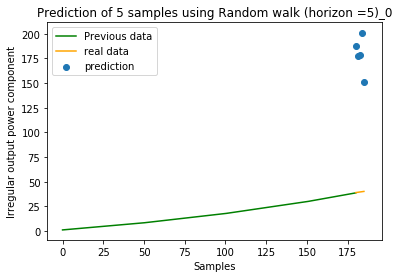

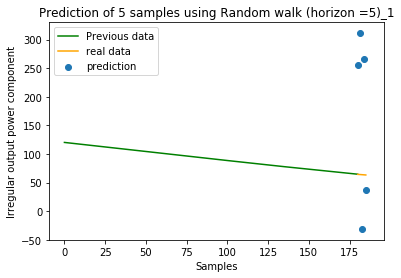

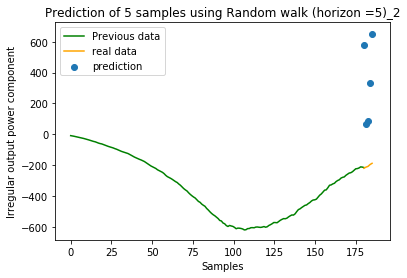

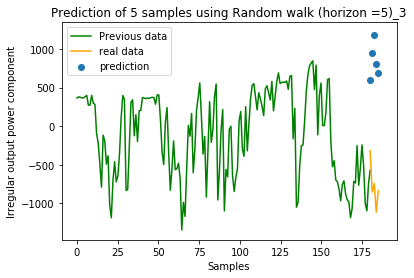

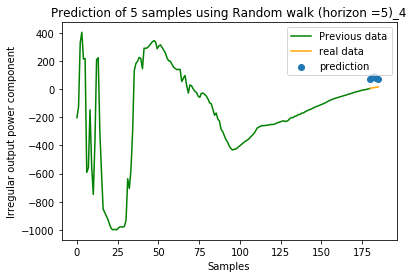

...

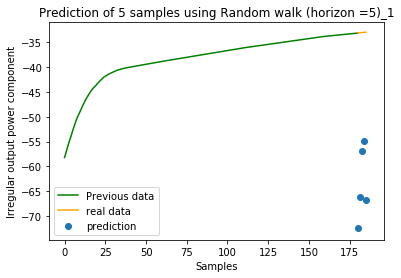

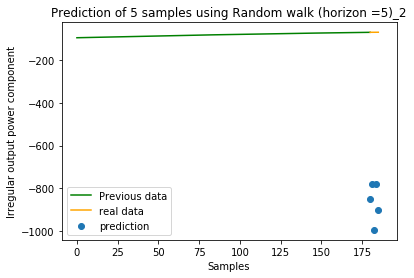

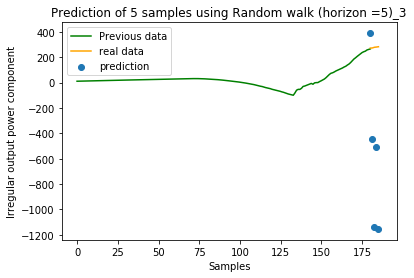

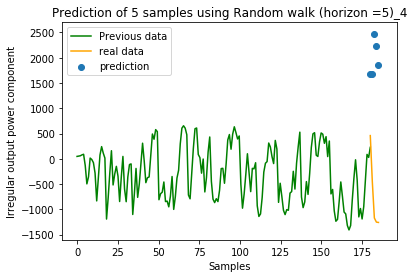

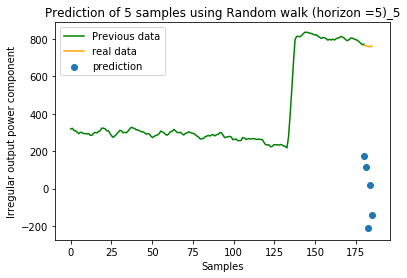

In [17]:
results = []
horizon = 5
allErrors = []

# Backtest on 10 divisions of the data
i = 0
for h_set in data.values():
    for values in h_set:
        print("H Value: " + str(i) + " / " + str(60))
        i += 1
        
        for i, (X_train, X_test) in enumerate(split(values, splits = 50, offset = len(data) // 2)):
            print("\r\nSplit ", i)
            print("training size:", len(X_train))

            Y_train = X_train
            Y_test  = X_test

            # Train the model
            model.fit(X_train, Y_train)

            # make a prediction
            print(type(X_test[:]))
            Y_pred = model.predict(X_test[:])
            print(Y_pred)

            # Save the data 
            results.append((Y_pred, X_train, Y_train, X_test, Y_test))

            # Save the error
            errors = calc_error(Y_pred, Y_test[:horizon], Y_train, str(model) + '_' + str(i))

            # Report the error
            report_error(errors)

            # Generate a graph
#             plot_prediction(Y_pred, Y_test[:horizon], Y_train, str(model) + '_' + str(i), '')

            # Save the information
            allErrors.append(errors)

In [21]:
errors.keys()

dict_keys(['sMAPE', 'MAE', 'MAPE', 'RMSE', 'MASE', 'MASE1', 'MASE2'])

In [31]:
len(allErrors)

1705

In [35]:
d = b'\x80\x03]q\x00(]q\x01(G?\xedWS$\x11/\xfcG?\xf50\xc9\x02\x00.XG?\xedA\x927\x1e\x9bvG?\xed;t\xa6\x8a\xea\x87G?\xe4\xfex\xef\xc1*\xf1G?\xfb\x9a\xef\x0c\x08@JG?\xfa\xe5\xb6m\x8f\x08\xeee]q\x02(G?\xecD\xb6\xa8\xe5\x13VG?\xf3\xf3c\x99\x0c*\xb5G?\xec\xe7\xce\xff\xfa\xfc\x94G?\xechKP\x8c=\xaaG?\xe4\xaex\xb5\xb5\xec`G?\xfb$\xf8U\xb7\xd6\xb6G?\xfaMV\x1bq\x93Xe]q\x03(G?\xecYk\xeb\xe2b\xefG?\xf3\xa0\xf6\\\xca\xe7\x90G?\xec\xc5\xc5%\xc6\x9a\xbcG?\xec\xb1H\xc0\xf4b9G?\xe5LPa\xcf\xb7\x0fG?\xfao\xb6)\xb5j\xbdG?\xf7\xfdr\xf8\x95\xf9\x84e]q\x04(G?\xec\xf1rY\xe7\x0e\xc5G?\xf4|\xb1\x87\xf2"\x13G?\xec\xfaI\x168\xaa\xc6G?\xed\x00\xc8\xfbf3;G?\xe5\x86(nqc\x07G?\xfa\x83\xaf\xf6\x1b\x19\xb4G?\xf9\x86\xa7\xe9y\x89\x86e]q\x05(G?\xeb\xe5<\xa7dH\xbaG?\xf2zJ\x84\xf8\x06\xb1G?\xecB\xcec\x96\xd8\x9eG?\xecU\xc7\xe31\xdf\xccG?\xe4A\xdb\x8b\xdf\x99\xa2G?\xf95/\xd3\x0c\xf6\xf2G?\xf7`\xa2\xb0\xa6\x15\x84e]q\x06(G?\xec\xff\xa5\x9c\x81j^G?\xf4\x94Te&\xb8\xbdG?\xec\xe7\x9a\xdf\xcc\xd3\x1aG?\xec\xef8\xf7\xf3-\x11G?\xe5q\x8d\xbcQ\xdcJG?\xfb\x85\xc4X\x0f\xd8\x9fG?\xfay)\x94IP\x08e]q\x07(G?\xec\xa4\xf5\\z\x8b\xaaG?\xf4\xa5\xc8\xa6\xca\x1d\xf9G?\xec\xc1\x8a\xf44\xf3\x9cG?\xec]\x195\xac\xe5\xe8G?\xe57\xaf\xd6\x9b\x05\'G?\xfbx\'\xd3N,\x1aG?\xfa[\xcd\x1a\xaboMe]q\x08(G?\xed\x10\xb2\x84r\x14&G?\xf5\x07/4\xf8"\xe6G?\xed<\xf7\xd8\xbd\x13\xe4G?\xed\x0e\xb5y\x86NgG?\xe6\x14T>\x01d\xefG?\xfa\xb1\xec\xa0\x01\xd6\xd7G?\xf9\xed\xcb\x1b\x84\x16\xd8e]q\t(G?\xec<>\xe6>>\xf3G?\xf3^\xeb\x05\xdb\xe6eG?\xec\x81e\xa8\xfd\xa4\x80G?\xec{&L,5\x8aG?\xe5q\xbaJ\xf2D\xf5G?\xfa\xba\xac\x11F\x01\xfeG?\xf9\xda&k\xde\xabbe]q\n(G?\xecw\xcb\xac\xc3P\x9aG?\xf3\xbdT\x8d\xdd]-G?\xec\xae\x03X\\:VG?\xec\x96\xe0\xe7!v\xaaG?\xe5\x18w%\x93\xb6\xb0G?\xfa\'\xb82\x1e\x92\x1bG?\xf9\x88\x07{\xb9\x10\xb1e]q\x0b(G?\xec\x83\x06\xf0\xd3b\x92G?\xf3Cb\xcd\x0b)\x92G?\xecz\x18\x92X\x93>G?\xec\x9e\xb0p\xee\x8aKG?\xe59q\x1b\xcd\xa1\x84G?\xfa\x8a\xbcDk\n\xdfG?\xf8\x8aE\xec\x87%\xc8e]q\x0c(G?\xec\xc7\xf1\xd8i\x87\x86G?\xf4\xa0\xe4\x80\xb5\xc8#G?\xec\xb1\xaa\xc3\xa8\xdc\xbaG?\xectT\xff/\x88HG?\xe4\xad\xe1PS\xa2IG?\xfcN\xceAMH\xddG?\xfb\x06/|\x19\x08\xb5e]q\r(G?\xec\x05I\xe1\x081uG?\xf3\xf6D\x9e\x7fK\xf0G?\xecs\x9e\xeeE\xaf\nG?\xec\x1f\xe7d\xc3(\xbeG?\xe4\xad\x1c9\xf6\xbf\x16G?\xfb\xf0)\xa1:\x89\xddG?\xfb\x12I)\xc5P8e]q\x0e(G?\xed\x86e\xbd7X\xd7G?\xf5?G\x1ffV\xb8G?\xed`V\x11Q\xf96G?\xed^\xe2_Q\x9eTG?\xe6D\xbf\xf0m\xb0\xc1G?\xfc,\x8c\r\xef\x1c5G?\xfa\xa9\xe2a\xc8\x13Se]q\x0f(G?\xec\xc4\xeb\xd2\xd0\x96\xddG?\xf3\xdb\x830\x04\x02\x9cG?\xec\xde_-P\xe1$G?\xec\xdfFLd\xe6CG?\xe5\xad\x0f\xffc\xccMG?\xfa\x1f\xf4]\xe6X\xd6G?\xf9\xe9\x13$\xdf\xc4Mee.'

In [46]:
HValues = pickle.loads(d)

In [51]:
HAvg

[0.9148906082717945,
 0.8914720176551856,
 0.8938995715322249,
 0.905457245510782,
 0.8801197895009062,
 0.9045603202379816,
 0.893375639096473,
 0.9100087227354686,
 0.8877275557608849,
 0.8930943684366411,
 0.8917566861358268,
 0.895098623669095,
 0.881217988870136,
 0.9194994257485062,
 0.9011461415172094]

Text(0.5,1,'H vs RMSE')

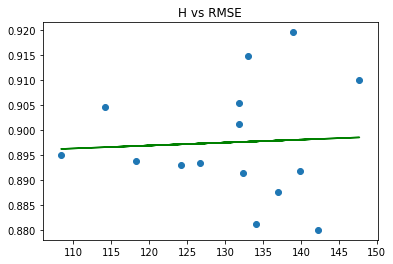

In [75]:
r = []
for j in range(0, 15):
    i1, i2 = (j) * 50, (j + 1) * 50

    r.append(np.mean( [e['sMAPE'] for e in allErrors[i1 : i2]] ))

fit = np.polyfit(r,HAvg,1)
fit_fn = np.poly1d(fit) 
# fit_fn is now a function which takes in x and returns an estimate for y

plt.plot(r, fit_fn(r), 'g')
plt.scatter(r, HAvg)
    
# plt.scatter(r, HAvg)
plt.title('H vs RMSE')

In [68]:
fit

array([1.17663581e-05, 8.90467527e-01])

In [71]:
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(r, HAvg)

In [72]:
r_value

0.09838373533536043

In [70]:
import scipy

### Depreciated Run the calculations 

647279 647926
647926 648573
648573 649220
649220 649868
649868 650515
650515 651162
651162 651809
651809 652457
652457 653104
653104 653751
653751 654399
654399 655046
655046 655693
655693 656340
656340 656988
656988 657635
657635 658282
658282 658930
658930 659577
659577 660224
660224 660871
660871 661519
661519 662166
662166 662813
662813 663461
663461 664108
664108 664755
664755 665402
665402 666050
666050 666697
666697 667344
667344 667991
667991 668639
668639 669286
669286 669933
669933 670581
670581 671228
671228 671875
671875 672522
672522 673170
673170 673817
673817 674464
674464 675112
675112 675759
675759 676406
676406 677053
677053 677701
677701 678348
678348 678995
678995 679643
679643 680290
680290 680937
680937 681584
681584 682232
682232 682879
682879 683526
683526 684173
684173 684821
684821 685468
685468 686115
686115 686763
686763 687410
687410 688057
688057 688704
688704 689352
689352 689999
689999 690646
690646 691294
691294 691941
691941 692588
692588 693235
693235

1101022 1101669
1101669 1102316
1102316 1102964
1102964 1103611
1103611 1104258
1104258 1104905
1104905 1105553
1105553 1106200
1106200 1106847
1106847 1107495
1107495 1108142
1108142 1108789
1108789 1109436
1109436 1110084
1110084 1110731
1110731 1111378
1111378 1112026
1112026 1112673
1112673 1113320
1113320 1113967
1113967 1114615
1114615 1115262
1115262 1115909
1115909 1116557
1116557 1117204
1117204 1117851
1117851 1118498
1118498 1119146
1119146 1119793
1119793 1120440
1120440 1121087
1121087 1121735
1121735 1122382
1122382 1123029
1123029 1123677
1123677 1124324
1124324 1124971
1124971 1125618
1125618 1126266
1126266 1126913
1126913 1127560
1127560 1128208
1128208 1128855
1128855 1129502
1129502 1130149
1130149 1130797
1130797 1131444
1131444 1132091
1132091 1132739
1132739 1133386
1133386 1134033
1134033 1134680
1134680 1135328
1135328 1135975
1135975 1136622
1136622 1137269
1137269 1137917
1137917 1138564
1138564 1139211
1139211 1139859
1139859 1140506
1140506 1141153
1141153 

c:\program files\python36\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in double_scalars



Split  1
training size: 517
<class 'numpy.ndarray'>
[481.12169003 492.4298436  480.951434   481.47001901 497.99014753]
actual [[456.98]
 [460.03]
 [459.64]
 [465.05]
 [464.77]]
Prediction [-258.65099265 -258.65099265 -258.65099265 -258.65099265 -258.65099265]
actual [[456.98]
 [460.03]
 [459.64]
 [465.05]
 [464.77]]
Prediction [481.12169003 492.4298436  480.951434   481.47001901 497.99014753]

Errors:
sMAPE           5.37048
MAE             25.49863
MAPE            5.52817
RMSE            26.30568
MASE            0.03542
MASE1           -0.09858
MASE2           inf

Split  2
training size: 517
<class 'numpy.ndarray'>
[-266.98619477 -271.88422924 -194.35703721 -201.90542223 -210.63628959]
actual [[-360.76]
 [-358.12]
 [-355.82]
 [-353.35]
 [-351.35]]
Prediction [324.85724739 324.85724739 324.85724739 324.85724739 324.85724739]
actual [[-360.76]
 [-358.12]
 [-355.82]
 [-353.35]
 [-351.35]]
Prediction [-266.98619477 -271.88422924 -194.35703721 -201.90542223 -210.63628959]

Errors:
sMAPE 


Split  15
training size: 517
<class 'numpy.ndarray'>
[207.87857196 139.72425191 179.16141645 225.90538846 225.23491121]
actual [[486.88]
 [486.03]
 [494.45]
 [502.28]
 [503.94]]
Prediction [469.36396344 469.36396344 469.36396344 469.36396344 469.36396344]
actual [[486.88]
 [486.03]
 [494.45]
 [502.28]
 [503.94]]
Prediction [207.87857196 139.72425191 179.16141645 225.90538846 225.23491121]

Errors:
sMAPE           87.3927
MAE             299.13509
MAPE            60.53012
RMSE            300.41165
MASE            11.79925
MASE1           0.63732
MASE2           inf

Split  16
training size: 517
<class 'numpy.ndarray'>
[-376.5062322  -383.32623581 -380.47989868 -385.52890159 -388.20025023]
actual [[-361.41]
 [-361.55]
 [-361.69]
 [-361.83]
 [-361.97]]
Prediction [-352.59327238 -352.59327238 -352.59327238 -352.59327238 -352.59327238]
actual [[-361.41]
 [-361.55]
 [-361.69]
 [-361.83]
 [-361.97]]
Prediction [-376.5062322  -383.32623581 -380.47989868 -385.52890159 -388.20025023]

Errors:
s

c:\program files\python36\lib\site-packages\matplotlib\pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)



Split  21
training size: 518
<class 'numpy.ndarray'>
[-1138.5700778  -1313.93323344 -1253.6511729   -935.06287903
  -281.75891985]
actual [[111.29 ]
 [ 91.629]
 [ 75.74 ]
 [ 73.84 ]
 [ 88.901]]
Prediction [290.7125278 290.7125278 290.7125278 290.7125278 290.7125278]
actual [[111.29 ]
 [ 91.629]
 [ 75.74 ]
 [ 73.84 ]
 [ 88.901]]
Prediction [-1138.5700778  -1313.93323344 -1253.6511729   -935.06287903
  -281.75891985]

Errors:
sMAPE           200.0
MAE             1072.87526
MAPE            1239.10251
RMSE            1136.68906
MASE            5.29992
MASE1           3.6905
MASE2           inf

Split  22
training size: 517
<class 'numpy.ndarray'>
[411.35649355 357.63829503 349.01651436 329.68769524 369.21725098]
actual [[437.33]
 [439.76]
 [441.87]
 [445.07]
 [446.83]]
Prediction [-666.05616383 -666.05616383 -666.05616383 -666.05616383 -666.05616383]
actual [[437.33]
 [439.76]
 [441.87]
 [445.07]
 [446.83]]
Prediction [411.35649355 357.63829503 349.01651436 329.68769524 369.21725098]

Er


Split  36
training size: 517
<class 'numpy.ndarray'>
[-48.84250662 -61.72526373 -53.564867   -39.83469568 -35.23896172]
actual [[-1.4214]
 [-1.6776]
 [-2.0253]
 [-2.373 ]
 [-2.7207]]
Prediction [-51.8718532 -51.8718532 -51.8718532 -51.8718532 -51.8718532]
actual [[-1.4214]
 [-1.6776]
 [-2.0253]
 [-2.373 ]
 [-2.7207]]
Prediction [-48.84250662 -61.72526373 -53.564867   -39.83469568 -35.23896172]

Errors:
sMAPE           182.4747
MAE             45.79766
MAPE            2446.85438
RMSE            46.84363
MASE            0.91911
MASE1           -0.8829
MASE2           inf

Split  37
training size: 517
<class 'numpy.ndarray'>
[667.49207195 638.76190183 631.05086887 623.08199702 606.55732539]
actual [[678.61]
 [677.85]
 [687.98]
 [701.91]
 [705.1 ]]
Prediction [-151.55045261 -151.55045261 -151.55045261 -151.55045261 -151.55045261]
actual [[678.61]
 [677.85]
 [687.98]
 [701.91]
 [705.1 ]]
Prediction [667.49207195 638.76190183 631.05086887 623.08199702 606.55732539]

Errors:
sMAPE           


Split  50
training size: 517
<class 'numpy.ndarray'>
[596.07401993 620.93977776 618.10625125 621.29312469 623.94732065]
actual [[581.59]
 [580.18]
 [574.25]
 [567.74]
 [569.84]]
Prediction [-124.41520619 -124.41520619 -124.41520619 -124.41520619 -124.41520619]
actual [[581.59]
 [580.18]
 [574.25]
 [567.74]
 [569.84]]
Prediction [596.07401993 620.93977776 618.10625125 621.29312469 623.94732065]

Errors:
sMAPE           6.93513
MAE             41.3521
MAPE            7.21616
RMSE            43.79511
MASE            0.05915
MASE1           -0.33237
MASE2           inf

Split  51
training size: 517
<class 'numpy.ndarray'>
[-308.65969916 -308.67869052 -325.9013838  -319.88704046 -339.04779473]
actual [[-358.89]
 [-358.41]
 [-357.94]
 [-357.48]
 [-357.03]]
Prediction [208.07451489 208.07451489 208.07451489 208.07451489 208.07451489]
actual [[-358.89]
 [-358.41]
 [-357.94]
 [-357.48]
 [-357.03]]
Prediction [-308.65969916 -308.67869052 -325.9013838  -319.88704046 -339.04779473]

Errors:
sMAPE


Split  64
training size: 518
<class 'numpy.ndarray'>
[ -128.48960267  -307.63228136  -846.06909003 -1184.32834227
 -1062.53451465]
actual [[121.58 ]
 [ 63.247]
 [190.4  ]
 [111.16 ]
 [-40.801]]
Prediction [-14.67431641 -14.67431641 -14.67431641 -14.67431641 -14.67431641]
actual [[121.58 ]
 [ 63.247]
 [190.4  ]
 [111.16 ]
 [-40.801]]
Prediction [ -128.48960267  -307.63228136  -846.06909003 -1184.32834227
 -1062.53451465]

Errors:
sMAPE           197.04163
MAE             794.92797
MAPE            1001.21191
RMSE            894.04517
MASE            6.95827
MASE1           -54.17138
MASE2           inf

Split  65
training size: 517
<class 'numpy.ndarray'>
[-374.77066698 -423.884295   -413.33541589 -423.19051596 -449.42560365]
actual [[-291.79]
 [-292.56]
 [-293.33]
 [-294.11]
 [-294.88]]
Prediction [-117.23089599 -117.23089599 -117.23089599 -117.23089599 -117.23089599]
actual [[-291.79]
 [-292.56]
 [-293.33]
 [-294.11]
 [-294.88]]
Prediction [-374.77066698 -423.884295   -413.33541589 -4


Split  78
training size: 518
<class 'numpy.ndarray'>
[190.9698689  185.94725536 194.52660461 115.55535194 113.32904948]
actual [[-17.74 ]
 [-16.593]
 [-15.446]
 [-14.299]
 [-13.152]]
Prediction [43.00546351 43.00546351 43.00546351 43.00546351 43.00546351]
actual [[-17.74 ]
 [-16.593]
 [-15.446]
 [-14.299]
 [-13.152]]
Prediction [190.9698689  185.94725536 194.52660461 115.55535194 113.32904948]

Errors:
sMAPE           200.0
MAE             175.51163
MAPE            1125.27009
RMSE            179.73896
MASE            3.00269
MASE1           4.08115
MASE2           inf

Split  79
training size: 517
<class 'numpy.ndarray'>
[-729.48044495 -663.02257909 -526.7095591   -15.1500483   102.76167867]
actual [[-1197. ]
 [-1198.6]
 [-1205.7]
 [-1210.4]
 [-1197.8]]
Prediction [32.04386054 32.04386054 32.04386054 32.04386054 32.04386054]
actual [[-1197. ]
 [-1198.6]
 [-1205.7]
 [-1210.4]
 [-1197.8]]
Prediction [-729.48044495 -663.02257909 -526.7095591   -15.1500483   102.76167867]

Errors:
sMAPE  


Split  92
training size: 518
<class 'numpy.ndarray'>
[222.78680612 318.28662657 326.88182476 494.40211922 446.17961105]
actual [[-279.76]
 [-279.9 ]
 [-280.21]
 [-281.03]
 [-281.69]]
Prediction [-290.71938224 -290.71938224 -290.71938224 -290.71938224 -290.71938224]
actual [[-279.76]
 [-279.9 ]
 [-280.21]
 [-281.03]
 [-281.69]]
Prediction [222.78680612 318.28662657 326.88182476 494.40211922 446.17961105]

Errors:
sMAPE           200.0
MAE             642.2254
MAPE            228.86485
RMSE            649.61991
MASE            62.95474
MASE1           -2.20909
MASE2           inf

Split  93
training size: 517
<class 'numpy.ndarray'>
[-578.49106259 -704.62061995 -772.07902932 -571.54140139 -778.77563696]
actual [[283.16]
 [291.58]
 [283.87]
 [284.61]
 [299.45]]
Prediction [303.77124468 303.77124468 303.77124468 303.77124468 303.77124468]
actual [[283.16]
 [291.58]
 [283.87]
 [284.61]
 [299.45]]
Prediction [-578.49106259 -704.62061995 -772.07902932 -571.54140139 -778.77563696]

Errors:
sM


Split  107
training size: 518
<class 'numpy.ndarray'>
[-402.93555992 -420.37616769 -410.71173483 -434.0445284  -437.49062939]
actual [[-314.14]
 [-314.66]
 [-315.18]
 [-315.71]
 [-316.23]]
Prediction [30.43181815 30.43181815 30.43181815 30.43181815 30.43181815]
actual [[-314.14]
 [-314.66]
 [-315.18]
 [-315.71]
 [-316.23]]
Prediction [-402.93555992 -420.37616769 -410.71173483 -434.0445284  -437.49062939]

Errors:
sMAPE           28.71897
MAE             105.92772
MAPE            33.60023
RMSE            106.67153
MASE            0.30649
MASE1           3.48082
MASE2           inf

Split  108
training size: 517
<class 'numpy.ndarray'>
[539.1304794  520.30469454 555.66138941 556.78708762 535.04176974]
actual [[591.83]
 [600.52]
 [601.75]
 [595.78]
 [600.58]]
Prediction [41.68035648 41.68035648 41.68035648 41.68035648 41.68035648]
actual [[591.83]
 [600.52]
 [601.75]
 [595.78]
 [600.58]]
Prediction [539.1304794  520.30469454 555.66138941 556.78708762 535.04176974]

Errors:
sMAPE         


Split  121
training size: 518
<class 'numpy.ndarray'>
[ 982.50794339  575.81263558 1118.04142639  729.30609048  999.5923979 ]
actual [[357.26]
 [377.8 ]
 [394.12]
 [404.58]
 [413.19]]
Prediction [-231.33450753 -231.33450753 -231.33450753 -231.33450753 -231.33450753]
actual [[357.26]
 [377.8 ]
 [394.12]
 [404.58]
 [413.19]]
Prediction [ 982.50794339  575.81263558 1118.04142639  729.30609048  999.5923979 ]

Errors:
sMAPE           74.18056
MAE             491.6621
MAPE            126.65756
RMSE            529.81526
MASE            0.79208
MASE1           -2.12533
MASE2           inf

Split  122
training size: 517
<class 'numpy.ndarray'>
[-229.49338804 -225.29753232  207.91294801  369.81350518  380.06146081]
actual [[416.43]
 [414.62]
 [413.5 ]
 [412.41]
 [411.64]]
Prediction [299.15687427 299.15687427 299.15687427 299.15687427 299.15687427]
actual [[416.43]
 [414.62]
 [413.5 ]
 [412.41]
 [411.64]]
Prediction [-229.49338804 -225.29753232  207.91294801  369.81350518  380.06146081]

Errors


Split  136
training size: 517
<class 'numpy.ndarray'>
[-107.09266509 -110.79288855 -110.44136461 -109.81965072 -115.28131637]
actual [[-120.2 ]
 [-120.12]
 [-120.04]
 [-119.97]
 [-119.89]]
Prediction [-93.43733482 -93.43733482 -93.43733482 -93.43733482 -93.43733482]
actual [[-120.2 ]
 [-120.12]
 [-120.04]
 [-119.97]
 [-119.89]]
Prediction [-107.09266509 -110.79288855 -110.44136461 -109.81965072 -115.28131637]

Errors:
sMAPE           8.139
MAE             9.35842
MAPE            7.79409
RMSE            9.74885
MASE            0.35173
MASE1           -0.10016
MASE2           inf

Split  137
training size: 517
<class 'numpy.ndarray'>
[233.3837114  223.00845472 238.24629477 242.31777493 241.31608788]
actual [[244.53]
 [252.06]
 [251.06]
 [246.25]
 [236.56]]
Prediction [149.38352805 149.38352805 149.38352805 149.38352805 149.38352805]
actual [[244.53]
 [252.06]
 [251.06]
 [246.25]
 [236.56]]
Prediction [233.3837114  223.00845472 238.24629477 242.31777493 241.31608788]

Errors:
sMAPE      


Split  151
training size: 517
<class 'numpy.ndarray'>
[236.52995592 228.99276849 283.15652143 286.19658552 243.63810599]
actual [[116.5 ]
 [119.3 ]
 [122.23]
 [129.64]
 [134.36]]
Prediction [-250.43255315 -250.43255315 -250.43255315 -250.43255315 -250.43255315]
actual [[116.5 ]
 [119.3 ]
 [122.23]
 [129.64]
 [134.36]]
Prediction [236.52995592 228.99276849 283.15652143 286.19658552 243.63810599]

Errors:
sMAPE           68.69988
MAE             131.29679
MAPE            105.74613
RMSE            133.25818
MASE            0.35028
MASE1           -0.52428
MASE2           inf

Split  152
training size: 517
<class 'numpy.ndarray'>
[298.5207808  279.52675386 301.76292921 320.86849159 328.49686105]
actual [[398.84]
 [399.06]
 [399.29]
 [399.51]
 [399.74]]
Prediction [319.23624758 319.23624758 319.23624758 319.23624758 319.23624758]
actual [[398.84]
 [399.06]
 [399.29]
 [399.51]
 [399.74]]
Prediction [298.5207808  279.52675386 301.76292921 320.86849159 328.49686105]

Errors:
sMAPE           2


Split  166
training size: 517
<class 'numpy.ndarray'>
[85.98297509 73.66312263 96.88117201 81.34976388 66.54484718]
actual [[95.916]
 [84.983]
 [72.369]
 [68.905]
 [82.144]]
Prediction [82.81169826 82.81169826 82.81169826 82.81169826 82.81169826]
actual [[95.916]
 [84.983]
 [72.369]
 [68.905]
 [82.144]]
Prediction [85.98297509 73.66312263 96.88117201 81.34976388 66.54484718]

Errors:
sMAPE           18.34097
MAE             14.7618
MAPE            18.9196
RMSE            15.65795
MASE            1.41798
MASE1           0.17826
MASE2           inf

Split  167
training size: 518
<class 'numpy.ndarray'>
[-32.32858799 -14.78278653   2.29720825  -9.17440653   9.19699679]
actual [[-84.583]
 [-84.32 ]
 [-84.057]
 [-83.794]
 [-83.531]]
Prediction [-8.68431602 -8.68431602 -8.68431602 -8.68431602 -8.68431602]
actual [[-84.583]
 [-84.32 ]
 [-84.057]
 [-83.794]
 [-83.531]]
Prediction [-32.32858799 -14.78278653   2.29720825  -9.17440653   9.19699679]

Errors:
sMAPE           158.05033
MAE         


Split  181
training size: 517
<class 'numpy.ndarray'>
[461.46342431 253.62654817 220.81246176 447.81290833 293.93839109]
actual [[-65.407]
 [-66.349]
 [-40.815]
 [ 19.003]
 [ 26.481]]
Prediction [-100.47852611 -100.47852611 -100.47852611 -100.47852611 -100.47852611]
actual [[-65.407]
 [-66.349]
 [-40.815]
 [ 19.003]
 [ 26.481]]
Prediction [461.46342431 253.62654817 220.81246176 447.81290833 293.93839109]

Errors:
sMAPE           190.1318
MAE             360.94815
MAPE            1039.06615
RMSE            375.18985
MASE            4.80872
MASE1           -3.59229
MASE2           inf

Split  182
training size: 518
<class 'numpy.ndarray'>
[ -48.53991108  -95.86710401 -101.63363093 -154.61781299 -135.46787031]
actual [[-390.86]
 [-345.25]
 [-309.3 ]
 [-295.38]
 [-292.54]]
Prediction [-57.90879189 -57.90879189 -57.90879189 -57.90879189 -57.90879189]
actual [[-390.86]
 [-345.25]
 [-309.3 ]
 [-295.38]
 [-292.54]]
Prediction [ -48.53991108  -95.86710401 -101.63363093 -154.61781299 -135.46787


Split  195
training size: 517
<class 'numpy.ndarray'>
[ 363.60404767  669.0964756   963.21247061 1253.752457   1328.78144161]
actual [[234.52]
 [259.24]
 [252.3 ]
 [255.67]
 [265.15]]
Prediction [-49.62800774 -49.62800774 -49.62800774 -49.62800774 -49.62800774]
actual [[234.52]
 [259.24]
 [252.3 ]
 [255.67]
 [265.15]]
Prediction [ 363.60404767  669.0964756   963.21247061 1253.752457   1328.78144161]

Errors:
sMAPE           102.82849
MAE             662.31338
MAPE            257.28724
RMSE            750.6693
MASE            2.18582
MASE1           -13.34556
MASE2           inf

Split  196
training size: 518
<class 'numpy.ndarray'>
[-146.84107991 -151.64243918 -152.02467523 -151.28592117 -147.22460459]
actual [[-137.23]
 [-137.29]
 [-137.35]
 [-137.41]
 [-137.47]]
Prediction [71.76559855 71.76559855 71.76559855 71.76559855 71.76559855]
actual [[-137.23]
 [-137.29]
 [-137.35]
 [-137.41]
 [-137.47]]
Prediction [-146.84107991 -151.64243918 -152.02467523 -151.28592117 -147.22460459]

Erro


Split  210
training size: 518
<class 'numpy.ndarray'>
[115.4129202  433.76719726 464.40485232 312.4141607  775.19678223]
actual [[224.52]
 [240.19]
 [267.05]
 [284.44]
 [288.52]]
Prediction [81.98713514 81.98713514 81.98713514 81.98713514 81.98713514]
actual [[224.52]
 [240.19]
 [267.05]
 [284.44]
 [288.52]]
Prediction [115.4129202  433.76719726 464.40485232 312.4141607  775.19678223]

Errors:
sMAPE           55.29587
MAE             202.93801
MAPE            76.32123
RMSE            255.32813
MASE            1.21542
MASE1           2.47524
MASE2           inf

Split  211
training size: 517
<class 'numpy.ndarray'>
[ 39.085752    54.24981776  29.8651683  -86.23371327  77.88213676]
actual [[-121.77 ]
 [-111.95 ]
 [ -96.3  ]
 [ -79.628]
 [ -69.04 ]]
Prediction [-352.33574236 -352.33574236 -352.33574236 -352.33574236 -352.33574236]
actual [[-121.77 ]
 [-111.95 ]
 [ -96.3  ]
 [ -79.628]
 [ -69.04 ]]
Prediction [ 39.085752    54.24981776  29.8651683  -86.23371327  77.88213676]

Errors:
sMAP


Split  224
training size: 518
<class 'numpy.ndarray'>
[669.95314565 639.88281048 650.42096011 638.23521416 680.31969821]
actual [[586.17]
 [572.  ]
 [578.64]
 [580.07]
 [603.15]]
Prediction [-6.78182568 -6.78182568 -6.78182568 -6.78182568 -6.78182568]
actual [[586.17]
 [572.  ]
 [578.64]
 [580.07]
 [603.15]]
Prediction [669.95314565 639.88281048 650.42096011 638.23521416 680.31969821]

Errors:
sMAPE           11.55943
MAE             71.75637
MAPE            12.27756
RMSE            72.27524
MASE            0.12146
MASE1           -10.58069
MASE2           inf

Split  225
training size: 517
<class 'numpy.ndarray'>
[-187.87506772 -185.19218729 -185.22619253 -180.22928314 -178.81157344]
actual [[-199.79]
 [-199.63]
 [-199.47]
 [-199.31]
 [-199.16]]
Prediction [24.90451648 24.90451648 24.90451648 24.90451648 24.90451648]
actual [[-199.79]
 [-199.63]
 [-199.47]
 [-199.31]
 [-199.16]]
Prediction [-187.87506772 -185.19218729 -185.22619253 -180.22928314 -178.81157344]

Errors:
sMAPE         


Split  238
training size: 517
<class 'numpy.ndarray'>
[-246.76610062 -247.29856188 -244.32038071 -242.7087032  -238.46767525]
actual [[-229.41]
 [-229.5 ]
 [-229.6 ]
 [-229.69]
 [-229.79]]
Prediction [224.43054103 224.43054103 224.43054103 224.43054103 224.43054103]
actual [[-229.41]
 [-229.5 ]
 [-229.6 ]
 [-229.69]
 [-229.79]]
Prediction [-246.76610062 -247.29856188 -244.32038071 -242.7087032  -238.46767525]

Errors:
sMAPE           6.03719
MAE             14.31428
MAPE            6.2353
RMSE            14.69354
MASE            0.03153
MASE1           0.06378
MASE2           inf

Split  239
training size: 518
<class 'numpy.ndarray'>
[ 652.2950337    64.62233244   83.88547198   81.078461   -226.86592727]
actual [[648.32]
 [617.48]
 [578.86]
 [543.83]
 [524.42]]
Prediction [-228.46734691 -228.46734691 -228.46734691 -228.46734691 -228.46734691]
actual [[648.32]
 [617.48]
 [578.86]
 [543.83]
 [524.42]]
Prediction [ 652.2950337    64.62233244   83.88547198   81.078461   -226.86592727]

Er


Split  253
training size: 518
<class 'numpy.ndarray'>
[847.52163854 550.41247207 -30.49345047  17.96366282  77.61218698]
actual [[ 1023.1 ]
 [  492.89]
 [ -435.3 ]
 [-1116.6 ]
 [-1216.5 ]]
Prediction [-39.9612721 -39.9612721 -39.9612721 -39.9612721 -39.9612721]
actual [[ 1023.1 ]
 [  492.89]
 [ -435.3 ]
 [-1116.6 ]
 [-1216.5 ]]
Prediction [847.52163854 550.41247207 -30.49345047  17.96366282  77.61218698]

Errors:
sMAPE           120.72259
MAE             613.31665
MAPE            65.96309
RMSE            794.98
MASE            1.1172
MASE1           -15.34778
MASE2           inf

Split  254
training size: 517
<class 'numpy.ndarray'>
[-409.47772469 -420.12403905 -408.97735993 -422.56496558 -427.76357427]
actual [[-385.62]
 [-385.79]
 [-385.97]
 [-386.14]
 [-386.32]]
Prediction [-128.31170135 -128.31170135 -128.31170135 -128.31170135 -128.31170135]
actual [[-385.62]
 [-385.79]
 [-385.97]
 [-386.14]
 [-386.32]]
Prediction [-409.47772469 -420.12403905 -408.97735993 -422.56496558 -427.7635


Split  268
training size: 517
<class 'numpy.ndarray'>
[ 628.03152626  879.50443041 1585.38163514 2651.43889561 2366.86630198]
actual [[416.13]
 [343.28]
 [519.58]
 [747.98]
 [749.82]]
Prediction [-54.34059188 -54.34059188 -54.34059188 -54.34059188 -54.34059188]
actual [[416.13]
 [343.28]
 [519.58]
 [747.98]
 [749.82]]
Prediction [ 628.03152626  879.50443041 1585.38163514 2651.43889561 2366.86630198]

Errors:
sMAPE           89.06267
MAE             1066.88656
MAPE            176.47869
RMSE            1241.48029
MASE            1.78158
MASE1           -19.63333
MASE2           inf

Split  269
training size: 517
<class 'numpy.ndarray'>
[-166.6154288  -163.888439   -156.05552909 -151.83634992 -152.91001163]
actual [[-133.56]
 [-136.23]
 [-141.88]
 [-145.27]
 [-146.73]]
Prediction [119.43712398 119.43712398 119.43712398 119.43712398 119.43712398]
actual [[-133.56]
 [-136.23]
 [-141.88]
 [-145.27]
 [-146.73]]
Prediction [-166.6154288  -163.888439   -156.05552909 -151.83634992 -152.91001163


Split  282
training size: 518
<class 'numpy.ndarray'>
[539.85573136 909.26955882 978.58048953 961.42810453 868.03999635]
actual [[-670.32]
 [-621.8 ]
 [-616.68]
 [-596.29]
 [-633.48]]
Prediction [109.74848803 109.74848803 109.74848803 109.74848803 109.74848803]
actual [[-670.32]
 [-621.8 ]
 [-616.68]
 [-596.29]
 [-633.48]]
Prediction [539.85573136 909.26955882 978.58048953 961.42810453 868.03999635]

Errors:
sMAPE           200.0
MAE             1479.14878
MAPE            236.74327
RMSE            1485.57082
MASE            2.00573
MASE1           13.47762
MASE2           inf

Split  283
training size: 517
<class 'numpy.ndarray'>
[ 6.08226894 17.01761434 18.09439298 38.01976716 24.98615835]
actual [[-88.18 ]
 [-87.653]
 [-87.126]
 [-86.599]
 [-86.073]]
Prediction [-115.81459845 -115.81459845 -115.81459845 -115.81459845 -115.81459845]
actual [[-88.18 ]
 [-87.653]
 [-87.126]
 [-86.599]
 [-86.073]]
Prediction [ 6.08226894 17.01761434 18.09439298 38.01976716 24.98615835]

Errors:
sMAPE   


Split  296
training size: 518
<class 'numpy.ndarray'>
[-16.68891582 -23.95362243   5.0844389   10.61099167   1.58652879]
actual [[-46.191]
 [-45.871]
 [-45.551]
 [-45.231]
 [-44.912]]
Prediction [-97.81090985 -97.81090985 -97.81090985 -97.81090985 -97.81090985]
actual [[-46.191]
 [-45.871]
 [-45.551]
 [-45.231]
 [-44.912]]
Prediction [-16.68891582 -23.95362243   5.0844389   10.61099167   1.58652879]

Errors:
sMAPE           151.32293
MAE             40.87908
MAPE            89.96088
RMSE            42.88387
MASE            0.78223
MASE1           -0.41794
MASE2           inf

Split  297
training size: 517
<class 'numpy.ndarray'>
[ 789.28185087  366.2273475  -170.20854177 -136.90248815 -962.01249523]
actual [[-396.65]
 [-271.64]
 [ 116.62]
 [ 162.67]
 [ 279.61]]
Prediction [47.76391698 47.76391698 47.76391698 47.76391698 47.76391698]
actual [[-396.65]
 [-271.64]
 [ 116.62]
 [ 162.67]
 [ 279.61]]
Prediction [ 789.28185087  366.2273475  -170.20854177 -136.90248815 -962.01249523]

Errors:


Split  311
training size: 517
<class 'numpy.ndarray'>
[212.88661056 415.56147736 239.17413437 932.72907946 433.53968312]
actual [[-779.02]
 [-833.65]
 [-861.44]
 [-875.97]
 [-864.42]]
Prediction [91.0944325 91.0944325 91.0944325 91.0944325 91.0944325]
actual [[-779.02]
 [-833.65]
 [-861.44]
 [-875.97]
 [-864.42]]
Prediction [212.88661056 415.56147736 239.17413437 932.72907946 433.53968312]

Errors:
sMAPE           200.0
MAE             1289.6782
MAPE            152.31475
RMSE            1319.98873
MASE            1.38082
MASE1           14.1576
MASE2           inf

Split  312
training size: 517
<class 'numpy.ndarray'>
[79.66360524 73.99062102 71.69263355 76.16877725 72.77003834]
actual [[66.226]
 [66.408]
 [66.589]
 [66.722]
 [66.854]]
Prediction [0.6507995 0.6507995 0.6507995 0.6507995 0.6507995]
actual [[66.226]
 [66.408]
 [66.589]
 [66.722]
 [66.854]]
Prediction [79.66360524 73.99062102 71.69263355 76.16877725 72.77003834]

Errors:
sMAPE           11.66026
MAE             8.29734
M


Split  326
training size: 517
<class 'numpy.ndarray'>
[ 575.62474948  362.51343957  281.33221382 -258.06566333  -67.88936829]
actual [[508.63]
 [505.23]
 [507.96]
 [510.63]
 [510.57]]
Prediction [24.51167969 24.51167969 24.51167969 24.51167969 24.51167969]
actual [[508.63]
 [505.23]
 [507.96]
 [510.63]
 [510.57]]
Prediction [ 575.62474948  362.51343957  281.33221382 -258.06566333  -67.88936829]

Errors:
sMAPE           100.53541
MAE             356.69883
MAPE            69.97404
RMSE            447.59909
MASE            0.73686
MASE1           14.5522
MASE2           inf

Split  327
training size: 517
<class 'numpy.ndarray'>
[-106.12664156 -109.33846512 -111.4078906  -128.56705124 -130.11399394]
actual [[-132.91]
 [-132.74]
 [-132.58]
 [-132.42]
 [-132.26]]
Prediction [-20.97271528 -20.97271528 -20.97271528 -20.97271528 -20.97271528]
actual [[-132.91]
 [-132.74]
 [-132.58]
 [-132.42]
 [-132.26]]
Prediction [-106.12664156 -109.33846512 -111.4078906  -128.56705124 -130.11399394]

Errors


Split  340
training size: 517
<class 'numpy.ndarray'>
[-290.36193008  371.99644333  545.10077205  343.96996127   30.88050513]
actual [[625.52]
 [605.39]
 [607.85]
 [613.09]
 [618.  ]]
Prediction [315.3253294 315.3253294 315.3253294 315.3253294 315.3253294]
actual [[625.52]
 [605.39]
 [607.85]
 [613.09]
 [618.  ]]
Prediction [-290.36193008  371.99644333  545.10077205  343.96996127   30.88050513]

Errors:
sMAPE           99.16928
MAE             413.65285
MAPE            66.83877
RMSE            512.71525
MASE            1.3851
MASE1           1.31183
MASE2           inf

Split  341
training size: 517
<class 'numpy.ndarray'>
[-265.35158318 -258.77861875 -260.75153851 -255.8391447  -250.29581277]
actual [[-207.78]
 [-207.91]
 [-208.05]
 [-208.19]
 [-208.33]]
Prediction [-213.50464217 -213.50464217 -213.50464217 -213.50464217 -213.50464217]
actual [[-207.78]
 [-207.91]
 [-208.05]
 [-208.19]
 [-208.33]]
Prediction [-265.35158318 -258.77861875 -260.75153851 -255.8391447  -250.29581277]

Err


Split  354
training size: 517
<class 'numpy.ndarray'>
[218.79871378 215.81368561 176.46795744 158.71851676 144.65088045]
actual [[128.35]
 [129.09]
 [129.82]
 [130.55]
 [131.29]]
Prediction [136.91124211 136.91124211 136.91124211 136.91124211 136.91124211]
actual [[128.35]
 [129.09]
 [129.82]
 [130.55]
 [131.29]]
Prediction [218.79871378 215.81368561 176.46795744 158.71851676 144.65088045]

Errors:
sMAPE           32.40358
MAE             53.06995
MAPE            41.06748
RMSE            61.40029
MASE            7.48387
MASE1           0.38762
MASE2           inf

Split  355
training size: 517
<class 'numpy.ndarray'>
[-909.83850164 -833.02686814  -57.85353298   41.55515238 -119.02258144]
actual [[ -94.859]
 [-294.23 ]
 [-401.79 ]
 [-327.73 ]
 [-420.62 ]]
Prediction [-78.13953785 -78.13953785 -78.13953785 -78.13953785 -78.13953785]
actual [[ -94.859]
 [-294.23 ]
 [-401.79 ]
 [-327.73 ]
 [-420.62 ]]
Prediction [-909.83850164 -833.02686814  -57.85353298   41.55515238 -119.02258144]

Erro


Split  368
training size: 517
<class 'numpy.ndarray'>
[ 386.71979375  666.1013604   125.70921259 -565.3607512  -714.72572472]
actual [[130.98]
 [ 77.95]
 [ 74.7 ]
 [284.38]
 [351.95]]
Prediction [46.26482096 46.26482096 46.26482096 46.26482096 46.26482096]
actual [[130.98]
 [ 77.95]
 [ 74.7 ]
 [284.38]
 [351.95]]
Prediction [ 386.71979375  666.1013604   125.70921259 -565.3607512  -714.72572472]

Errors:
sMAPE           141.55957
MAE             562.26337
MAPE            323.98819
RMSE            674.35647
MASE            3.52973
MASE1           12.15315
MASE2           inf

Split  369
training size: 517
<class 'numpy.ndarray'>
[160.66654173 120.74899748  68.85783532 113.63732942  28.27723863]
actual [[48.753]
 [45.9  ]
 [35.504]
 [24.421]
 [23.711]]
Prediction [-313.99852337 -313.99852337 -313.99852337 -313.99852337 -313.99852337]
actual [[48.753]
 [45.9  ]
 [35.504]
 [24.421]
 [23.711]]
Prediction [160.66654173 120.74899748  68.85783532 113.63732942  28.27723863]

Errors:
sMAPE      


Split  383
training size: 517
<class 'numpy.ndarray'>
[-67.72263942 -66.30170108 -71.09517318 -82.66440077 -89.34354698]
actual [[-30.893]
 [-31.071]
 [-31.25 ]
 [-31.428]
 [-31.606]]
Prediction [-35.5705411 -35.5705411 -35.5705411 -35.5705411 -35.5705411]
actual [[-30.893]
 [-31.071]
 [-31.25 ]
 [-31.428]
 [-31.606]]
Prediction [-67.72263942 -66.30170108 -71.09517318 -82.66440077 -89.34354698]

Errors:
sMAPE           82.04192
MAE             44.17589
MAPE            141.1632
RMSE            45.04233
MASE            10.22367
MASE1           -1.24192
MASE2           inf

Split  384
training size: 517
<class 'numpy.ndarray'>
[663.06755103 830.96679906 950.39732771 902.46496721 934.66905963]
actual [[531.18]
 [531.06]
 [516.25]
 [507.02]
 [523.11]]
Prediction [-64.77798259 -64.77798259 -64.77798259 -64.77798259 -64.77798259]
actual [[531.18]
 [531.06]
 [516.25]
 [507.02]
 [523.11]]
Prediction [663.06755103 830.96679906 950.39732771 902.46496721 934.66905963]

Errors:
sMAPE           47.


Split  398
training size: 517
<class 'numpy.ndarray'>
[-24.39574408 -24.16546997 -26.6069278  -28.82155332 -24.69065551]
actual [[-41.146]
 [-39.742]
 [-38.177]
 [-37.072]
 [-35.771]]
Prediction [139.10955338 139.10955338 139.10955338 139.10955338 139.10955338]
actual [[-41.146]
 [-39.742]
 [-38.177]
 [-37.072]
 [-35.771]]
Prediction [-24.39574408 -24.16546997 -26.6069278  -28.82155332 -24.69065551]

Errors:
sMAPE           39.45471
MAE             12.64553
MAPE            32.68816
RMSE            13.02236
MASE            0.07125
MASE1           0.0909
MASE2           inf

Split  399
training size: 518
<class 'numpy.ndarray'>
[-285.47701534 -515.26761314 -254.25465438 -170.76930974  -86.76164093]
actual [[-88.221]
 [-88.394]
 [-88.567]
 [-88.739]
 [-88.912]]
Prediction [-52.45592664 -52.45592664 -52.45592664 -52.45592664 -52.45592664]
actual [[-88.221]
 [-88.394]
 [-88.567]
 [-88.739]
 [-88.912]]
Prediction [-285.47701534 -515.26761314 -254.25465438 -170.76930974  -86.76164093]

Error


Split  412
training size: 517
<class 'numpy.ndarray'>
[-103.33452088 -101.03253992 -100.45021444 -100.92094393 -101.83252639]
actual [[-106.79]
 [-106.75]
 [-106.7 ]
 [-106.65]
 [-106.6 ]]
Prediction [-147.76470406 -147.76470406 -147.76470406 -147.76470406 -147.76470406]
actual [[-106.79]
 [-106.75]
 [-106.7 ]
 [-106.65]
 [-106.6 ]]
Prediction [-103.33452088 -101.03253992 -100.45021444 -100.92094393 -101.83252639]

Errors:
sMAPE           4.98421
MAE             5.18385
MAPE            4.85864
RMSE            5.27713
MASE            0.12623
MASE1           -0.03508
MASE2           inf

Split  413
training size: 517
<class 'numpy.ndarray'>
[ 453.97553896 -146.85296324  -56.21854659  -70.0650639   374.52450491]
actual [[  122.37]
 [-1176.4 ]
 [ -526.22]
 [ -314.79]
 [ -558.8 ]]
Prediction [87.61601696 87.61601696 87.61601696 87.61601696 87.61601696]
actual [[  122.37]
 [-1176.4 ]
 [ -526.22]
 [ -314.79]
 [ -558.8 ]]
Prediction [ 453.97553896 -146.85296324  -56.21854659  -70.0650639   37


Split  426
training size: 517
<class 'numpy.ndarray'>
[-610.59402272 -803.34399536 -776.25223644 -765.01414594 -181.80177214]
actual [[664.22]
 [669.63]
 [673.8 ]
 [674.54]
 [683.2 ]]
Prediction [76.45520698 76.45520698 76.45520698 76.45520698 76.45520698]
actual [[664.22]
 [669.63]
 [673.8 ]
 [674.54]
 [683.2 ]]
Prediction [-610.59402272 -803.34399536 -776.25223644 -765.01414594 -181.80177214]

Errors:
sMAPE           200.0
MAE             1300.47923
MAPE            193.4246
RMSE            1320.45438
MASE            2.17973
MASE1           17.00969
MASE2           inf

Split  427
training size: 517
<class 'numpy.ndarray'>
[124.63925174 141.98781868 133.0676377  120.6635137  108.99803385]
actual [[158.14]
 [157.92]
 [157.69]
 [157.46]
 [157.24]]
Prediction [-291.53316557 -291.53316557 -291.53316557 -291.53316557 -291.53316557]
actual [[158.14]
 [157.92]
 [157.69]
 [157.46]
 [157.24]]
Prediction [124.63925174 141.98781868 133.0676377  120.6635137  108.99803385]

Errors:
sMAPE         


Split  440
training size: 517
<class 'numpy.ndarray'>
[-248.03012755 -338.28140808  726.34307703  674.61893657  377.98699792]
actual [[ -971.73]
 [ -998.54]
 [-1024.3 ]
 [-1037.2 ]
 [-1040.1 ]]
Prediction [146.33585861 146.33585861 146.33585861 146.33585861 146.33585861]
actual [[ -971.73]
 [ -998.54]
 [-1024.3 ]
 [-1037.2 ]
 [-1040.1 ]]
Prediction [-248.03012755 -338.28140808  726.34307703  674.61893657  377.98699792]

Errors:
sMAPE           163.48861
MAE             1252.9015
MAPE            122.57854
RMSE            1339.08393
MASE            1.07943
MASE1           8.56182
MASE2           inf

Split  441
training size: 517
<class 'numpy.ndarray'>
[18.95944203 20.97663763 22.46076633 24.08874026 21.83363544]
actual [[27.698]
 [27.648]
 [27.597]
 [27.547]
 [27.483]]
Prediction [11.38869857 11.38869857 11.38869857 11.38869857 11.38869857]
actual [[27.698]
 [27.648]
 [27.597]
 [27.547]
 [27.483]]
Prediction [18.95944203 20.97663763 22.46076633 24.08874026 21.83363544]

Errors:
sMAPE 


Split  454
training size: 517
<class 'numpy.ndarray'>
[101.9206855   49.50343429  20.01691392 -23.91542599 -94.06515427]
actual [[240.16]
 [238.92]
 [237.69]
 [236.45]
 [235.21]]
Prediction [65.813247 65.813247 65.813247 65.813247 65.813247]
actual [[240.16]
 [238.92]
 [237.69]
 [236.45]
 [235.21]]
Prediction [101.9206855   49.50343429  20.01691392 -23.91542599 -94.06515427]

Errors:
sMAPE           156.21991
MAE             226.99391
MAPE            95.70532
RMSE            236.04347
MASE            1.32071
MASE1           3.44906
MASE2           inf

Split  455
training size: 517
<class 'numpy.ndarray'>
[461.5220853  468.86056285 448.8160607  452.30192962 443.91370147]
actual [[413.18]
 [408.73]
 [409.67]
 [408.74]
 [416.91]]
Prediction [-32.21403721 -32.21403721 -32.21403721 -32.21403721 -32.21403721]
actual [[413.18]
 [408.73]
 [409.67]
 [408.74]
 [416.91]]
Prediction [461.5220853  468.86056285 448.8160607  452.30192962 443.91370147]

Errors:
sMAPE           10.05381
MAE          


Split  469
training size: 517
<class 'numpy.ndarray'>
[ -99.80609171 -119.50616538 -313.54425418 -366.85494558 -253.10186755]
actual [[-127.89]
 [-134.03]
 [-135.64]
 [-151.81]
 [-170.16]]
Prediction [178.41550267 178.41550267 178.41550267 178.41550267 178.41550267]
actual [[-127.89]
 [-134.03]
 [-135.64]
 [-151.81]
 [-170.16]]
Prediction [ -99.80609171 -119.50616538 -313.54425418 -366.85494558 -253.10186755]

Errors:
sMAPE           47.49026
MAE             103.69976
MAPE            70.87046
RMSE            130.97576
MASE            0.35386
MASE1           0.58123
MASE2           inf

Split  470
training size: 517
<class 'numpy.ndarray'>
[196.778249   198.04756069 181.06234141 193.83464715 199.2400688 ]
actual [[127.73]
 [128.16]
 [128.6 ]
 [129.03]
 [129.47]]
Prediction [23.41939597 23.41939597 23.41939597 23.41939597 23.41939597]
actual [[127.73]
 [128.16]
 [128.6 ]
 [129.03]
 [129.47]]
Prediction [196.778249   198.04756069 181.06234141 193.83464715 199.2400688 ]

Errors:
sMAPE    


Split  484
training size: 517
<class 'numpy.ndarray'>
[-1199.7488191  -1139.40746899  -938.61280179  -753.36268859
  -698.10818846]
actual [[-1124.2]
 [-1117.8]
 [-1120. ]
 [-1113.9]
 [-1122.2]]
Prediction [103.68676944 103.68676944 103.68676944 103.68676944 103.68676944]
actual [[-1124.2]
 [-1117.8]
 [-1120. ]
 [-1113.9]
 [-1122.2]]
Prediction [-1199.7488191  -1139.40746899  -938.61280179  -753.36268859
  -698.10818846]

Errors:
sMAPE           22.25017
MAE             212.63452
MAPE            19.00135
RMSE            264.16542
MASE            0.17472
MASE1           2.05074
MASE2           inf

Split  485
training size: 518
<class 'numpy.ndarray'>
[238.4765883  236.12390951 223.37090783 253.19857036 280.46504262]
actual [[420.03]
 [419.02]
 [418.  ]
 [416.98]
 [415.96]]
Prediction [-152.23321139 -152.23321139 -152.23321139 -152.23321139 -152.23321139]
actual [[420.03]
 [419.02]
 [418.  ]
 [416.98]
 [415.96]]
Prediction [238.4765883  236.12390951 223.37090783 253.19857036 280.465042


Split  499
training size: 518
<class 'numpy.ndarray'>
[-194.40239312 -197.98089671 -213.44079254 -239.15825444 -237.45206734]
actual [[-38.131]
 [-38.126]
 [-38.12 ]
 [-38.115]
 [-38.109]]
Prediction [-50.87552703 -50.87552703 -50.87552703 -50.87552703 -50.87552703]
actual [[-38.131]
 [-38.126]
 [-38.12 ]
 [-38.115]
 [-38.109]]
Prediction [-194.40239312 -197.98089671 -213.44079254 -239.15825444 -237.45206734]

Errors:
sMAPE           139.77983
MAE             178.36668
MAPE            467.91557
RMSE            179.36988
MASE            13.9837
MASE1           -3.50594
MASE2           inf

Split  500
training size: 517
<class 'numpy.ndarray'>
[-569.64100823 -565.01716977 -660.7724852  -435.5675411    60.48342383]
actual [[-110.9 ]
 [ 219.81]
 [ 384.7 ]
 [ 387.43]
 [ 259.89]]
Prediction [100.35222366 100.35222366 100.35222366 100.35222366 100.35222366]
actual [[-110.9 ]
 [ 219.81]
 [ 384.7 ]
 [ 387.43]
 [ 259.89]]
Prediction [-569.64100823 -565.01716977 -660.7724852  -435.5675411    60.


Split  513
training size: 517
<class 'numpy.ndarray'>
[ 448.71220895   90.80145202  -64.14481416 -120.70627393 -502.8634978 ]
actual [[-134.27]
 [ 130.36]
 [ 335.56]
 [ 365.71]
 [ 387.89]]
Prediction [-0.40761721 -0.40761721 -0.40761721 -0.40761721 -0.40761721]
actual [[-134.27]
 [ 130.36]
 [ 335.56]
 [ 365.71]
 [ 387.89]]
Prediction [ 448.71220895   90.80145202  -64.14481416 -120.70627393 -502.8634978 ]

Errors:
sMAPE           167.15469
MAE             479.88307
MAPE            189.25892
RMSE            553.39672
MASE            1.34337
MASE1           -1177.28852
MASE2           inf

Split  514
training size: 518
<class 'numpy.ndarray'>
[48.11408422 54.93532443 55.68124791 56.91300286 63.01063877]
actual [[33.924]
 [34.22 ]
 [34.497]
 [34.775]
 [35.053]]
Prediction [-15.9816662 -15.9816662 -15.9816662 -15.9816662 -15.9816662]
actual [[33.924]
 [34.22 ]
 [34.497]
 [34.775]
 [35.053]]
Prediction [48.11408422 54.93532443 55.68124791 56.91300286 63.01063877]

Errors:
sMAPE           46


Split  528
training size: 518
<class 'numpy.ndarray'>
[-392.88867223 -419.67130057 -540.99028028 -694.31463693 -559.64445349]
actual [[-65.425]
 [-65.525]
 [-65.624]
 [-65.724]
 [-65.824]]
Prediction [-37.22620656 -37.22620656 -37.22620656 -37.22620656 -37.22620656]
actual [[-65.425]
 [-65.525]
 [-65.624]
 [-65.724]
 [-65.824]]
Prediction [-392.88867223 -419.67130057 -540.99028028 -694.31463693 -559.64445349]

Errors:
sMAPE           153.78441
MAE             455.87747
MAPE            694.39888
RMSE            468.53175
MASE            16.05304
MASE1           -12.24614
MASE2           inf

Split  529
training size: 517
<class 'numpy.ndarray'>
[-643.27944756 -527.95555479 -650.1471172  -735.96702562 -947.80783441]
actual [[126.29 ]
 [124.72 ]
 [107.36 ]
 [100.93 ]
 [ 98.778]]
Prediction [213.67895493 213.67895493 213.67895493 213.67895493 213.67895493]
actual [[126.29 ]
 [124.72 ]
 [107.36 ]
 [100.93 ]
 [ 98.778]]
Prediction [-643.27944756 -527.95555479 -650.1471172  -735.96702562 -94


Split  543
training size: 517
<class 'numpy.ndarray'>
[-31.29139725 -29.10110673 -28.57250319 -24.72962452 -22.14771534]
actual [[-19.843]
 [-19.885]
 [-19.927]
 [-19.969]
 [-20.011]]
Prediction [-81.29514062 -81.29514062 -81.29514062 -81.29514062 -81.29514062]
actual [[-19.843]
 [-19.885]
 [-19.927]
 [-19.969]
 [-20.011]]
Prediction [-31.29139725 -29.10110673 -28.57250319 -24.72962452 -22.14771534]

Errors:
sMAPE           29.89891
MAE             7.24147
MAPE            36.38911
RMSE            7.97466
MASE            0.118
MASE1           -0.08908
MASE2           inf

Split  544
training size: 517
<class 'numpy.ndarray'>
[292.04050344 274.57010002 266.04288415 270.30003908 248.2501705 ]
actual [[278.46]
 [280.68]
 [286.36]
 [282.33]
 [275.11]]
Prediction [-71.82232209 -71.82232209 -71.82232209 -71.82232209 -71.82232209]
actual [[278.46]
 [280.68]
 [286.36]
 [282.33]
 [275.11]]
Prediction [292.04050344 274.57010002 266.04288415 270.30003908 248.2501705 ]

Errors:
sMAPE           5.7


Split  558
training size: 517
<class 'numpy.ndarray'>
[564.15656415 590.07109758 453.9924287  521.73838907 705.53872074]
actual [[-233.54]
 [-229.28]
 [-220.26]
 [-207.23]
 [-194.79]]
Prediction [-649.00556441 -649.00556441 -649.00556441 -649.00556441 -649.00556441]
actual [[-233.54]
 [-229.28]
 [-220.26]
 [-207.23]
 [-194.79]]
Prediction [564.15656415 590.07109758 453.9924287  521.73838907 705.53872074]

Errors:
sMAPE           200.0
MAE             784.11944
MAPE            363.80298
RMSE            787.94151
MASE            1.81515
MASE1           -1.20819
MASE2           inf

Split  559
training size: 517
<class 'numpy.ndarray'>
[320.13201676 330.97545024 336.85784967 325.32002085 322.24219031]
actual [[298.44]
 [298.55]
 [298.66]
 [298.77]
 [298.87]]
Prediction [348.53359768 348.53359768 348.53359768 348.53359768 348.53359768]
actual [[298.44]
 [298.55]
 [298.66]
 [298.77]
 [298.87]]
Prediction [320.13201676 330.97545024 336.85784967 325.32002085 322.24219031]

Errors:
sMAPE     


Split  572
training size: 517
<class 'numpy.ndarray'>
[89.81747303 94.20719821 84.9728431  93.97315847 83.98546499]
actual [[111.47]
 [111.29]
 [111.11]
 [110.93]
 [110.75]]
Prediction [-46.6154413 -46.6154413 -46.6154413 -46.6154413 -46.6154413]
actual [[111.47]
 [111.29]
 [111.11]
 [110.93]
 [110.75]]
Prediction [89.81747303 94.20719821 84.9728431  93.97315847 83.98546499]

Errors:
sMAPE           21.76767
MAE             21.71877
MAPE            19.55014
RMSE            22.12546
MASE            0.1377
MASE1           -0.46591
MASE2           inf

Split  573
training size: 517
<class 'numpy.ndarray'>
[-1619.43362945 -1951.83815154 -1488.56595918 -2077.47693579
 -2059.56206284]
actual [[318.97]
 [314.7 ]
 [319.2 ]
 [309.55]
 [306.25]]
Prediction [29.41289168 29.41289168 29.41289168 29.41289168 29.41289168]
actual [[318.97]
 [314.7 ]
 [319.2 ]
 [309.55]
 [306.25]]
Prediction [-1619.43362945 -1951.83815154 -1488.56595918 -2077.47693579
 -2059.56206284]

Errors:
sMAPE           200.0
MA


Split  587
training size: 517
<class 'numpy.ndarray'>
[ -62.7968145   -85.66950488 -109.98958932   16.06688634   24.59534406]
actual [[-266.9 ]
 [-260.57]
 [-253.73]
 [-246.56]
 [-236.39]]
Prediction [35.16758901 35.16758901 35.16758901 35.16758901 35.16758901]
actual [[-266.9 ]
 [-260.57]
 [-253.73]
 [-246.56]
 [-236.39]]
Prediction [ -62.7968145   -85.66950488 -109.98958932   16.06688634   24.59534406]

Errors:
sMAPE           140.77608
MAE             209.27126
MAPE            83.43319
RMSE            214.47416
MASE            0.72664
MASE1           5.95069
MASE2           inf

Split  588
training size: 517
<class 'numpy.ndarray'>
[174.06838033 198.42142014 176.65374909 178.91112984 182.01588748]
actual [[294.71]
 [295.08]
 [295.44]
 [295.81]
 [296.12]]
Prediction [180.99604642 180.99604642 180.99604642 180.99604642 180.99604642]
actual [[294.71]
 [295.08]
 [295.44]
 [295.81]
 [296.12]]
Prediction [174.06838033 198.42142014 176.65374909 178.91112984 182.01588748]

Errors:
sMAPE   


Split  602
training size: 517
<class 'numpy.ndarray'>
[-336.51075565  -24.79748644 1240.72457573 1518.62674638 1373.21043666]
actual [[ -89.945]
 [ -11.419]
 [  31.923]
 [-191.18 ]
 [ -51.377]]
Prediction [48.33281199 48.33281199 48.33281199 48.33281199 48.33281199]
actual [[ -89.945]
 [ -11.419]
 [  31.923]
 [-191.18 ]
 [ -51.377]]
Prediction [-336.51075565  -24.79748644 1240.72457573 1518.62674638 1373.21043666]

Errors:
sMAPE           155.89639
MAE             920.628
MAPE            1569.01228
RMSE            1137.98624
MASE            8.41581
MASE1           19.04768
MASE2           inf

Split  603
training size: 518
<class 'numpy.ndarray'>
[120.05227856 122.96718124 118.97972462 112.04592978 120.5154486 ]
actual [[132.41]
 [132.25]
 [132.1 ]
 [131.94]
 [131.78]]
Prediction [-46.56221712 -46.56221712 -46.56221712 -46.56221712 -46.56221712]
actual [[132.41]
 [132.25]
 [132.1 ]
 [131.94]
 [131.78]]
Prediction [120.05227856 122.96718124 118.97972462 112.04592978 120.5154486 ]

Erro


Split  617
training size: 518
<class 'numpy.ndarray'>
[-96.343404   154.06282211 211.79153031  42.3662149  101.75872013]
actual [[434.24]
 [434.71]
 [435.18]
 [435.65]
 [436.12]]
Prediction [271.84042471 271.84042471 271.84042471 271.84042471 271.84042471]
actual [[434.24]
 [434.71]
 [435.18]
 [435.65]
 [436.12]]
Prediction [-96.343404   154.06282211 211.79153031  42.3662149  101.75872013]

Errors:
sMAPE           130.65276
MAE             352.45282
MAPE            81.00423
RMSE            367.87324
MASE            2.15779
MASE1           1.29654
MASE2           inf

Split  618
training size: 517
<class 'numpy.ndarray'>
[ 508.89417852  895.16727035  915.88216601  627.27995446 1082.4737811 ]
actual [[-648.53]
 [-646.31]
 [-648.99]
 [-644.8 ]
 [-645.37]]
Prediction [-596.15111489 -596.15111489 -596.15111489 -596.15111489 -596.15111489]
actual [[-648.53]
 [-646.31]
 [-648.99]
 [-644.8 ]
 [-645.37]]
Prediction [ 508.89417852  895.16727035  915.88216601  627.27995446 1082.4737811 ]

Errors


Split  632
training size: 518
<class 'numpy.ndarray'>
[101.46803955 105.13627916 116.75126076 123.06747054 138.13554946]
actual [[62.791]
 [63.018]
 [63.246]
 [63.474]
 [63.702]]
Prediction [20.47377834 20.47377834 20.47377834 20.47377834 20.47377834]
actual [[62.791]
 [63.018]
 [63.246]
 [63.474]
 [63.702]]
Prediction [101.46803955 105.13627916 116.75126076 123.06747054 138.13554946]

Errors:
sMAPE           58.85753
MAE             53.66552
MAPE            84.75267
RMSE            55.18045
MASE            1.25468
MASE1           2.62118
MASE2           inf

Split  633
training size: 517
<class 'numpy.ndarray'>
[1641.2579326  1772.95059287 1614.03754333 2092.97517782 2470.80442727]
actual [[-1027.8]
 [-1019.5]
 [-1080.8]
 [-1105.2]
 [-1102.2]]
Prediction [-179.37949787 -179.37949787 -179.37949787 -179.37949787 -179.37949787]
actual [[-1027.8]
 [-1019.5]
 [-1080.8]
 [-1105.2]
 [-1102.2]]
Prediction [1641.2579326  1772.95059287 1614.03754333 2092.97517782 2470.80442727]

Errors:
sMAPE 


Split  647
training size: 517
<class 'numpy.ndarray'>
[-270.94208133 -301.86358807 -277.32337059 -215.51489584 -323.29678576]
actual [[-292.06]
 [-305.09]
 [-310.54]
 [-320.83]
 [-330.09]]
Prediction [233.55692418 233.55692418 233.55692418 233.55692418 233.55692418]
actual [[-292.06]
 [-305.09]
 [-310.54]
 [-320.83]
 [-330.09]]
Prediction [-270.94208133 -301.86358807 -277.32337059 -215.51489584 -323.29678576]

Errors:
sMAPE           12.24333
MAE             33.93386
MAPE            10.77369
RMSE            50.39274
MASE            0.07316
MASE1           0.14529
MASE2           inf

Split  648
training size: 517
<class 'numpy.ndarray'>
[-81.02971121 -79.32465992 -77.35468907 -74.17879336 -68.05914777]
actual [[-64.569]
 [-64.625]
 [-64.682]
 [-64.738]
 [-64.795]]
Prediction [-65.71259768 -65.71259768 -65.71259768 -65.71259768 -65.71259768]
actual [[-64.569]
 [-64.625]
 [-64.682]
 [-64.738]
 [-64.795]]
Prediction [-81.02971121 -79.32465992 -77.35468907 -74.17879336 -68.05914777]

Erro


Split  662
training size: 517
<class 'numpy.ndarray'>
[319.90371079 333.42419246 338.01225771 328.07380954 337.6166967 ]
actual [[267.94]
 [262.36]
 [262.48]
 [263.19]
 [258.36]]
Prediction [-53.76464609 -53.76464609 -53.76464609 -53.76464609 -53.76464609]
actual [[267.94]
 [262.36]
 [262.48]
 [263.19]
 [258.36]]
Prediction [319.90371079 333.42419246 338.01225771 328.07380954 337.6166967 ]

Errors:
sMAPE           23.04733
MAE             68.54013
MAPE            26.11728
RMSE            69.20549
MASE            0.21647
MASE1           -1.27482
MASE2           inf

Split  663
training size: 517
<class 'numpy.ndarray'>
[-67.8717694  -65.31765232 -66.75691621 -66.14999804 -64.17649045]
actual [[-75.425]
 [-75.331]
 [-75.236]
 [-75.141]
 [-75.046]]
Prediction [26.04034816 26.04034816 26.04034816 26.04034816 26.04034816]
actual [[-75.425]
 [-75.331]
 [-75.236]
 [-75.141]
 [-75.046]]
Prediction [-67.8717694  -65.31765232 -66.75691621 -66.14999804 -64.17649045]

Errors:
sMAPE           13.0


Split  677
training size: 517
<class 'numpy.ndarray'>
[-184.7124249  -160.58856204  -68.68966952  -99.29336965 -123.26757294]
actual [[0.78127]
 [0.99367]
 [1.2061 ]
 [1.4185 ]
 [1.6309 ]]
Prediction [-64.44378419 -64.44378419 -64.44378419 -64.44378419 -64.44378419]
actual [[0.78127]
 [0.99367]
 [1.2061 ]
 [1.4185 ]
 [1.6309 ]]
Prediction [-184.7124249  -160.58856204  -68.68966952  -99.29336965 -123.26757294]

Errors:
sMAPE           200.0
MAE             128.51641
MAPE            12111.41393
RMSE            135.01456
MASE            1.9576
MASE1           -1.99424
MASE2           inf

Split  678
training size: 518
<class 'numpy.ndarray'>
[ -15.88854934 -193.77546852 -258.49347983 -206.19865588 -496.64885763]
actual [[   1.736]
 [ -87.483]
 [ -64.754]
 [-100.46 ]
 [  83.23 ]]
Prediction [85.48498958 85.48498958 85.48498958 85.48498958 85.48498958]
actual [[   1.736]
 [ -87.483]
 [ -64.754]
 [-100.46 ]
 [  83.23 ]]
Prediction [ -15.88854934 -193.77546852 -258.49347983 -206.19865588 -49


Split  692
training size: 518
<class 'numpy.ndarray'>
[-48.39773039 -48.06143812 -45.80367317 -52.46417317 -48.845867  ]
actual [[-66.408]
 [-66.229]
 [-66.05 ]
 [-65.871]
 [-65.692]]
Prediction [37.26237718 37.26237718 37.26237718 37.26237718 37.26237718]
actual [[-66.408]
 [-66.229]
 [-66.05 ]
 [-65.871]
 [-65.692]]
Prediction [-48.39773039 -48.06143812 -45.80367317 -52.46417317 -48.845867  ]

Errors:
sMAPE           30.2887
MAE             17.33542
MAPE            26.24047
RMSE            17.48073
MASE            0.1678
MASE1           0.46523
MASE2           inf

Split  693
training size: 517
<class 'numpy.ndarray'>
[-119.82490782 -143.77478907 -467.19419909 -202.77329443 -347.70611977]
actual [[186.  ]
 [190.  ]
 [196.29]
 [213.44]
 [210.76]]
Prediction [-95.46683994 -95.46683994 -95.46683994 -95.46683994 -95.46683994]
actual [[186.  ]
 [190.  ]
 [196.29]
 [213.44]
 [210.76]]
Prediction [-119.82490782 -143.77478907 -467.19419909 -202.77329443 -347.70611977]

Errors:
sMAPE        


Split  707
training size: 518
<class 'numpy.ndarray'>
[-97.20211647 250.74773414 626.38594751   1.92017159 107.16053825]
actual [[-866.34]
 [-852.7 ]
 [-838.9 ]
 [-824.63]
 [-813.83]]
Prediction [-11.95354595 -11.95354595 -11.95354595 -11.95354595 -11.95354595]
actual [[-866.34]
 [-852.7 ]
 [-838.9 ]
 [-824.63]
 [-813.83]]
Prediction [-97.20211647 250.74773414 626.38594751   1.92017159 107.16053825]

Errors:
sMAPE           191.9296
MAE             1017.08246
MAPE            121.25086
RMSE            1047.62986
MASE            1.22936
MASE1           -85.08625
MASE2           inf

Split  708
training size: 517
<class 'numpy.ndarray'>
[20.70823293 17.82294701 25.25528569 29.95635837 22.83518291]
actual [[64.97 ]
 [64.68 ]
 [64.389]
 [64.098]
 [63.808]]
Prediction [107.87969439 107.87969439 107.87969439 107.87969439 107.87969439]
actual [[64.97 ]
 [64.68 ]
 [64.389]
 [64.098]
 [63.808]]
Prediction [20.70823293 17.82294701 25.25528569 29.95635837 22.83518291]

Errors:
sMAPE           94.


Split  722
training size: 517
<class 'numpy.ndarray'>
[450.75673484 479.57082952 469.416412   468.61771406 446.90885913]
actual [[371.13]
 [370.36]
 [381.98]
 [375.95]
 [374.71]]
Prediction [-73.54076518 -73.54076518 -73.54076518 -73.54076518 -73.54076518]
actual [[371.13]
 [370.36]
 [381.98]
 [375.95]
 [374.71]]
Prediction [450.75673484 479.57082952 469.416412   468.61771406 446.90885913]

Errors:
sMAPE           21.02681
MAE             88.22811
MAPE            23.55003
RMSE            89.12074
MASE            0.19678
MASE1           -1.19972
MASE2           inf

Split  723
training size: 517
<class 'numpy.ndarray'>
[-181.20893566 -182.9941633  -184.41693337 -174.13167229 -172.0631754 ]
actual [[-208.55]
 [-208.37]
 [-208.18]
 [-208.  ]
 [-207.82]]
Prediction [96.19514613 96.19514613 96.19514613 96.19514613 96.19514613]
actual [[-208.55]
 [-208.37]
 [-208.18]
 [-208.  ]
 [-207.82]]
Prediction [-181.20893566 -182.9941633  -184.41693337 -174.13167229 -172.0631754 ]

Errors:
sMAPE     


Split  737
training size: 517
<class 'numpy.ndarray'>
[-162.50321574 -163.13250637 -165.41070042 -186.87966317 -194.40702214]
actual [[-107.57]
 [-107.7 ]
 [-107.84]
 [-107.97]
 [-108.1 ]]
Prediction [-100.84698453 -100.84698453 -100.84698453 -100.84698453 -100.84698453]
actual [[-107.57]
 [-107.7 ]
 [-107.84]
 [-107.97]
 [-108.1 ]]
Prediction [-162.50321574 -163.13250637 -165.41070042 -186.87966317 -194.40702214]

Errors:
sMAPE           46.86786
MAE             66.63062
MAPE            61.76937
RMSE            67.9418
MASE            9.53362
MASE1           -0.66071
MASE2           inf

Split  738
training size: 517
<class 'numpy.ndarray'>
[  79.18150428  124.48818766  380.46807482  445.29734674 1138.85809087]
actual [[418.44]
 [420.62]
 [424.12]
 [418.07]
 [415.1 ]]
Prediction [154.43565493 154.43565493 154.43565493 154.43565493 154.43565493]
actual [[418.44]
 [420.62]
 [424.12]
 [418.07]
 [415.1 ]]
Prediction [  79.18150428  124.48818766  380.46807482  445.29734674 1138.85809087]



Split  751
training size: 517
<class 'numpy.ndarray'>
[402.04643457 380.72831269 382.66592402 358.09850901 369.81153907]
actual [[381.99]
 [387.56]
 [389.09]
 [398.75]
 [397.51]]
Prediction [14.97912669 14.97912669 14.97912669 14.97912669 14.97912669]
actual [[381.99]
 [387.56]
 [389.09]
 [398.75]
 [397.51]]
Prediction [402.04643457 380.72831269 382.66592402 358.09850901 369.81153907]

Errors:
sMAPE           5.30425
MAE             20.33243
MAPE            5.16541
RMSE            24.12447
MASE            0.04466
MASE1           1.35738
MASE2           inf

Split  752
training size: 517
<class 'numpy.ndarray'>
[-197.03524599 -195.35620421 -195.36612676 -198.06132795 -197.33280315]
actual [[-207.98]
 [-207.87]
 [-207.76]
 [-207.64]
 [-207.53]]
Prediction [11.85096692 11.85096692 11.85096692 11.85096692 11.85096692]
actual [[-207.98]
 [-207.87]
 [-207.76]
 [-207.64]
 [-207.53]]
Prediction [-197.03524599 -195.35620421 -195.36612676 -198.06132795 -197.33280315]

Errors:
sMAPE           5.


Split  765
training size: 517
<class 'numpy.ndarray'>
[-173.32468345 -103.97940029 -158.85394124 -136.26951725 -191.33015496]
actual [[-340.29]
 [-338.41]
 [-338.38]
 [-337.81]
 [-335.66]]
Prediction [226.54442681 226.54442681 226.54442681 226.54442681 226.54442681]
actual [[-340.29]
 [-338.41]
 [-338.38]
 [-337.81]
 [-335.66]]
Prediction [-173.32468345 -103.97940029 -158.85394124 -136.26951725 -191.33015496]

Errors:
sMAPE           76.60172
MAE             185.35846
MAPE            54.8108
RMSE            187.89061
MASE            0.32827
MASE1           0.8182
MASE2           inf

Split  766
training size: 517
<class 'numpy.ndarray'>
[-107.61888598  -41.03608861 -120.5363551  -146.30000743 -144.33723391]
actual [[-169.76]
 [-169.82]
 [-169.88]
 [-169.95]
 [-170.01]]
Prediction [-163.8403675 -163.8403675 -163.8403675 -163.8403675 -163.8403675]
actual [[-169.76]
 [-169.82]
 [-169.88]
 [-169.95]
 [-170.01]]
Prediction [-107.61888598  -41.03608861 -120.5363551  -146.30000743 -144.33723

KeyboardInterrupt: 

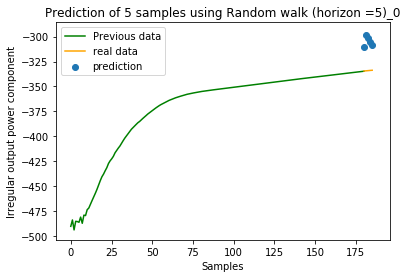

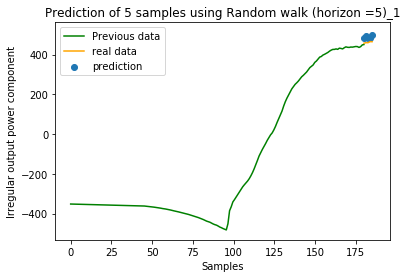

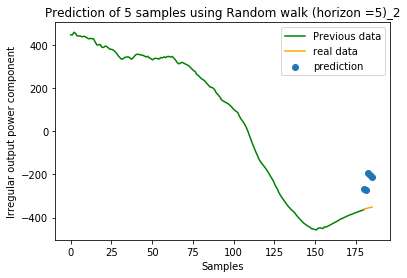

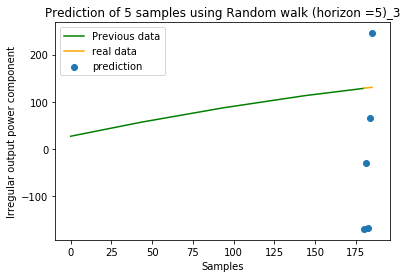

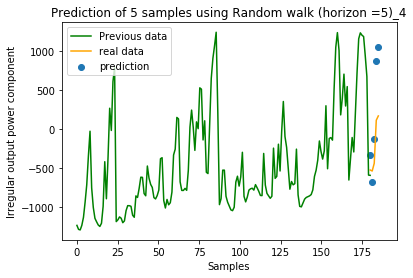

...

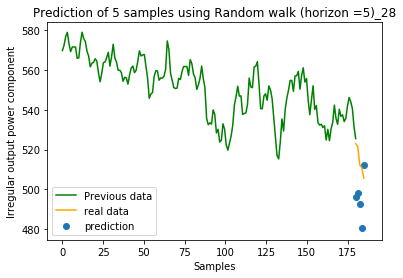

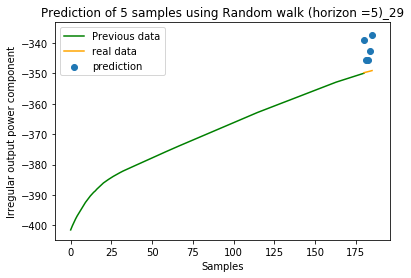

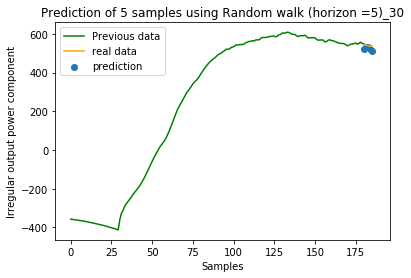

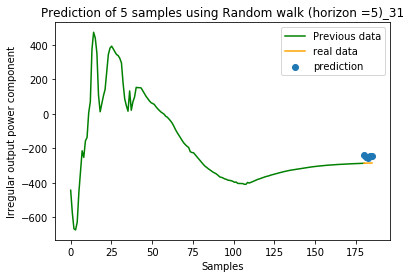

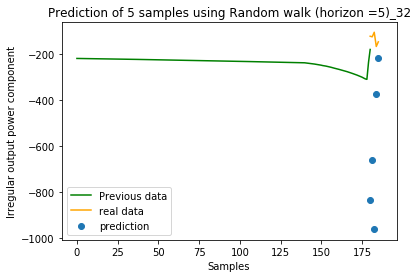

In [ ]:
results = []
horizon = 5
allErrors = []

# Backtest on 10 divisions of the data
# for i, (X_train, Y_train, X_test, Y_test) in enumerate(split_data(features, labels, 3)):
for i, (X_train, X_test) in enumerate(split(data, splits = 1000, offset = len(data) // 2)):
    print("\r\nSplit ", i)
    print("training size:", len(X_train))
    
    # Move to numpy arrays
    X_train = X_train.values
    X_test = X_test.values
    
    Y_train = X_train
    Y_test  = X_test
    
    # Train the model
    model.fit(X_train, Y_train)
    
    # make a prediction
    print(type(X_test[:]))
    Y_pred = model.predict(X_test[:])
    print(Y_pred)
    
    # Save the data 
    results.append((Y_pred, X_train, Y_train, X_test, Y_test))
    
    # Save the error
    errors = calc_error(Y_pred, Y_test[:horizon], Y_train, str(model) + '_' + str(i))
    
    # Report the error
    report_error(errors)
    
    # Generate a graph
    plot_prediction(Y_pred, Y_test[:horizon], Y_train, str(model) + '_' + str(i), '')
    
    # Save the information
    allErrors.append(errors)

In [78]:
plot_all_errors(allErrors)

actual [1 3 3]
Prediction [3.5 3.5 3.5]
actual [1 3 3]
Prediction [1 2 3]
actual [1 3 3 4 5 6]
Prediction [1.5 1.5 1.5 1.5 1.5 1.5]
actual [1 3 3 4 5 6]
Prediction [1 2 4 5 6 7]

Errors:
sMAPE           13.33333
MAE             0.33333
MAPE            11.11111
RMSE            0.57735
MASE            0.28571
MASE1           0.09524
MASE2           0.33333


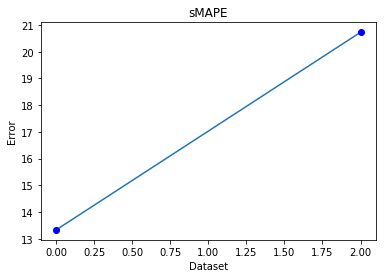

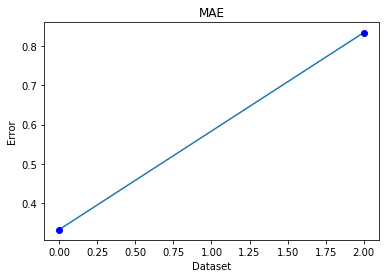

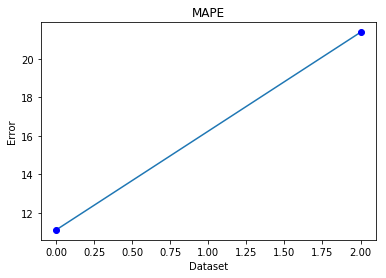

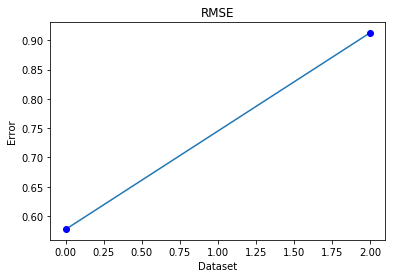

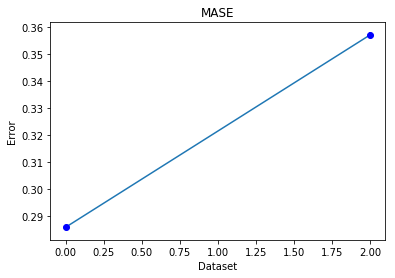

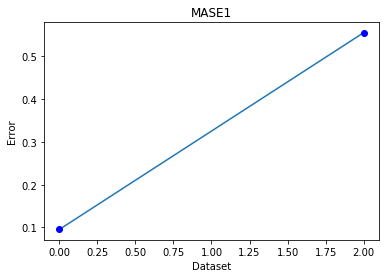

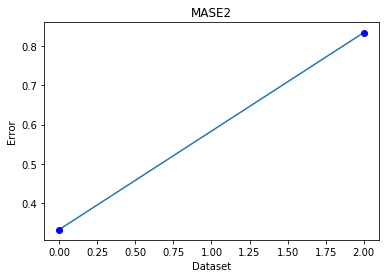

In [8]:
errors_1 = calc_error(np.array([1,2,3]), np.array([1,3,3]), np.array([1,2,3,4,5,6]), 'test')
errors_2 = calc_error(np.array([1,2,4,5,6,7]), np.array([1,3,3,4,5,6]), np.array([1,2]), 'test')

report_error(errors_1)
plot_all_errors([errors_1, errors_2])

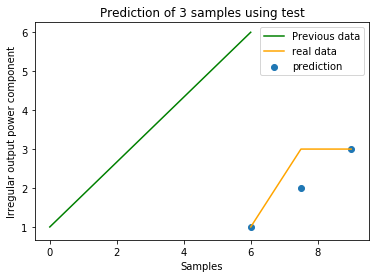

In [18]:
plot_prediction(np.array([1,2,3]), np.array([1,3,3]), np.array([1,2,3,4,5,6]), 'test')

In [ ]:
# Create the features and labels
horizon = 5
features, labels = create_features(data.values, horizon)

0.0 / 1294.559
1.0 / 1294.559
2.0 / 1294.559
3.0 / 1294.559
4.0 / 1294.559
5.0 / 1294.559
6.0 / 1294.559
7.0 / 1294.559
8.0 / 1294.559
9.0 / 1294.559
10.0 / 1294.559
11.0 / 1294.559
12.0 / 1294.559
13.0 / 1294.559
14.0 / 1294.559
15.0 / 1294.559
16.0 / 1294.559
17.0 / 1294.559
18.0 / 1294.559
19.0 / 1294.559
20.0 / 1294.559
21.0 / 1294.559
22.0 / 1294.559
23.0 / 1294.559
24.0 / 1294.559
25.0 / 1294.559
26.0 / 1294.559
27.0 / 1294.559
28.0 / 1294.559
29.0 / 1294.559
30.0 / 1294.559
31.0 / 1294.559
32.0 / 1294.559
33.0 / 1294.559
34.0 / 1294.559
35.0 / 1294.559
36.0 / 1294.559
37.0 / 1294.559
38.0 / 1294.559
39.0 / 1294.559
40.0 / 1294.559
41.0 / 1294.559
42.0 / 1294.559
43.0 / 1294.559
44.0 / 1294.559
45.0 / 1294.559
46.0 / 1294.559
47.0 / 1294.559
48.0 / 1294.559
49.0 / 1294.559
50.0 / 1294.559
51.0 / 1294.559
52.0 / 1294.559
53.0 / 1294.559
54.0 / 1294.559
55.0 / 1294.559
56.0 / 1294.559
57.0 / 1294.559
58.0 / 1294.559
59.0 / 1294.559
60.0 / 1294.559
61.0 / 1294.559
62.0 / 1294.559
63

In [18]:
# define the model
model = MultiForecaster(XGBRegressor(n_estimators=3000, learning_rate=0.1, colsample_bytree=0.3), 5)

In [5]:
print(len(features), len(labels))

2795 2795


In [21]:
len(data)

46000

In [59]:
results = []
horizon = 60

# Backtest on 10 divisions of the data
for i, (X_train, Y_train, X_test, Y_test) in enumerate(split_data(features, labels, 3)):
    print("Split ", i)
    print("training size:", len(X_train))
    
    # Testing
    X_test = X_test[:60]
    Y_test = Y_test[:60]
    
    # Train the model
    model.fit(X_train, Y_train)
    
    # make a prediction
    Y_pred = model.predict(X_test[:1])
    
    # Save the data 
    results.append((Y_pred, X_train, Y_train, X_test, Y_test))
    
    continue

[698, 1397, 2096]
Split  0
training size: 698
(1, 83) [-4.1452103]
(1, 83) [-228.14302]
(1, 83) [-23.179815]
(1, 83) [-134.85236]
(1, 83) [142.27374]
Split  1
training size: 1397
(1, 83) [116.4649]
(1, 83) [116.87085]
(1, 83) [117.14961]
(1, 83) [115.76446]
(1, 83) [115.87833]
Split  2
training size: 2096
(1, 83) [176.84685]
(1, 83) [131.34224]
(1, 83) [136.27242]
(1, 83) [135.30907]
(1, 83) [137.34343]


In [62]:
from sklearn.metrics import mean_squared_error

In [ ]:
# Produce error reports
#     MASE = calculate_MASE(X_train, Y_pred, Y_test[:5])
MASE = 0
sMAPE = calcaulte_sMAPE(Y_pred, Y_test[:1])
MSE = calc

print("MASE:", MASE, ", sMAPE:", sMAPE)


ValueError: x and y must have same first dimension, but have shapes (61,) and (6,)

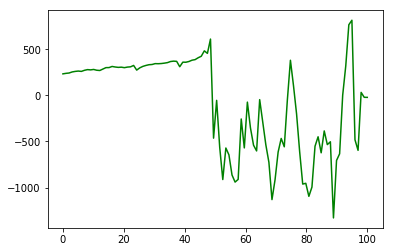

In [79]:
prevPoints = 100
horizon = 60

for (Y_pred, X_train, Y_train, X_test, Y_test) in results:
    temp = np.append(np.array(Y_train.values[-1][0]), Y_test.values[0])
    
    # Create plots
    plt.figure()
    
    # Plot the previous data
    plt.plot(np.linspace(0, prevPoints, len(Y_train[-prevPoints:])), [y[0] for y in Y_train.values[-prevPoints:]], c = 'g')

    # Plot the real data
    plt.plot(np.linspace(prevPoints, prevPoints + horizon + 1, horizon + 1), temp, c = 'orange')
    
    # Plot the predictions
    plt.scatter(np.linspace(prevPoints, prevPoints + len(Y_pred[0]), len(Y_pred[0])), Y_pred[0])

    plt.title('Prediction of 1000 samples using 1000 predictors')
    plt.xlabel('Samples')
    plt.ylabel('Output power')
    plt.legend(['Previous data', 'real data', 'prediction'])
    
    # Report the error
    MASE  = 0
    sMAPE = calcaulte_sMAPE(Y_pred, Y_test[:1])
    MSE   = mean_squared_error(Y_pred[0][:1], Y_test.values[0][:1])

    print(Y_pred[0][0], Y_test.values[0][0], "MASE:", MASE, ", sMAPE:", sMAPE[0], "MSE:", MSE)

print()

In [76]:
Y_test.values[0][0]

1.1946

In [10]:
Y_train.head()

,1,2,3,4,5
0,120.20,120.26,120.32,120.38,120.44
1,120.26,120.32,120.38,120.44,120.50
2,120.32,120.38,120.44,120.50,120.56
3,120.38,120.44,120.50,120.56,120.62
4,120.44,120.50,120.56,120.62,120.68


In [34]:
np.append([1,2,3], 1)

array([1, 2, 3, 1])